In [1]:
import xarray as xr
import numpy as np
import numpy as np
import xarray as xr
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd

In [ ]:
ds_MRI=xr.open_dataset("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/MRI-ESM2-0_1x1grid/historical/aggregated_solar_power_1980.nc")
ds_ACCESS="/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/ACCESS-CM2_1x1grid/historical/aggregated_solar_power_1980.nc"

In [10]:
# Define the directory and models
models = ["ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2","HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"]  # Replace with actual model names
diri = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/"

# Initialize vmin and vmax
vmin_nt = float("inf")
vmax_nt = float("-inf")

# Dictionary to store relative differences for each model
relative_differences_nt = {}
all_relative_differences_nt = []

# Loop through each model
for model in models:
    # Define paths for BOC and EOC
    path_BOC_nt = os.path.join(diri, model+"_1x1grid/historical/")
    print(path_BOC_nt)
    path_EOC_nt = os.path.join(diri, model+"_1x1grid/ssp585/")
    
    # Load BOC files
    files_BOC_nt = [f"{path_BOC_nt}aggregated_solar_power_{year}.nc" for year in range(1980, 2015)]
    datasets_BOC_nt = []
    for year, file in zip(range(1980, 2015), files_BOC_nt):
        ds_BOC_nt = xr.open_dataset(file, engine="netcdf4")
        ds_BOC_nt = ds_BOC_nt.expand_dims(time=[year])
        datasets_BOC_nt.append(ds_BOC_nt)
    combined_ds_BOC_nt = xr.concat(datasets_BOC_nt, dim="time")
    mean_power_BOC_nt = combined_ds_BOC_nt["specific generation"].mean(dim="time")
    
    # Load EOC files
    files_EOC_nt = [f"{path_EOC_nt}aggregated_solar_power_{year}.nc" for year in range(2065, 2100)]
    datasets_EOC_nt = []
    for year, file in zip(range(2065, 2100), files_EOC_nt):
        ds_EOC_nt = xr.open_dataset(file)
        ds_EOC_nt = ds_EOC_nt.expand_dims(time=[year])
        datasets_EOC_nt.append(ds_EOC_nt)
    combined_ds_EOC_nt = xr.concat(datasets_EOC_nt, dim="time")
    mean_power_EOC_nt = combined_ds_EOC_nt["specific generation"].mean(dim="time")
    
    # Calculate relative difference
    relative_difference_nt = (mean_power_EOC_nt - mean_power_BOC_nt) / mean_power_BOC_nt * 100
    relative_difference_nt = relative_difference_nt.sel(x=slice(-12, 35), y=slice(33, 65))
    relative_differences_nt[model] = relative_difference_nt
    # Collect all relative differences for global quantile calculation
    all_relative_differences_nt.append(relative_difference_nt)
    
    # Update vmin and vmax
    vmin_nt = min(vmin_nt, relative_difference_nt.min().values)
    vmax_nt = max(vmax_nt, relative_difference_nt.max().values)

# Combine all relative differences into a single array for quantile calculation
all_relative_differences_combined_nt = xr.concat(all_relative_differences_nt, dim="model")
q05_nt, q995_nt = np.nanpercentile(all_relative_differences_combined_nt, [0.5, 99.5])

for model, relative_difference in zip(models, all_relative_differences_nt):
    relative_differences_nt[model] = relative_difference
    
    # Update vmin and vmax
    vmin_nt = min(vmin_nt, relative_difference_nt.min().values)
    vmax_nt = max(vmax_nt, relative_difference_nt.max().values)
    vmin_nt,vmax_nt = q05_nt, q995_nt
    



/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/ACCESS-CM2_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/CanESM5_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/CMCC-CM2-SR5_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/CMCC-ESM2_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/HadGEM3-GC31-LL_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/HadGEM3-GC31-MM_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power_notemp/MRI-ESM2-0_1x1grid/historical/


In [2]:
# Define the directory and models
models = ["ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2","HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"]  # Replace with actual model names
diri = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/"

# Initialize vmin and vmax
vmin = float("inf")
vmax = float("-inf")

# Dictionary to store relative differences for each model
relative_differences = {}
all_relative_differences = []

# Loop through each model
for model in models:
    # Define paths for BOC and EOC
    path_BOC = os.path.join(diri, model+"_1x1grid/historical/")
    print(path_BOC)
    path_EOC = os.path.join(diri, model+"_1x1grid/ssp585/")
    
    # Load BOC files
    files_BOC = [f"{path_BOC}aggregated_solar_power_{year}.nc" for year in range(1980, 2015)]
    datasets_BOC = []
    for year, file in zip(range(1980, 2015), files_BOC):
        ds_BOC = xr.open_dataset(file, engine="netcdf4")
        ds_BOC = ds_BOC.expand_dims(time=[year])
        datasets_BOC.append(ds_BOC)
    combined_ds_BOC = xr.concat(datasets_BOC, dim="time")
    mean_power_BOC = combined_ds_BOC["specific generation"].median(dim="time")
    
    # Load EOC files
    files_EOC = [f"{path_EOC}aggregated_solar_power_{year}.nc" for year in range(2065, 2100)]
    datasets_EOC = []
    for year, file in zip(range(2065, 2100), files_EOC):
        ds_EOC = xr.open_dataset(file)
        ds_EOC = ds_EOC.expand_dims(time=[year])
        datasets_EOC.append(ds_EOC)
    combined_ds_EOC = xr.concat(datasets_EOC, dim="time")
    mean_power_EOC = combined_ds_EOC["specific generation"].median(dim="time")
    
    # Calculate relative difference
    relative_difference = (mean_power_EOC - mean_power_BOC) / mean_power_BOC * 100
    relative_difference = relative_difference.sel(x=slice(-12, 35), y=slice(33, 65))
    relative_differences[model] = relative_difference
    # Collect all relative differences for global quantile calculation
    all_relative_differences.append(relative_difference)
    
    # Update vmin and vmax
    vmin = min(vmin, relative_difference.min().values)
    vmax = max(vmax, relative_difference.max().values)

# Combine all relative differences into a single array for quantile calculation
all_relative_differences_combined = xr.concat(all_relative_differences, dim="model")
q05, q995 = np.nanpercentile(all_relative_differences_combined, [1, 99.5])

for model, relative_difference in zip(models, all_relative_differences):
    relative_difference = relative_difference
    relative_differences[model] = relative_difference

    


/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/ACCESS-CM2_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/CanESM5_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/CMCC-CM2-SR5_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/CMCC-ESM2_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/HadGEM3-GC31-LL_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/HadGEM3-GC31-MM_1x1grid/historical/
/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/MRI-ESM2-0_1x1grid/historical/


In [4]:
vmin_t=min(vmin, vmin_nt)
vmax_t=max(vmax, vmax_nt)

In [5]:
def map_plots(variable,
              cmap='viridis',
              setnan=True,
              vmin=None,
              vmax=None,
              title=None,
              label=''):
    """
    Plot a 2D DataArray (x,y) on a PlateCarree map, masking zeros if requested.
    If title is falsy, no title is drawn and the axes are expanded
    symmetrically so the colorbar sits neatly inside.
    """
    # mask zeros→NaN and subset
    if setnan:
        variable = xr.where(variable != 0, variable, np.nan)
    variable = variable.sel(x=slice(-10.5, 34), y=slice(34.5, 62.5))

    lon = variable['x']
    lat = variable['y']

    fig, ax = plt.subplots(
        figsize=(12, 8),
        subplot_kw={'projection': ccrs.PlateCarree()}
    )
    ax.set_extent([-10.5, 34, 34.5, 62.5], crs=ccrs.PlateCarree())

    mesh = ax.pcolormesh(
        lon, lat, variable,
        transform=ccrs.PlateCarree(),
        cmap=cmap, shading='auto',
        vmin=vmin, vmax=vmax
    )

    # map features
    ax.coastlines(resolution='10m', linewidth=1)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.LAND, facecolor='lightgray')
    ax.add_feature(cfeature.OCEAN, facecolor='white')

    # only draw a title if non-empty/non-None
    if title:
        ax.set_title(title, fontsize=16)

    # colorbar (shrink lowers its height)
    cbar = fig.colorbar(mesh, ax=ax,
                        orientation='vertical',
                        pad=0.02,
                        shrink=0.8)
    cbar.set_label(label, rotation=90, labelpad=15, fontsize=16)
    cbar.ax.tick_params(labelsize=12)

    # if no title, expand axes symmetrically by δ
    if not title:
        left, bottom, width, height = ax.get_position().bounds
        δ = 0.05
        new_bottom = max(0, bottom - δ/2)
        ax.set_position([left, new_bottom, width, height + δ])

    plt.show()

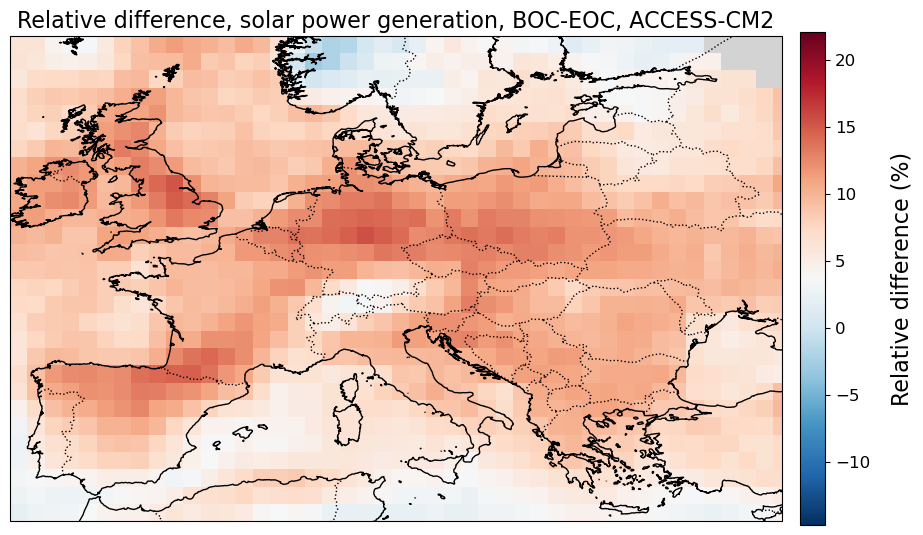

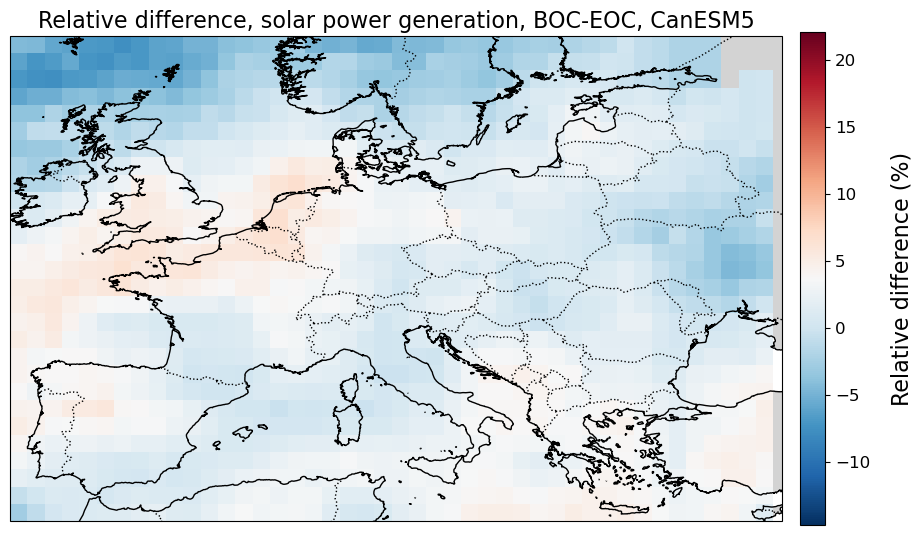

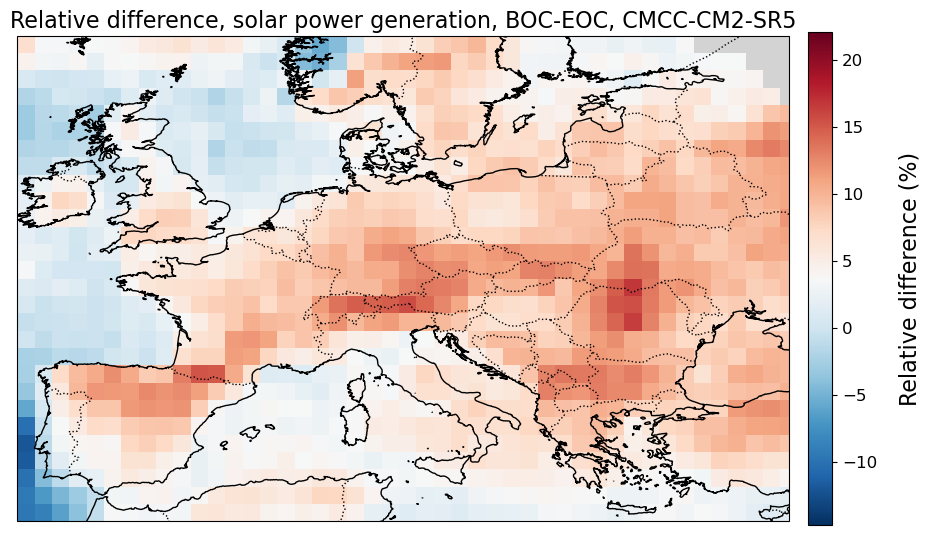

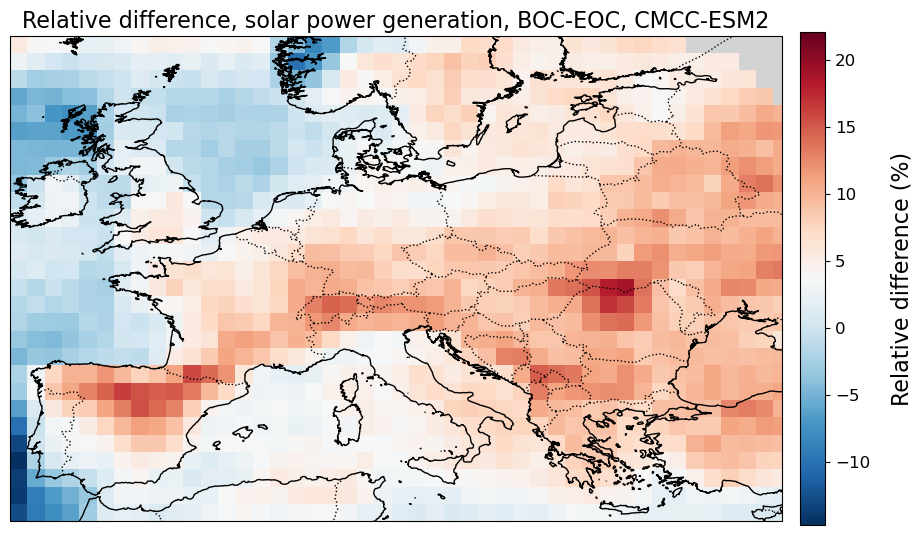

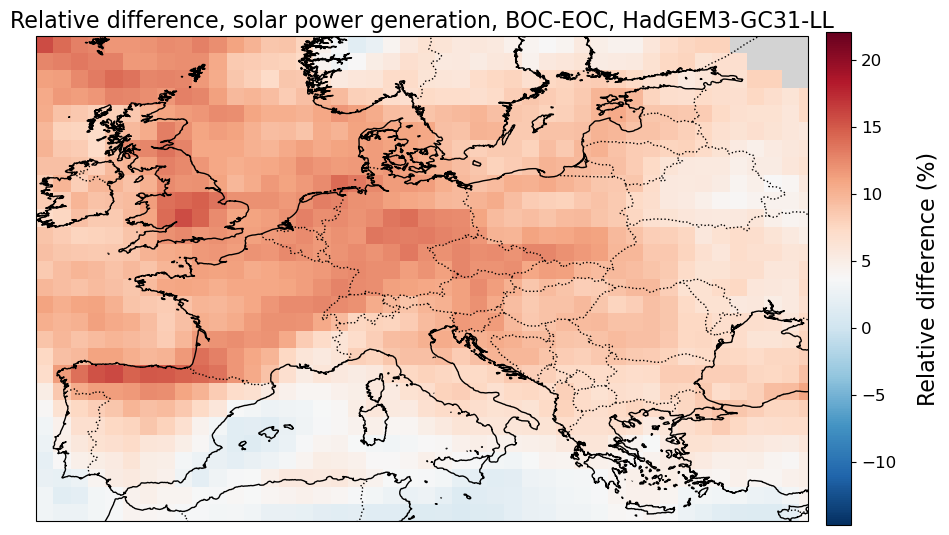

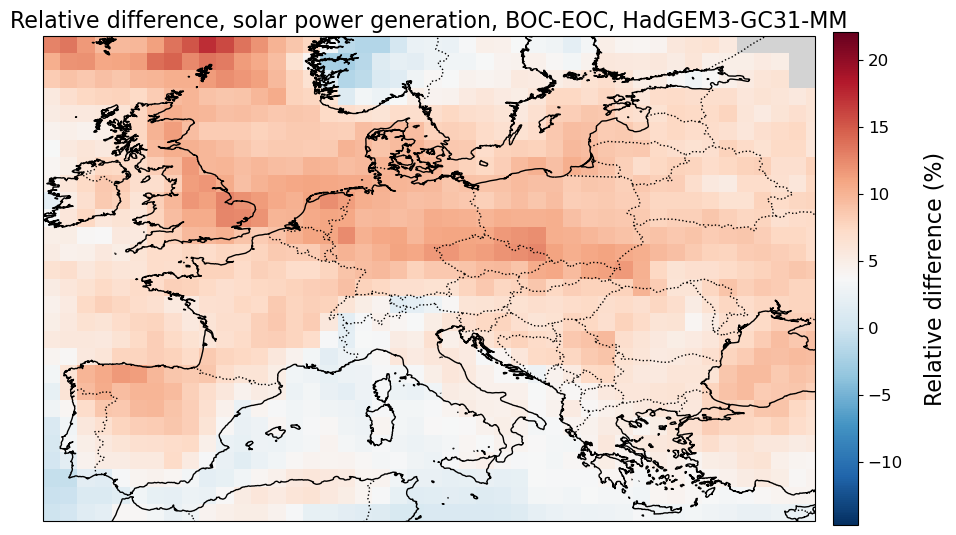

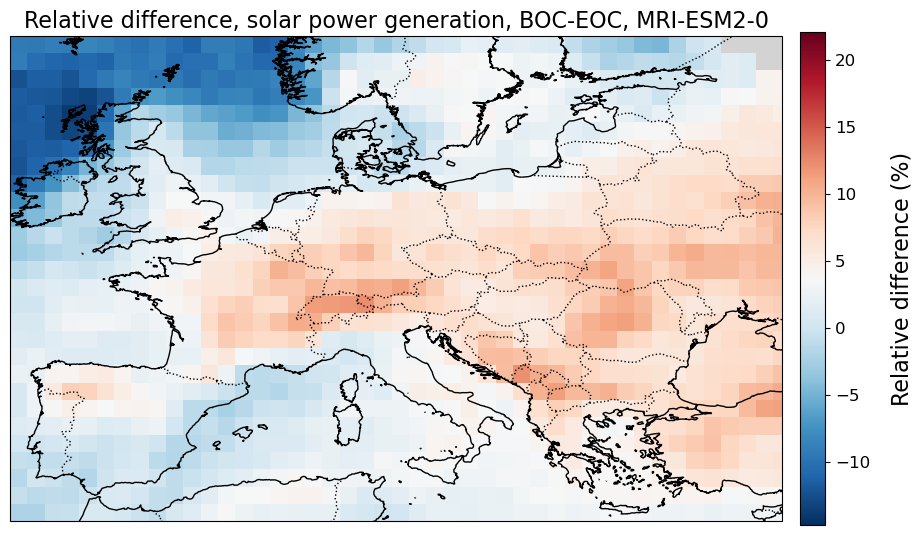

In [93]:
# Plot relative differences for each model
vmin = min(vmin, relative_difference.min().values)
vmax = max(vmax, relative_difference.max().values)
for model, relative_difference in relative_differences.items():
    
    map_plots(relative_difference,cmap='RdBu_r', setnan=False, vmin=vmin, vmax=vmax, title=f"Relative difference, solar power generation, BOC-EOC, {model}", label="Relative difference (%)")
    

In [3]:
models = ["ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2","HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"]

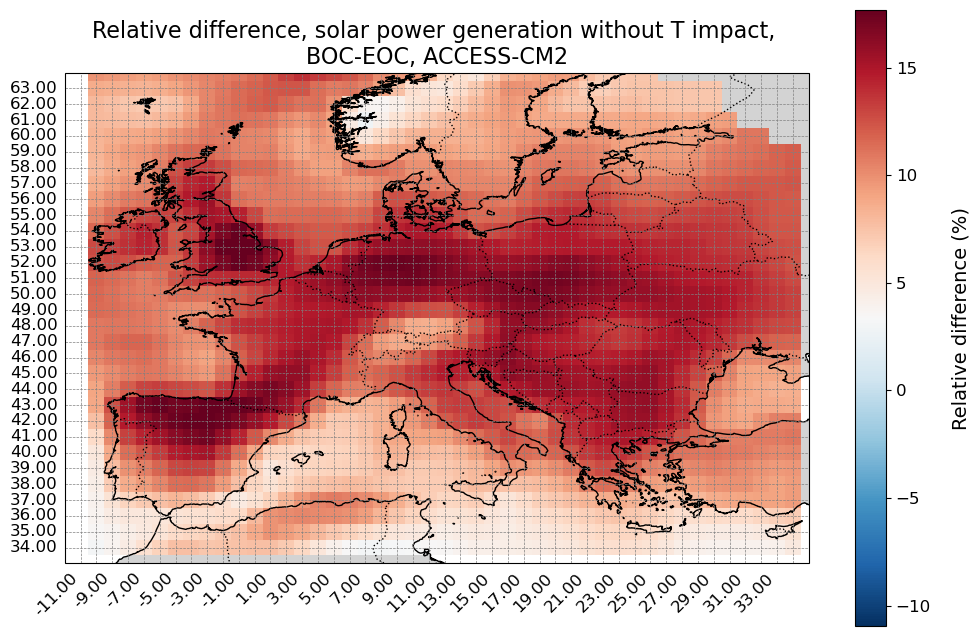

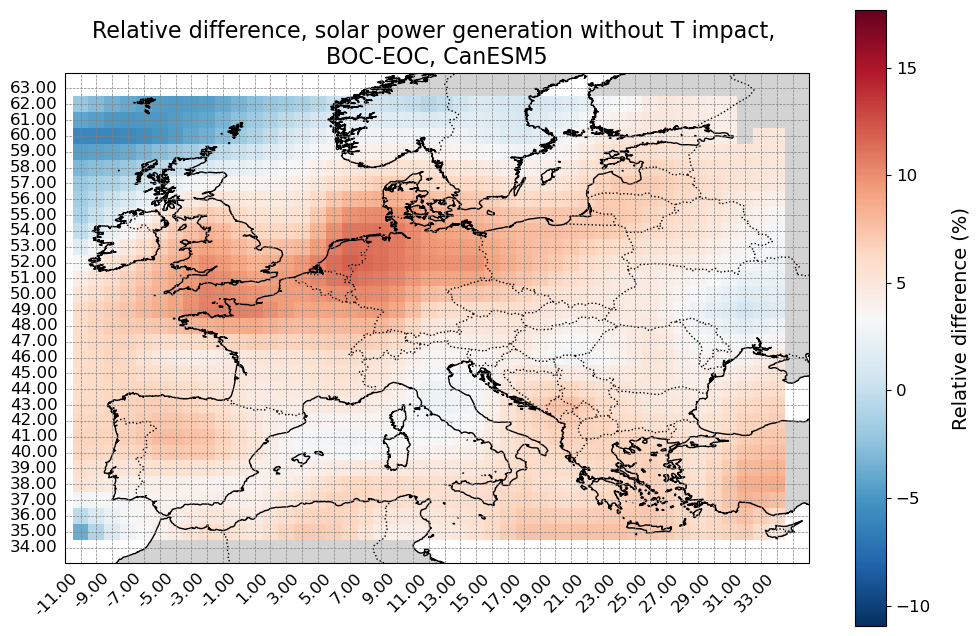

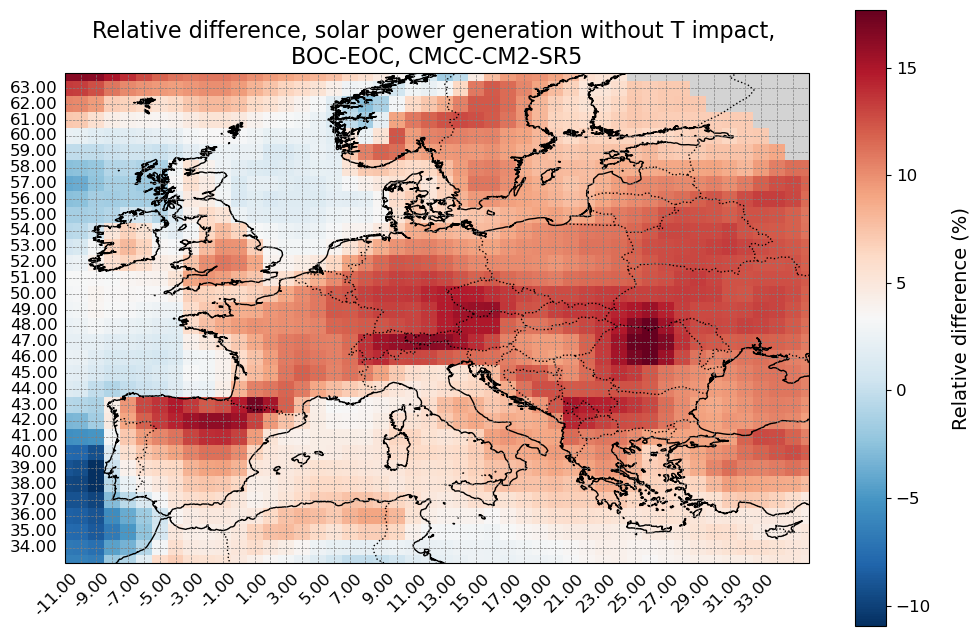

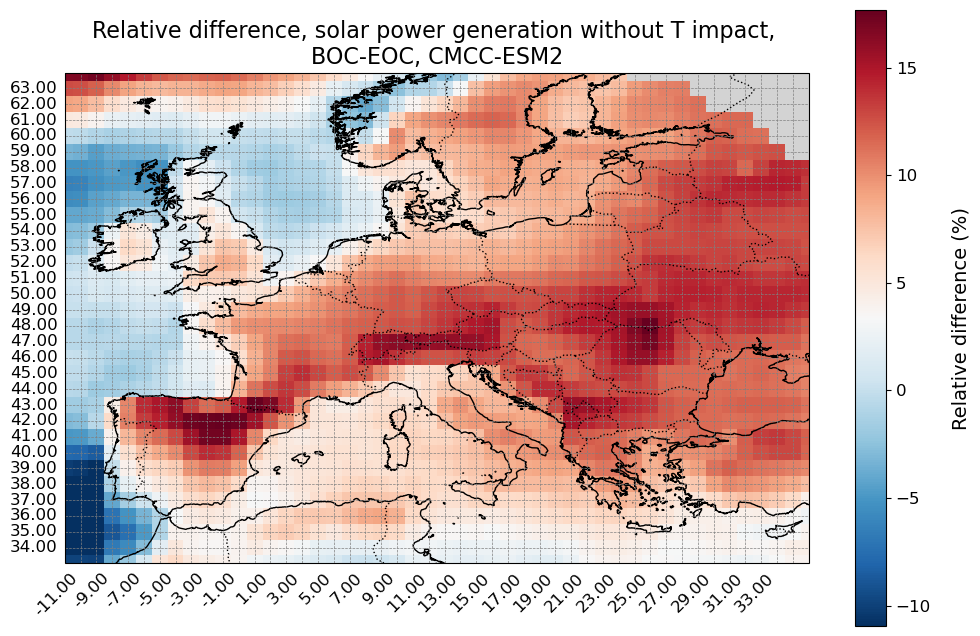

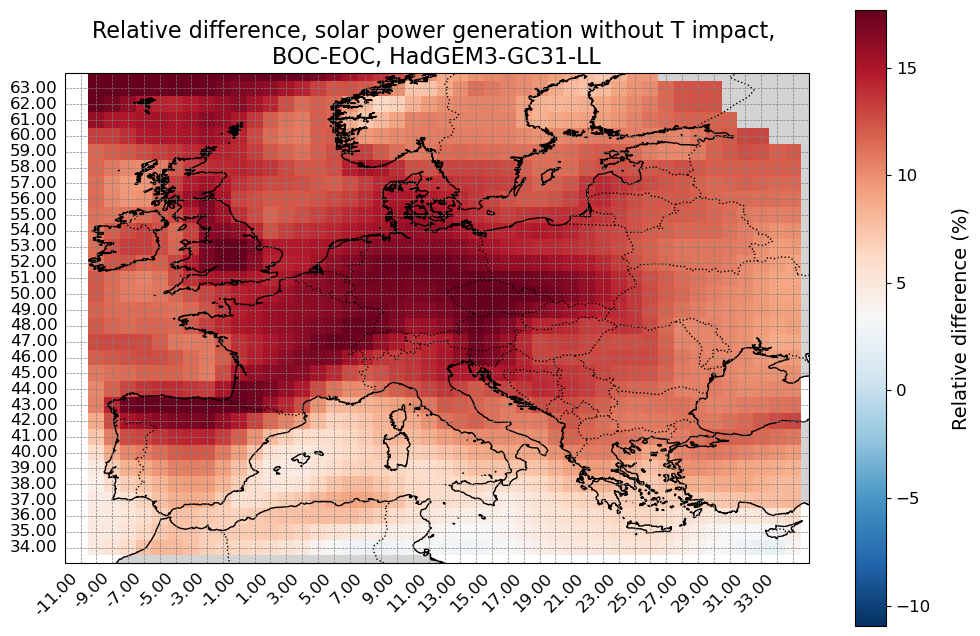

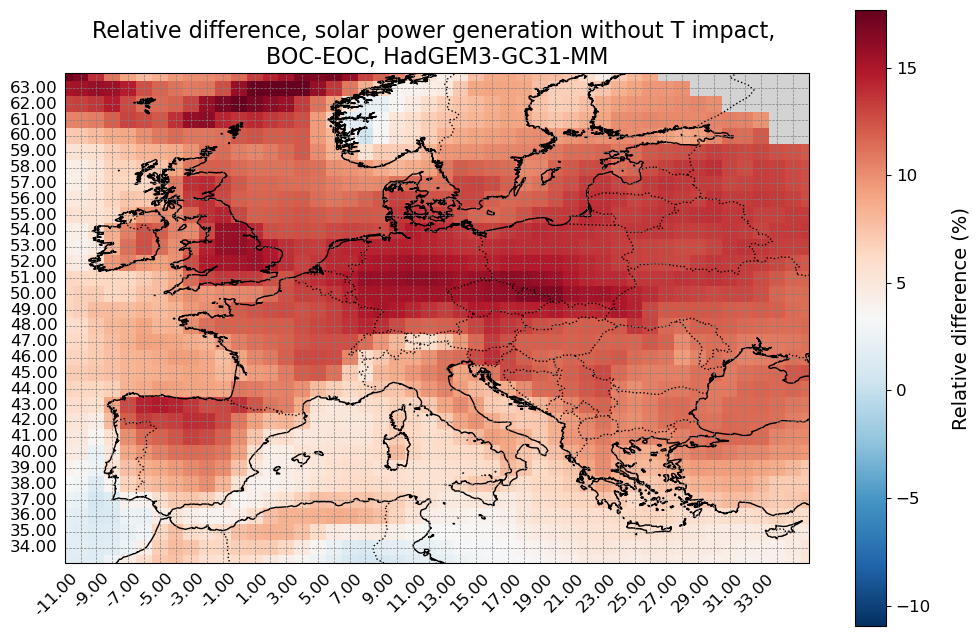

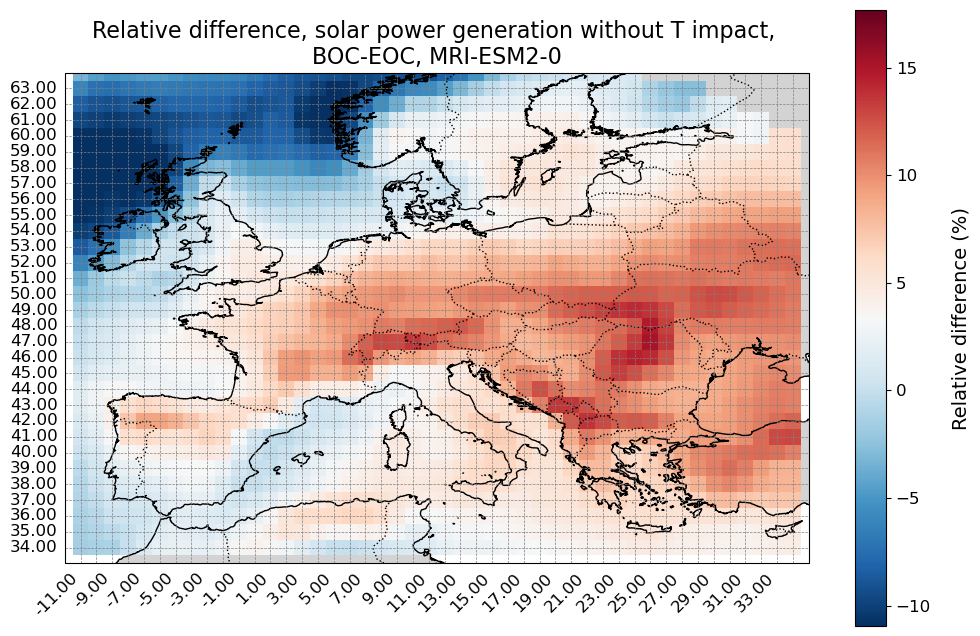

In [18]:
# Plot relative differences for each model
for model, relative_difference in relative_differences_nt.items():
    from plots import map_plots
    
    map_plots(relative_difference,cmap='RdBu_r', setnan=False, vmin=vmin_t, vmax=vmax_t, title=f"Relative difference, solar power generation without T impact, \nBOC-EOC, {model}", label="Relative difference (%)")
    

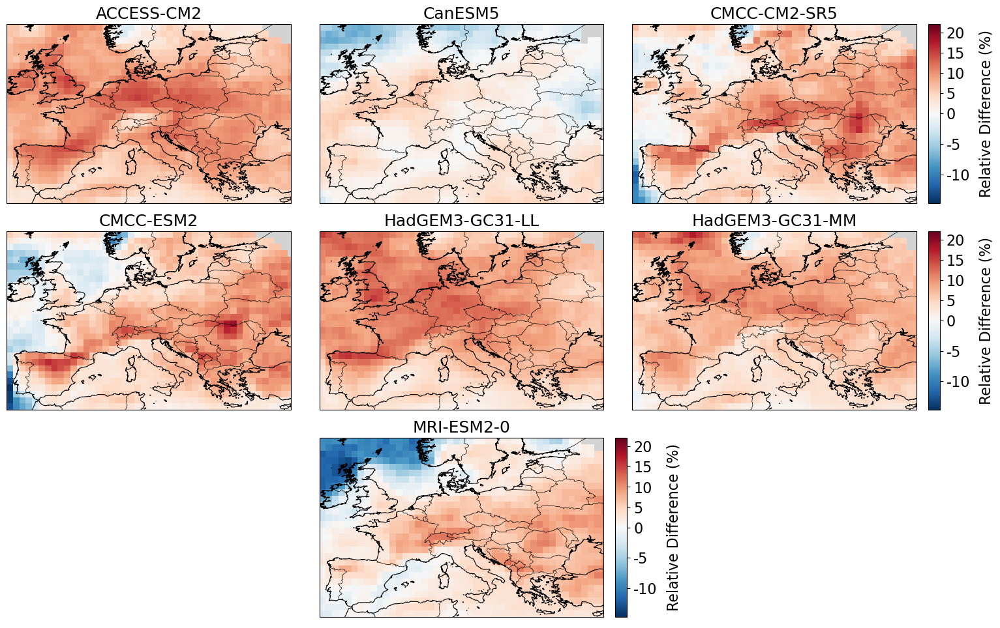

In [10]:
import matplotlib.pyplot as plt
import xarray as xr
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import TwoSlopeNorm

def panel_map_plots_3x3(variables, model_names,
                        cmap='RdBu_r', setnan=True,
                        label='Relative Difference (%)'):
    """
    3x3 layout for 7 panels:
      • 7 maps distributed across 3 rows and 3 columns
      • Last two slots remain empty
      • Shared colorbars for each row
      • Bottom row centered horizontally
    """
    assert len(variables) == 7 and len(model_names) == 7

    # Compute vmin/vmax from 0.5/99.5 percentiles
    all_vals = np.concatenate([var.where(var != 0).values.ravel() for var in variables])
    all_vals = all_vals[~np.isnan(all_vals)]
    vmin, vmax = np.nanpercentile(all_vals, [0, 100])
    norm = TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

    # Create figure and axes
    fig = plt.figure(figsize=(18, 12))  # Adjusted for 3x3 layout
    gs = fig.add_gridspec(3, 3, wspace=0.1, hspace=0.1)  # Reduced spacing between plots

    axes = []
    # Top two rows: regular layout
    for i in range(6):  # Create axes for the first 6 plots
        row, col = divmod(i, 3)
        ax = fig.add_subplot(gs[row, col], projection=ccrs.PlateCarree())
        axes.append(ax)

    # Bottom row: center the subplots horizontally
    row, col = 2, 1  # Center the single plot in the middle column
    ax = fig.add_subplot(gs[row, col], projection=ccrs.PlateCarree())
    axes.append(ax)

    # Add empty axes for the last two slots
    for i in [0, 2]:  # Left and right columns of the bottom row
        ax = fig.add_subplot(gs[2, i])
        ax.axis('off')  # Turn off the axis for empty slots

    # Europe extent
    extent = (-10.5, 34, 34.5, 62.5)

    # Plot each variable
    meshes = []
    for da, name, ax in zip(variables, model_names, axes):
        # Mask zeros
        data = da.where(da != 0) if setnan else da
        data = data.sel(x=slice(extent[0], extent[1]),
                        y=slice(extent[2], extent[3]))

        # pcolormesh
        mesh = ax.pcolormesh(data['x'], data['y'], data,
                             transform=ccrs.PlateCarree(),
                             cmap=cmap, norm=norm, shading='auto')
        meshes.append(mesh)

        # Map decorations
        ax.coastlines(resolution='10m', linewidth=0.8)
        ax.add_feature(cfeature.BORDERS, linewidth=0.5)
        ax.add_feature(cfeature.LAND, facecolor='lightgray')
        ax.add_feature(cfeature.OCEAN, facecolor='white')

        ax.set_extent(extent, ccrs.PlateCarree())
        ax.set_title(name, fontsize=18)
    # Center the bottom row plot
    from matplotlib.ticker import MaxNLocator
# … inside panel_map_plots_3x3 …

    # Compute raw min/max
    all_vals = np.concatenate([var.where(var != 0).values.ravel() for var in variables])
    all_vals = all_vals[~np.isnan(all_vals)]
    raw_min, raw_max = np.nanpercentile(all_vals, [0, 100])

    # … replace your norm‐definition with a fixed ±20 window …
    # raw_min, raw_max = np.nanpercentile(…)  # you can drop these now
    abs_max = 20.0
    norm = TwoSlopeNorm(vmin=-abs_max, vcenter=0, vmax=abs_max)

    # … later, in add_cbar …
    def add_cbar(ax_ref, mesh):
        pos = ax_ref.get_position()
        cax = fig.add_axes([pos.x1 + 0.01, pos.y0, 0.01, pos.height])

        # fixed ticks from -20 to +20 every 5
        ticks = np.arange(-abs_max, abs_max+1e-6, 5.0)

        cb = fig.colorbar(mesh, cax=cax, orientation='vertical', ticks=ticks)
        cb.ax.set_yticklabels([f"{t:.0f}" for t in ticks])
        cb.set_label(label, rotation=90, labelpad=10, fontsize=16)
        cb.ax.tick_params(labelsize=16)

    # Add colorbars for rows
    add_cbar(axes[2], meshes[2])  # First row
    add_cbar(axes[5], meshes[5])  # Second row
    add_cbar(axes[6], meshes[6])  # Third row (centered plot)
    plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/yearly_rel_dif_per_model.pdf", bbox_inches='tight', dpi=300)
    plt.show()

vars_  = list(relative_differences.values())
# Example usage:
panel_map_plots_3x3(vars_, models,
                    cmap='RdBu_r',
                    label='Relative Difference (%)')


In [13]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import TwoSlopeNorm
import cartopy.crs as ccrs
import cartopy.feature as cfeature

def panel_map_plots_3x3(variables, model_names,
                        cmap='RdBu_r', setnan=True,
                        label='Relative Difference (%)'):
    assert len(variables) == 7 and len(model_names) == 7

    abs_max = 20.0  # Fixed symmetrical scale
    norm = TwoSlopeNorm(vmin=-abs_max, vcenter=0, vmax=abs_max)
    ticks = np.arange(-abs_max, abs_max + 1e-6, 5)

    fig = plt.figure(figsize=(18, 12))
    gs = fig.add_gridspec(3, 3, wspace=0.1, hspace=0.1)

    axes = []
    for i in range(6):  # Top two rows
        row, col = divmod(i, 3)
        ax = fig.add_subplot(gs[row, col], projection=ccrs.PlateCarree())
        axes.append(ax)

    # Bottom row, centered
    ax = fig.add_subplot(gs[2, 1], projection=ccrs.PlateCarree())
    axes.append(ax)

    # Fill remaining (empty) slots
    for i in [0, 2]:
        ax = fig.add_subplot(gs[2, i])
        ax.axis('off')

    extent = (-10.5, 34, 34.5, 62.5)
    meshes = []

    for da, name, ax in zip(variables, model_names, axes):
        data = da.where(da != 0) if setnan else da
        data = data.sel(x=slice(extent[0], extent[1]),
                        y=slice(extent[2], extent[3]))

        mesh = ax.pcolormesh(data['x'], data['y'], data,
                             transform=ccrs.PlateCarree(),
                             cmap=cmap, norm=norm, shading='auto')
        meshes.append(mesh)

        ax.coastlines(resolution='10m', linewidth=0.8)
        ax.add_feature(cfeature.BORDERS, linewidth=0.5)
        ax.add_feature(cfeature.LAND, facecolor='lightgray')
        ax.add_feature(cfeature.OCEAN, facecolor='white')
        ax.set_extent(extent, ccrs.PlateCarree())
        ax.set_title(name, fontsize=18)

    def add_cbar(ax_ref, mesh):
        pos = ax_ref.get_position()
        cax = fig.add_axes([pos.x1 + 0.01, pos.y0, 0.01, pos.height])
        cb = fig.colorbar(mesh, cax=cax, orientation='vertical', ticks=ticks)
        cb.ax.set_yticklabels([f"{t:.0f}" for t in ticks])
        cb.set_label(label, rotation=90, labelpad=10, fontsize=16)
        cb.ax.tick_params(labelsize=16)

    # Add colorbars for rows 1, 2, 3
    add_cbar(axes[2], meshes[2])
    add_cbar(axes[5], meshes[5])
    add_cbar(axes[6], meshes[6])

    plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/yearly_rel_dif_per_model_1.pdf", bbox_inches='tight', dpi=300)
    plt.show()


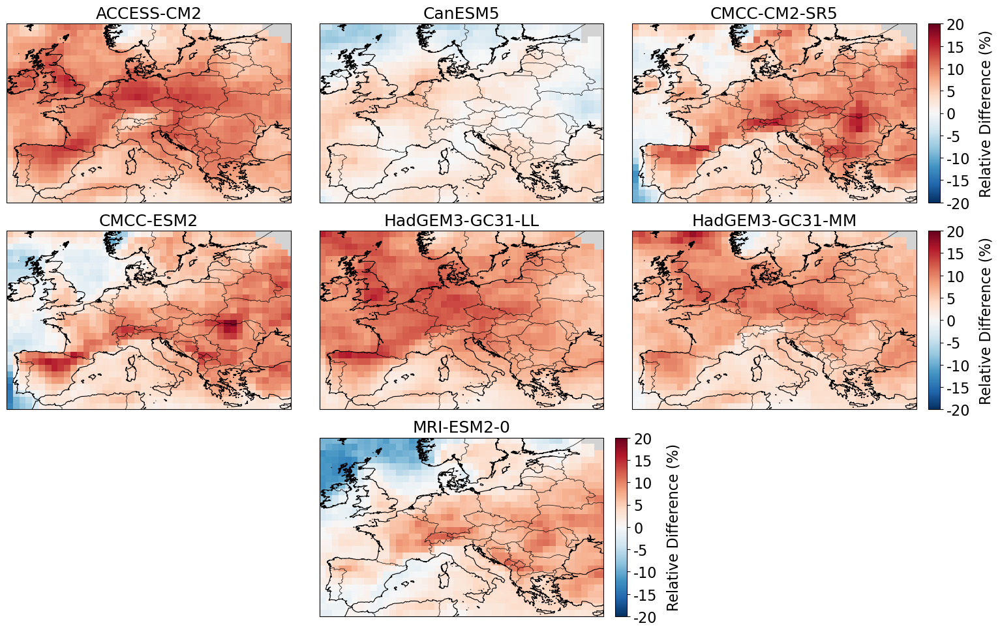

In [14]:
vars_ = list(relative_differences.values())
panel_map_plots_3x3(vars_, models,
                    cmap='RdBu_r',
                    label='Relative Difference (%)')


In [22]:
from matplotlib.colors import TwoSlopeNorm

def map_plots(variable,
              cmap='RdBu_r',  # Updated to a diverging colormap
              setnan=True,
              vmin=None,
              vmax=None,
              title=None,
              label=''):
    """
    Plot a 2D DataArray (x,y) on a PlateCarree map, masking zeros if requested.
    If title is falsy, no title is drawn and the axes are expanded
    symmetrically so the colorbar sits neatly inside.
    """
    # Mask zeros→NaN and subset
    if setnan:
        variable = xr.where(variable != 0, variable, np.nan)
    variable = variable.sel(x=slice(-10.5, 34), y=slice(34.5, 62.5))

    lon = variable['x']
    lat = variable['y']

    # Compute vmin and vmax if not provided
    if vmin is None or vmax is None:
        vmin = variable.min().values
        vmax = variable.max().values

    # Use TwoSlopeNorm to center the colormap at 0
    norm = TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

    fig, ax = plt.subplots(
        figsize=(12, 8),
        subplot_kw={'projection': ccrs.PlateCarree()}
    )
    ax.set_extent([-10.5, 34, 34.5, 62.5], crs=ccrs.PlateCarree())

    mesh = ax.pcolormesh(
        lon, lat, variable,
        transform=ccrs.PlateCarree(),
        cmap=cmap, shading='auto', norm=norm  # Apply TwoSlopeNorm
    )

    # Map features
    ax.coastlines(resolution='10m', linewidth=1)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.LAND, facecolor='lightgray')
    ax.add_feature(cfeature.OCEAN, facecolor='white')

    # Only draw a title if non-empty/non-None
    if title:
        ax.set_title(title, fontsize=16)

    # Colorbar (shrink lowers its height)
    cbar = fig.colorbar(mesh, ax=ax,
                        orientation='vertical',
                        pad=0.02,
                        shrink=0.8)
    cbar.set_label(label, rotation=90, labelpad=15, fontsize=16)
    cbar.ax.tick_params(labelsize=12)

    # If no title, expand axes symmetrically by δ
    if not title:
        left, bottom, width, height = ax.get_position().bounds
        δ = 0.05
        new_bottom = max(0, bottom - δ/2)
        ax.set_position([left, new_bottom, width, height + δ])

    # Save the figure
    #plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/median_yearly_rel_dif_nt.pdf", bbox_inches='tight', dpi=300)
    plt.show()

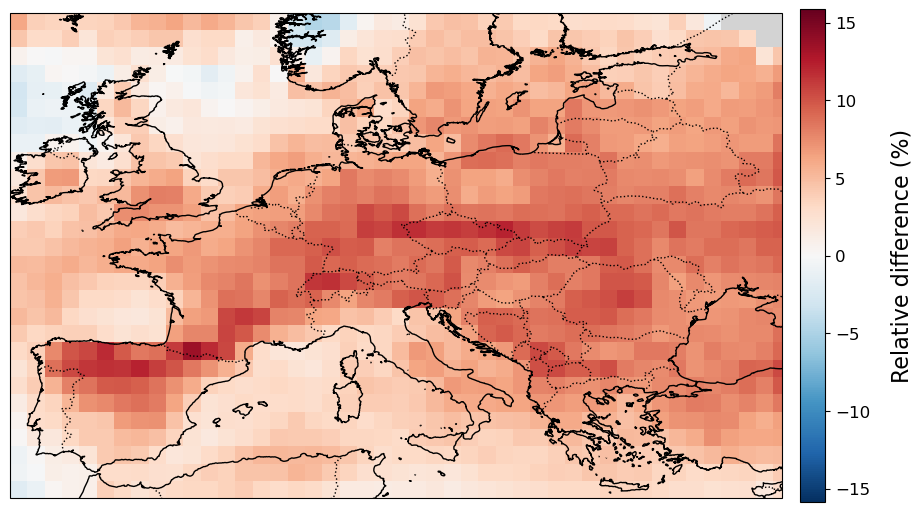

In [19]:
from matplotlib.colors import TwoSlopeNorm

# 1) Compute the multi‐model mean
mean_rel_diff = all_relative_differences_combined.median(dim="model")

# Compute vmin and vmax based on percentiles
vmin = mean_rel_diff.min().values  # Minimum value in the data
vmax = mean_rel_diff.max().values  # Maximum value in the data

# Use TwoSlopeNorm to center the colormap at 0
norm = TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

map_plots(
    mean_rel_diff,
    setnan=False,
    cmap='RdBu_r',
    vmin=-vmax,             # Minimum value
    vmax=vmax,             # Maximum value
    title=None,
    label="Relative difference (%)"
)

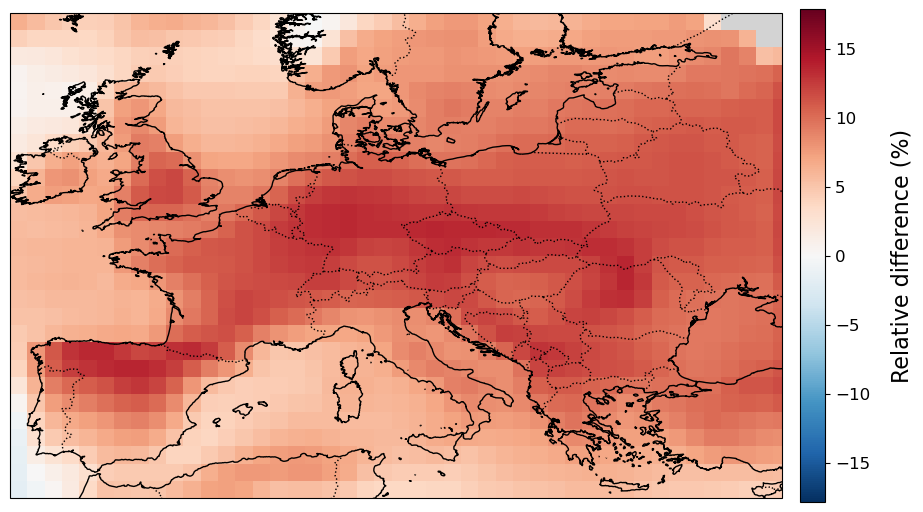

In [21]:
mean_rel_diff_nt= all_relative_differences_combined_nt.median(dim="model")
vmin_nt = mean_rel_diff_nt.min().values  # Minimum value in the data
vmax_nt = mean_rel_diff_nt.max().values 
# 1) Compute the multi‐model mean
mean_rel_diff_nt = all_relative_differences_combined_nt.mean(dim="model")


map_plots(
    mean_rel_diff_nt,setnan=False,
    cmap='RdBu_r',
    vmin=-vmax_nt,             # your 0.5th percentile
    vmax=vmax_nt,             # your 99.5th percentile
    title=None,
    label="Relative difference (%)"
)

In [5]:
vmin_EOC=min(mean_power_EOC_nt.min().values, mean_power_EOC.min().values)
vmax_EOC=max(mean_power_EOC_nt.max().values, mean_power_EOC.max().values)


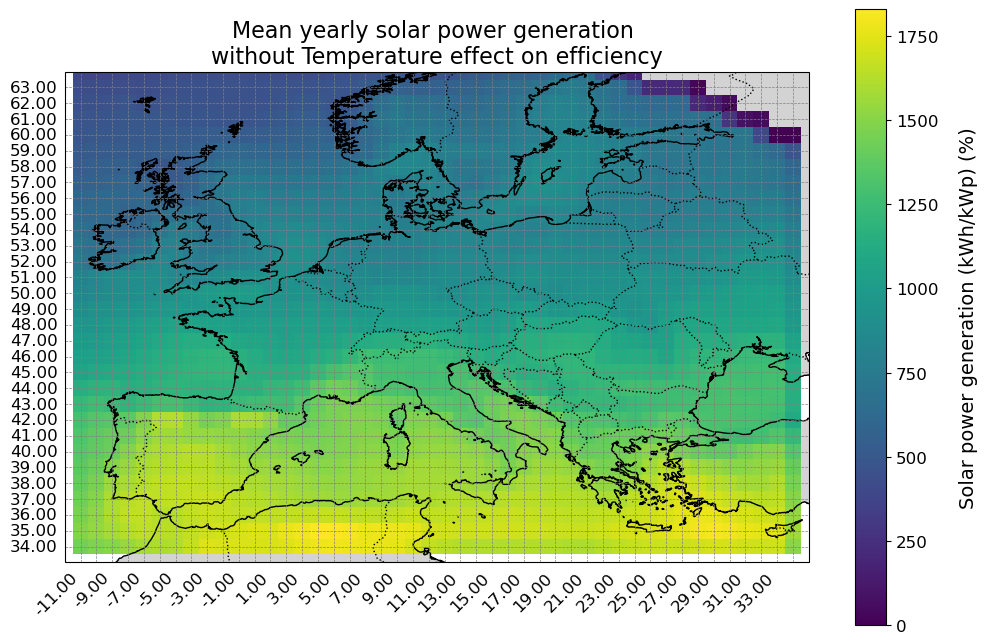

In [7]:
from plots import map_plots
map_plots(
    mean_power_EOC_nt,
    setnan=True,
    cmap='viridis',
    vmin=vmin_EOC,             # your 0.5th percentile
    vmax=vmax_EOC,             # your 99.5th percentile
    title="Mean yearly solar power generation \nwithout Temperature effect on efficiency",
    label="Solar power generation (kWh/kWp) (%)"
)

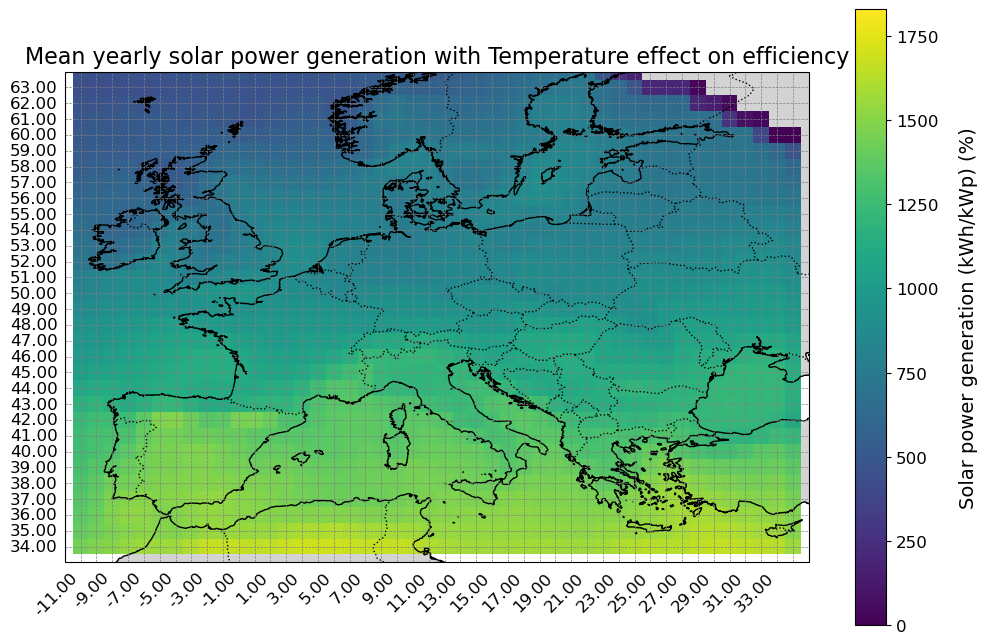

In [8]:
map_plots(
    mean_power_EOC,setnan=True,
    cmap='viridis',
    vmin=vmin_EOC,             # your 0.5th percentile
    vmax=vmax_EOC,             # your 99.5th percentile
    title="Mean yearly solar power generation with Temperature effect on efficiency",
    label="Solar power generation (kWh/kWp) (%)"
)

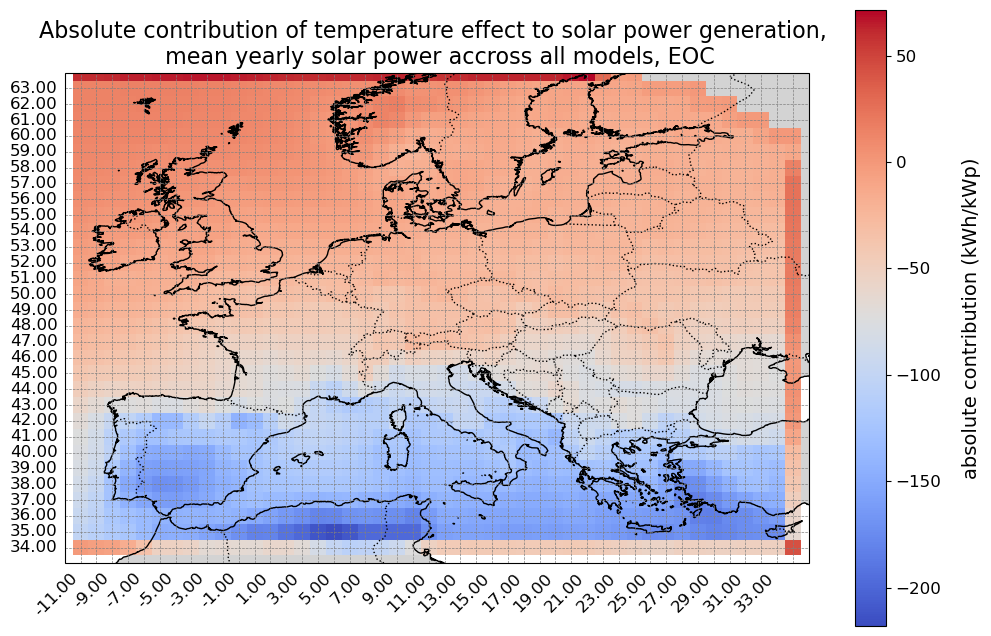

In [42]:
abs_diff_temp= mean_power_EOC - mean_power_EOC_nt
map_plots(
    abs_diff_temp,setnan=True,
    cmap='coolwarm',
    vmin=None,             # your 0.5th percentile
    vmax=None,             # your 99.5th percentile
    title="Absolute contribution of temperature effect to solar power generation, \n mean yearly solar power accross all models, EOC",
    label="absolute contribution (kWh/kWp)"
)

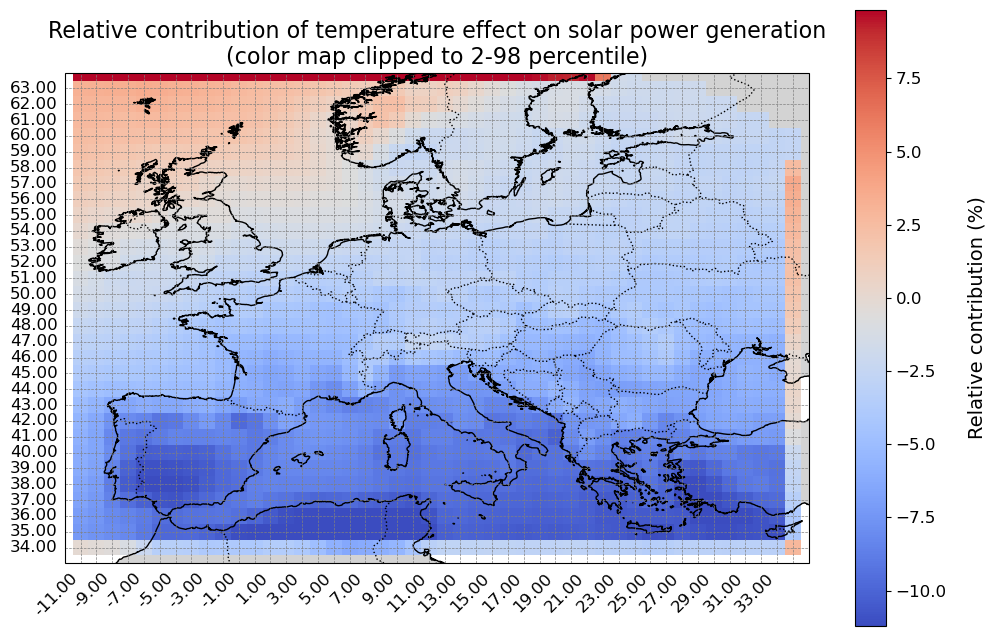

In [39]:
abs_diff_temp= mean_power_EOC - mean_power_EOC_nt
rel_contr_temp= abs_diff_temp/mean_power_EOC*100
q05_r, q995_r = np.nanpercentile(rel_contr_temp, [2, 98])
vmin_r=q05_r
vmax_r=q995_r
map_plots(
    rel_contr_temp,setnan=True,
    cmap='coolwarm',
    vmin=vmin_r,             # your 0.5th percentile
    vmax=vmax_r,             # your 99.5th percentile
    title="Relative contribution of temperature effect on solar power generation\n(color map clipped to 2-98 percentile)",
    label="Relative contribution (%)"
)

In [44]:
rel_contr_temp.median()

<xarray.DataArray 'specific generation' ()> Size: 8B
array(-3.53356507)

In [19]:
climate_signal=mean_power_EOC-mean_power_BOC
climate_signal_irr=mean_power_EOC_nt-mean_power_BOC_nt
climate_signal_temp=mean_power_EOC_nt-mean_power_EOC_nt

In [26]:
# Set a small threshold to avoid division by nearly-zero values
threshold = 5 # Adjust based on your unit scale (e.g. kWh/kWp)

# Mask out grid cells where climate_signal is too small
valid_mask = climate_signal.where(np.abs(climate_signal) > threshold)

# Compute contributions safely
contribution_irr = (climate_signal_irr / valid_mask) * 100
contribution_temp = (climate_signal_temp / valid_mask) * 100


In [ ]:
map_plots(
    contribution_temp,setnan=True,
    cmap='viridis',
    vmin=None,             # your 0.5th percentile
    vmax=None,             # your 99.5th percentile
    title="Relative contribution of temperature effect",
    label="Relative contribution (kWh/kWp) (%)"
)

In [38]:
def map_plots_discrete(
    variable,
    cmap='viridis',
    setnan=True,
    vmin=None,
    vmax=None,
    norm=None,
    title='',
    label='',
    show_legend=True,        # new flag
):
    """
    Plot a map with discrete categories using a legend instead of a colorbar.

    Parameters:
    - variable: xarray.DataArray, the variable to plot.
    - cmap: str or Colormap, color map to use.
    - setnan: bool, whether to set 0 values as NaN.
    - vmin, vmax: float, value limits.
    - norm: matplotlib.colors.BoundaryNorm, required for discrete bins.
    - title: str, plot title.
    - label: str, legend label title.
    - show_legend: bool, whether to draw the discrete‐category legend.

    Returns:
    - None (displays the plot).
    """
    import matplotlib.pyplot as plt
    import matplotlib.patches as mpatches
    import matplotlib.ticker as mticker
    import cartopy.crs as ccrs
    import cartopy.feature as cfeature
    import matplotlib.cm as cm
    import xarray as xr
    import numpy as np

    # Mask zeros to NaN if requested
    if setnan:
        variable = xr.where(variable != 0, variable, float('nan'))
    # Clip to your lon/lat region
    variable = variable.sel(x=slice(-12, 35), y=slice(33, 64))

    if variable.isnull().all():
        print("⚠️ All values are NaN — nothing to plot.")
        return

    lon = variable.x
    lat = variable.y

    # resolve cmap
    if isinstance(cmap, str):
        cmap = cm.get_cmap(cmap)

    # figure + map
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent([-12, 35, 33, 64], crs=ccrs.PlateCarree())

    # assemble pcolormesh kwargs so we never pass vmin/vmax + norm together
    pcol_kwargs = dict(
        transform=ccrs.PlateCarree(),
        cmap=cmap,
        shading='auto'
    )
    if norm is not None:
        pcol_kwargs['norm'] = norm
    else:
        pcol_kwargs['vmin'] = vmin
        pcol_kwargs['vmax'] = vmax

    c = ax.pcolormesh(lon, lat, variable, **pcol_kwargs)

    # add map features
    ax.coastlines(resolution='10m', linewidth=1)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.LAND, facecolor='lightgray')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    ax.set_title(title, fontsize=16)

    # gridlines
    gridlines = ax.gridlines(
        draw_labels=True,
        linewidth=0.5,
        color='gray',
        linestyle='--',
        x_inline=False,
        y_inline=False
    )
    gridlines.xlocator = plt.FixedLocator(lon.values)
    gridlines.ylocator = plt.FixedLocator(lat.values)
    gridlines.xformatter = mticker.FuncFormatter(lambda x, _: f"{x:.2f}")
    gridlines.yformatter = mticker.FuncFormatter(lambda y, _: f"{y:.2f}")
    gridlines.top_labels = False
    gridlines.right_labels = False
    gridlines.xlabel_style = {'fontsize': 12, 'rotation': 45, 'ha': 'right'}
    gridlines.ylabel_style = {'fontsize': 12}
    gridlines.xlines = False
    gridlines.ylines = False

    # optional legend for discrete categories
    if show_legend and norm is not None:
        levels = norm.boundaries[:-1]
        colors = [cmap(norm(level)) for level in levels]
        patches = [
            mpatches.Patch(color=col, label=f"{int(val)}")
            for col, val in zip(colors, levels)
        ]
        ax.legend(
            handles=patches,
            title=label,
            loc="center left",
            bbox_to_anchor=(1, 0.5),
            fontsize=10,
            title_fontsize=12,
            frameon=True,
            edgecolor="black",
        )
    plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/sign_agr.pdf", bbox_inches='tight', dpi=300)
    plt.show()


In [33]:
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm

models = ["ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2",
          "HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"]

# Stack & compute agreement_count, mask <2 as before
all_rel = xr.concat([relative_differences[m] for m in models],
                    dim=pd.Index(models, name="model"))
# 2) Ensemble‐mean & sign
ens_mean = all_rel.median(dim="model")
ens_sign = np.sign(ens_mean)

# 3) Agreement count
agreement_count = (np.sign(all_rel) == ens_sign).sum(dim="model")

# 4) Mask everywhere ens_mean is NaN AND everywhere < 2 agree
agreement_count = agreement_count.where(
    (ens_mean.notnull()) & (agreement_count >= 1)
).astype(float)  # Convert to float to allow NaN values
sign_agreement_count = agreement_count.where((agreement_count != 0))

# Replace placeholder values (-9.22337204e+18) with NaN
sign_agreement_count = agreement_count.where(agreement_count > -1e18)

n_colors = len(models)   # 6 distinct agreement levels: 2,3,4,5,6,7

# grab viridis and turn into a discrete ListedColormap
blue = plt.get_cmap("Blues_r", n_colors)
cmap_blues = ListedColormap(blue(np.arange(n_colors)))

# Set NaN values to grey
cmap_blues.set_bad(color="lightgrey")

# reuse the same bins & norm setup as before
bins = np.arange(1, len(models)+2)   # [2,3,4,5,6,7,8]
norm = BoundaryNorm(bins, ncolors=n_colors, clip=False)
ticks = bins[:-1]                    # [2,3,4,5,6,7]




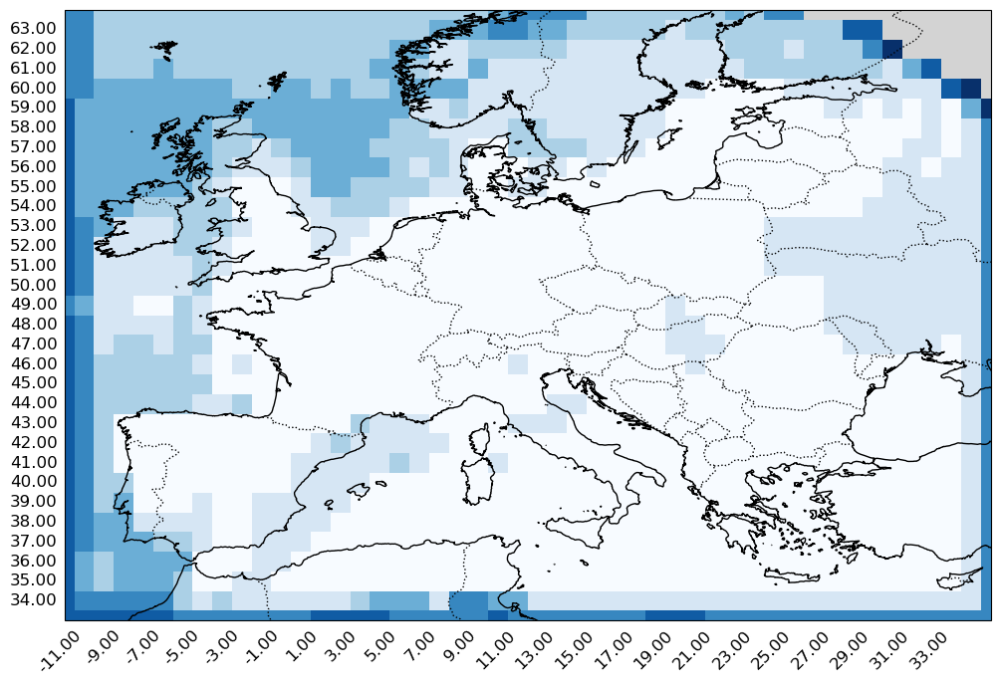

In [39]:
# Call the map_plots_discrete function
map_plots_discrete(
    sign_agreement_count,  # Pass agreement_count as an xarray.DataArray
    setnan=False,
    cmap=cmap_blues,
    norm=norm,  # Use BoundaryNorm for discrete mapping
    title=None,
    label="Agreement (n models)", 
    show_legend=False  # Pass the label directly
)

In [85]:
import xarray as xr
# 1. Stack into one DataArray [model, y, x]
all_rel = xr.concat(
    [relative_differences[m] for m in models],
    dim = pd.Index(models, name="model")
)

# 2. Compute the multi‐model mean
ens_mean = all_rel.median(dim="model")

# 3. Define your tolerance (e.g. ±5 % absolute difference)
tol = 5

# 4. Count how many models fall within ±tol of the mean
within_tol = (np.abs(all_rel - ens_mean) <= tol).sum(dim="model")

# 5. Convert to percent agreement
agreement_mag = within_tol

n_colors = len(models)   # 7 distinct agreement levels: 2,3,4,5,6,7

# grab viridis and turn into a discrete ListedColormap
vir = plt.get_cmap("Blues_r", n_colors)
cmap_blue = ListedColormap(vir(np.arange(n_colors)))

# Set NaN values to grey
cmap_blue.set_bad(color="lightgrey")

# reuse the same bins & norm setup as before
bins = np.arange(1, len(models)+2)   # [2,3,4,5,6,7,8]
norm = BoundaryNorm(bins, ncolors=n_colors, clip=False)
ticks = bins[:-1]                    # [2,3,4,5,6,7]

# 6. Plot that
#map_plots_discrete(
 #   agreement_mag,
 #   cmap=cmap_blue,
  #  setnan=True,
   # norm=norm,
    #title=f"Model agreement: model mean is within ±{tol:.1f}% of multi-model mean",
    #label="Agreement (%)"
#)


In [91]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import xarray as xr
from matplotlib.colors import BoundaryNorm, ListedColormap

def map_plots_discrete(
    variables,
    titles,
    subtitles=None,
    categories=None,
    cmaps='Blues',
    setnan=True,
    legend_title='Agreement Levels',
    figsize=(14,6)
):
    # Defaults
    if subtitles is None:
        subtitles = ['', '']
    if categories is None:
        raise ValueError("You must pass a list of integer categories.")
    if isinstance(cmaps, str):
        cmaps = [cmaps, cmaps]
    if len(cmaps) != 2:
        raise ValueError("`cmaps` must be a string or list of two strings.")

    # 1) Mask zeros + clip
    if setnan:
        variables = [xr.where(v != 0, v, np.nan) for v in variables]
    variables = [v.sel(x=slice(-12,35), y=slice(33,64)) for v in variables]

    # 2) All-NaN guard
    if all(v.isnull().all() for v in variables):
        print("⚠️ All values are NaN — nothing to plot.")
        return

    # 3) Discrete norm (shared)
    cats = np.array(categories)
    ncat = len(cats)
    bounds = np.append(cats - 0.5, cats[-1] + 0.5)
    norm = BoundaryNorm(bounds, ncolors=ncat)

    # 4) One ListedColormap per panel
    discrete_cmaps = []
    for cmap_name in cmaps:
        base = plt.get_cmap(cmap_name)
        colors = base(np.linspace(0,1,ncat))
        discrete_cmaps.append(ListedColormap(colors))

    # 5) Figure + axes
    fig, axes = plt.subplots(
        1, 2, figsize=figsize,
        subplot_kw={'projection': ccrs.PlateCarree()},
        gridspec_kw={'wspace': 0.02}
    )

    for ax, data, ttl, sub, cmap_i in zip(
        axes, variables, titles, subtitles, discrete_cmaps
    ):
        ax.set_extent([-12,35,33,64], crs=ccrs.PlateCarree())
        ax.pcolormesh(
            data.x, data.y, data,
            cmap=cmap_i, norm=norm,
            shading='auto',
            transform=ccrs.PlateCarree()
        )
        ax.coastlines('10m', linewidth=1)
        ax.add_feature(cfeature.BORDERS, linestyle=':')
        ax.add_feature(cfeature.LAND, facecolor='lightgray')
        ax.add_feature(cfeature.OCEAN, facecolor='white')

        # main title at 18pt
        ax.set_title(ttl, fontsize=16, pad=12)

        # subtitle up closer, at 18pt
        ax.text(
            0.5, -0.07, sub,
            transform=ax.transAxes,
            ha='center', va='top',
            fontsize=16
        )

        # no labels on gridlines
        gl = ax.gridlines(
            draw_labels=False,
            linewidth=0.5, color='gray', linestyle='--',
            x_inline=False, y_inline=False
        )
        gl.xlines = gl.ylines = False
        ax.set_xticks([]); ax.set_yticks([])

    # 6) Build legend patches
    patches = []
    for cat, color in zip(cats, discrete_cmaps[0].colors):
        # singular “Model” if cat==1, otherwise “Models”
        word = "Model" if cat == 1 else "Models"
        patches.append(
            mpatches.Patch(
                facecolor=color,
                edgecolor='black',
                label=f"{cat} {word}"
            )
        )

    # 7) Room + single legend in 18pt
    fig.subplots_adjust(right=0.80)
    axes[-1].legend(
        handles=patches,
        title=legend_title,
        loc='center left',
        bbox_to_anchor=(1.02, 0.5),
        frameon=True,
        edgecolor='black',
        fontsize=12,
        title_fontsize=12
    )
    plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/mag_agr_sensitivity.pdf", bbox_inches='tight', dpi=300)
    plt.show()




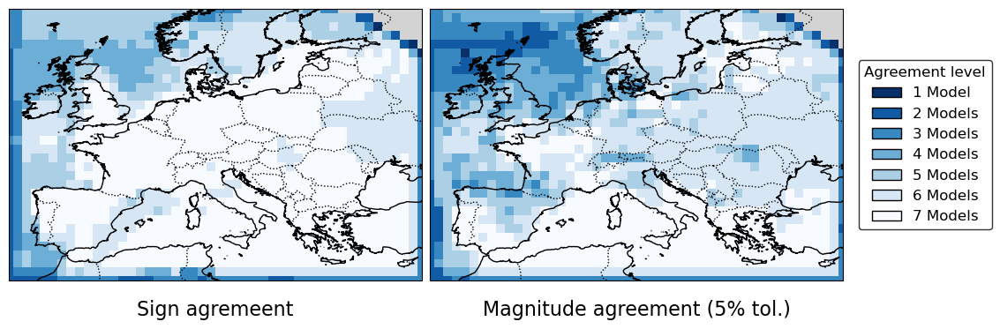

In [90]:

categories=[1,2,3,4,5,6,7]
bounds = np.arange(1, 9)
norm = BoundaryNorm(bounds, ncolors=len(bounds))
variables=[sign_agreement_count, agreement_mag]  # List of DataArrays

map_plots_discrete(
    variables,              # now a list like [var1, var2]
    titles=[None, None], 
    subtitles=["Sign agremeent", "Magnitude agreement (5% tol.)"],
    categories=categories,               # list of two titles, e.g. ['Plot A', 'Plot B']
    cmaps=['Blues_r', "Blues_r"],  # list of two colormaps, e.g. ['Blues', 'Greens'],
    setnan=True,              # same norm for both plots
    legend_title='Agreement level',        # e.g. 'Agreement (%)'
    figsize=(14, 12))


In [87]:
import xarray as xr
# 1. Stack into one DataArray [model, y, x]
all_rel = xr.concat(
    [relative_differences[m] for m in models],
    dim = pd.Index(models, name="model")
)

# 2. Compute the multi‐model mean
ens_mean = all_rel.median(dim="model")

# 3. Define your tolerance (e.g. ±5 % absolute difference)
tol = 4

# 4. Count how many models fall within ±tol of the mean
within_tol_4 = (np.abs(all_rel - ens_mean) <= tol).sum(dim="model")

# 5. Convert to percent agreement
agreement_mag_4 = within_tol_4

In [88]:
# 3. Define your tolerance (e.g. ±5 % absolute difference)
tol = 3

# 4. Count how many models fall within ±tol of the mean
within_tol_3 = (np.abs(all_rel - ens_mean) <= tol).sum(dim="model")

# 5. Convert to percent agreement
agreement_mag_3 = within_tol_3

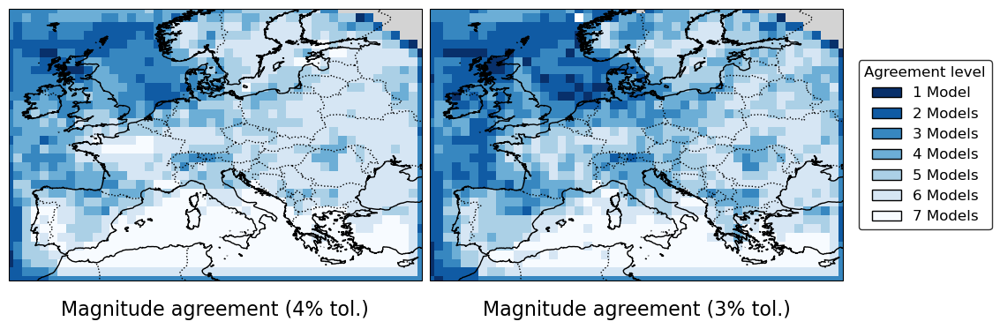

In [92]:

categories=[1,2,3,4,5,6,7]
bounds = np.arange(1, 9)
norm = BoundaryNorm(bounds, ncolors=len(bounds))
variables=[agreement_mag_4, agreement_mag_3]  # List of DataArrays

map_plots_discrete(
    variables,              # now a list like [var1, var2]
    titles=[None, None], 
    subtitles=["Magnitude agreement (4% tol.)", "Magnitude agreement (3% tol.)"],
    categories=categories,               # list of two titles, e.g. ['Plot A', 'Plot B']
    cmaps=['Blues_r', "Blues_r"],  # list of two colormaps, e.g. ['Blues', 'Greens'],
    setnan=True,              # same norm for both plots
    legend_title='Agreement level',        # e.g. 'Agreement (%)'
    figsize=(14, 12))

In [ ]:
agreement_mag.mean()

<xarray.DataArray 'specific generation' ()> Size: 8B
array(76.41594517)

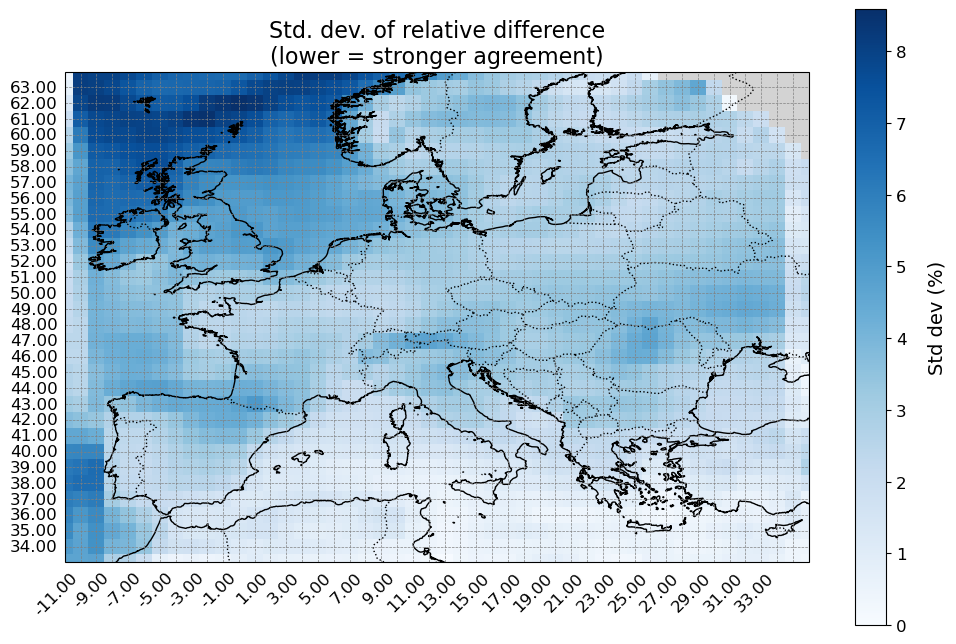

In [ ]:
# Standard deviation
std_rel = all_rel.std(dim="model")

map_plots(
    std_rel, setnan=True,
    cmap="Blues",
    vmin=0, vmax=std_rel.max(),
    title="Std. dev. of relative difference\n(lower = stronger agreement)",
    label="Std dev (%)"
)

In [ ]:
std_rel.mean()

<xarray.DataArray 'specific generation' ()> Size: 8B
array(3.09257363)

/home/s233224/anaconda3/envs/atlite_cmip6_2025/lib/python3.13/site-packages/numpy/lib/_nanfunctions_impl.py:1650: RuntimeWarning: All-NaN slice encountered
  return fnb._ureduce(a,


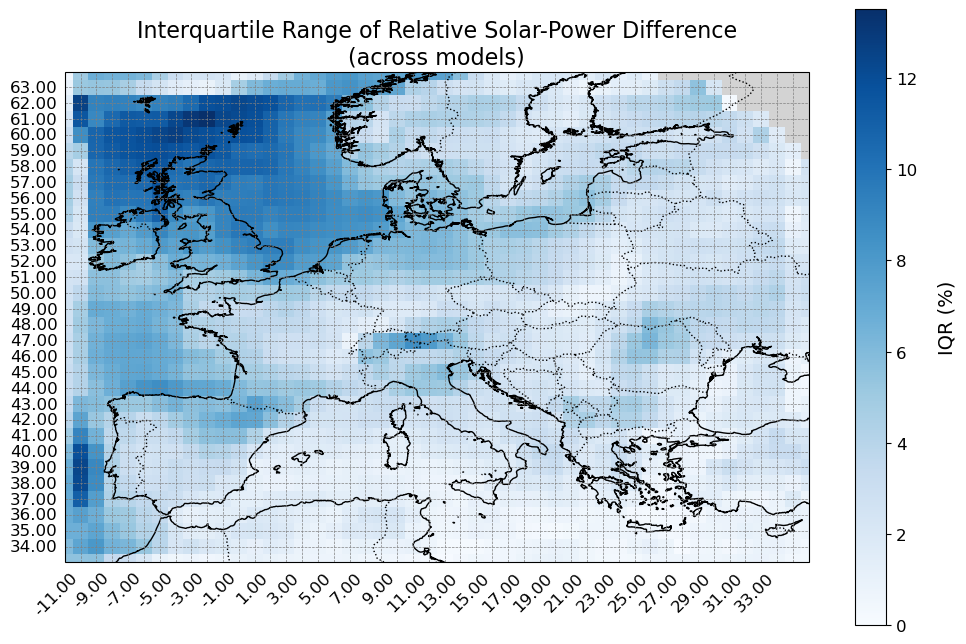

In [34]:
# 1. Combine all per-model maps into one DataArray along a new "model" dimension
combined = xr.concat(
    [relative_differences[m] for m in models],
    dim="model"
).assign_coords(model=("model", models))

# 2. Compute the 25th and 75th percentiles across models (at each grid cell)
q1 = combined.quantile(0.25, dim="model", skipna=True)
q3 = combined.quantile(0.75, dim="model", skipna=True)

# 3. IQR map (still in “%” since your rel diffs are already multiplied by 100)
iqr_map = q3 - q1

# 4. Choose bounds for plotting (you can also hard-code sensible vmin/vmax)
vmin, vmax = float(iqr_map.min()), float(iqr_map.max())

# 5. Plot
from plots import map_plots
map_plots(
    iqr_map,
    cmap="Blues",      # reversed-blue works well
    setnan=True,
    vmin=vmin, 
    vmax=vmax,
    title="Interquartile Range of Relative Solar-Power Difference\n(across models)",
    label="IQR (%)"
)

In [ ]:
iqr_map.mean()

<xarray.DataArray 'specific generation' ()> Size: 8B
array(3.90697448)

/tmp/ipykernel_16876/3443004181.py:10: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap('RdBu_r').copy()


(<Figure size 1200x800 with 2 Axes>,
 <GeoAxes: title={'center': 'Mean relative difference\n(excluded: IQR>6% or sign-agreement <5 models)'}>)

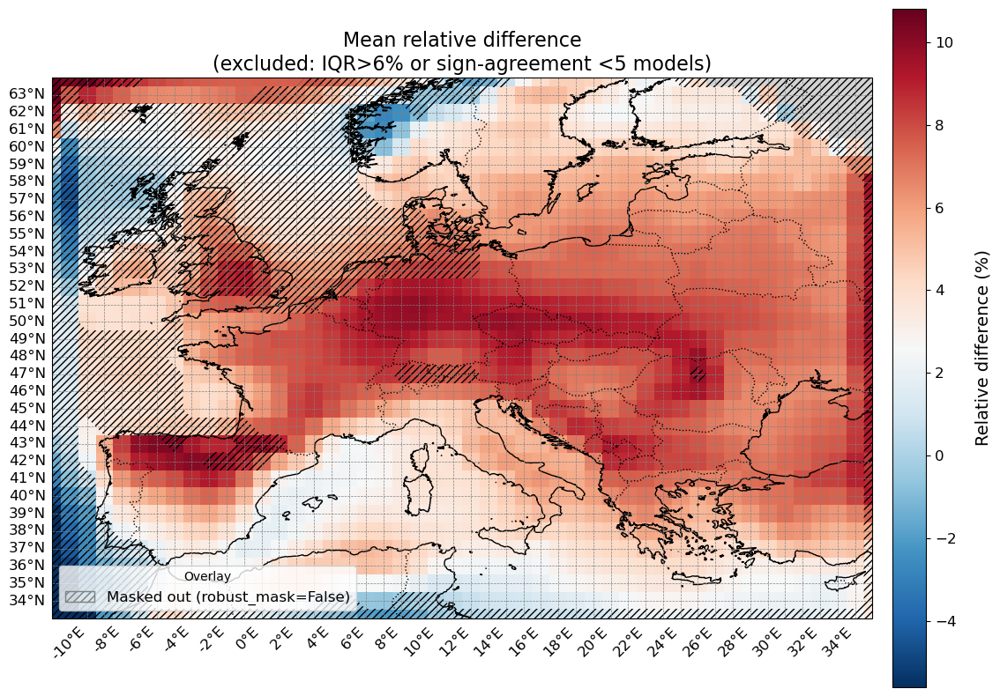

In [35]:
import matplotlib as mpl
robust_mask = (iqr_map <= 6) & (sign_agreement_count >= 5)

# --- 5) Mask the mean field
# 3) Compute the ensemble‐mean relative difference
mean_rel_diff = all_rel.mean(dim="model")
masked_mean = mean_rel_diff.where(robust_mask)

# --- 6) Prepare a colormap that shows everything else as grey
cmap = mpl.cm.get_cmap('RdBu_r').copy()
cmap.set_bad(color='lightgrey')   # masked cells will appear grey
q05, q995 = np.nanpercentile(mean_rel_diff, [0.5, 99.5])

# --- 7) Plot
from plots import map_plots_mask
map_plots_mask(
    mean_rel_diff,
    cmap=cmap,
    setnan=True,
    vmin=q05,       # your previously computed 0.5th percentile
    vmax=q995,      # your previously computed 99.5th percentile
    title="Mean relative difference\n(excluded: IQR>6% or sign-agreement <5 models)",
    label="Relative difference (%)",
    robust_mask=robust_mask,
    hatch_style='////',
    hatch_color = 'gray'
)


In [6]:
import xarray as xr
models = [
    "ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2",
    "HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"
]

# 2) Re‐stack all relative_differences into one DataArray with a "model" dimension
all_rel = xr.concat(
    [relative_differences[m] for m in models],
    dim=pd.Index(models, name="model")
)

# 3) Compute the ensemble‐mean relative difference
mean_rel_diff = all_rel.mean(dim="model")

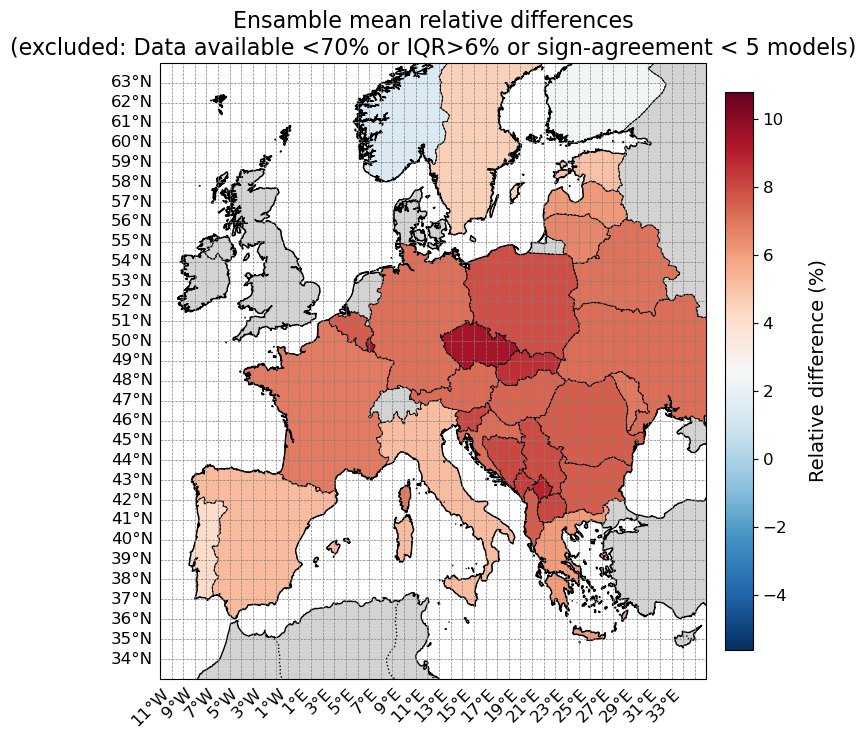

In [10]:
from plots import country_plots_weighted
country_plots_weighted(masked_mean, 'RdBu_r', vmin=q05, vmax=q995, title="Ensamble mean relative differences\n(excluded: Data available <70% or IQR>6% or sign-agreement < 5 models)", label="Relative difference (%)", missing_frac_thresh=0.7)

In [69]:
ds=xr.open_dataset("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/ACCESS-CM2_1x1grid/historical/aggregated_solar_power_seasons_2012.nc")
ds

<xarray.Dataset> Size: 63kB
Dimensions:  (x: 48, y: 40)
Coordinates:
  * x        (x) float64 384B -12.0 -11.0 -10.0 -9.0 ... 32.0 33.0 34.0 35.0
    lon      (x) float64 384B ...
  * y        (y) float64 320B 33.0 34.0 35.0 36.0 37.0 ... 69.0 70.0 71.0 72.0
    lat      (y) float64 320B ...
Data variables:
    Winter   (y, x) float64 15kB ...
    Spring   (y, x) float64 15kB ...
    Summer   (y, x) float64 15kB ...
    Autumn   (y, x) float64 15kB ...

In [66]:
# ── USER SETTINGS ─────────────────────────────────────────────────────────────
models   = ["ACCESS-CM2","CanESM5","CMCC-CM2-SR5","CMCC-ESM2",
            "HadGEM3-GC31-LL","HadGEM3-GC31-MM","MRI-ESM2-0"]
base_dir = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power"
tol      = 5.0   # ±5 % for magnitude‐agreement
# ──────────────────────────────────────────────────────────────────────────────

# 1) Load seasonal‐means and compute Δ% per model, then convert to DataArray
rel_diff = {}
for model in models:
    boc_files = [
        os.path.join(base_dir, f"{model}_1x1grid/historical/aggregated_solar_power_seasons_{yr}.nc")
        for yr in range(1980, 2015)
    ]
    eoc_files = [
        os.path.join(base_dir, f"{model}_1x1grid/ssp585/aggregated_solar_power_seasons_{yr}.nc")
        for yr in range(2065, 2100)
    ]

    ds_boc = xr.concat(
        [xr.open_dataset(f).expand_dims(time=[yr]) for yr,f in zip(range(1980,2015), boc_files)],
        dim="time"
    )
    ds_eoc = xr.concat(
        [xr.open_dataset(f).expand_dims(time=[yr]) for yr,f in zip(range(2065,2100), eoc_files)],
        dim="time"
    )

    # compute the relative‐difference Dataset
    ds_rel = (ds_eoc.mean("time") - ds_boc.mean("time")) / ds_boc.mean("time") * 100

    # convert to a single DataArray with a "season" dimension
    rel_diff[model] = ds_rel.to_array(dim="season")
    # now rel_diff[model].dims == ("season", "y", "x")

# 2) Dynamically pull the season names from the new coordinate
seasons = list(rel_diff[models[0]].season.values)
print("Seasons found:", seasons)


Seasons found: ['Winter', 'Spring', 'Summer', 'Autumn']


In [67]:
ds_boc

<xarray.Dataset> Size: 2MB
Dimensions:  (time: 35, y: 40, x: 48)
Coordinates:
  * time     (time) int64 280B 1980 1981 1982 1983 1984 ... 2011 2012 2013 2014
  * x        (x) float64 384B -12.0 -11.0 -10.0 -9.0 ... 32.0 33.0 34.0 35.0
    lon      (x) float64 384B -12.0 -11.0 -10.0 -9.0 ... 32.0 33.0 34.0 35.0
  * y        (y) float64 320B 33.0 34.0 35.0 36.0 37.0 ... 69.0 70.0 71.0 72.0
    lat      (y) float64 320B 33.0 34.0 35.0 36.0 37.0 ... 69.0 70.0 71.0 72.0
Data variables:
    Winter   (time, y, x) float64 538kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Spring   (time, y, x) float64 538kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Summer   (time, y, x) float64 538kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Autumn   (time, y, x) float64 538kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0

/home/s233224/anaconda3/envs/atlite_cmip6_2025/lib/python3.13/site-packages/numpy/lib/_nanfunctions_impl.py:1650: RuntimeWarning: All-NaN slice encountered
  return fnb._ureduce(a,
/home/s233224/anaconda3/envs/atlite_cmip6_2025/lib/python3.13/site-packages/numpy/lib/_nanfunctions_impl.py:1650: RuntimeWarning: All-NaN slice encountered
  return fnb._ureduce(a,
/home/s233224/anaconda3/envs/atlite_cmip6_2025/lib/python3.13/site-packages/numpy/lib/_nanfunctions_impl.py:1650: RuntimeWarning: All-NaN slice encountered
  return fnb._ureduce(a,
/home/s233224/anaconda3/envs/atlite_cmip6_2025/lib/python3.13/site-packages/numpy/lib/_nanfunctions_impl.py:1650: RuntimeWarning: All-NaN slice encountered
  return fnb._ureduce(a,
/home/s233224/anaconda3/envs/atlite_cmip6_2025/lib/python3.13/site-packages/numpy/lib/_nanfunctions_impl.py:1650: RuntimeWarning: All-NaN slice encountered
  return fnb._ureduce(a,
/home/s233224/anaconda3/envs/atlite_cmip6_2025/lib/python3.13/site-packages/numpy/lib/_nanfunct

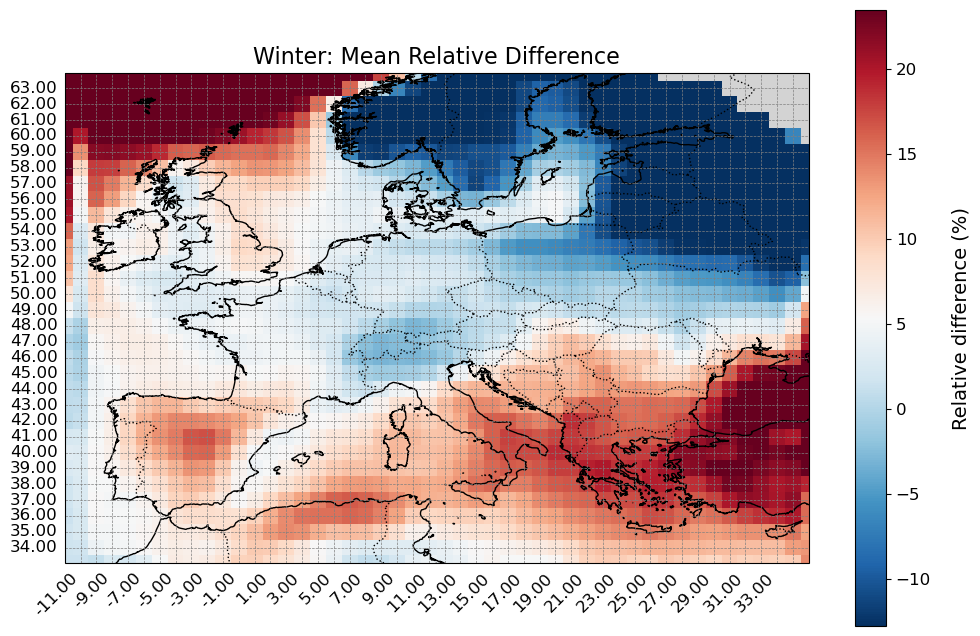

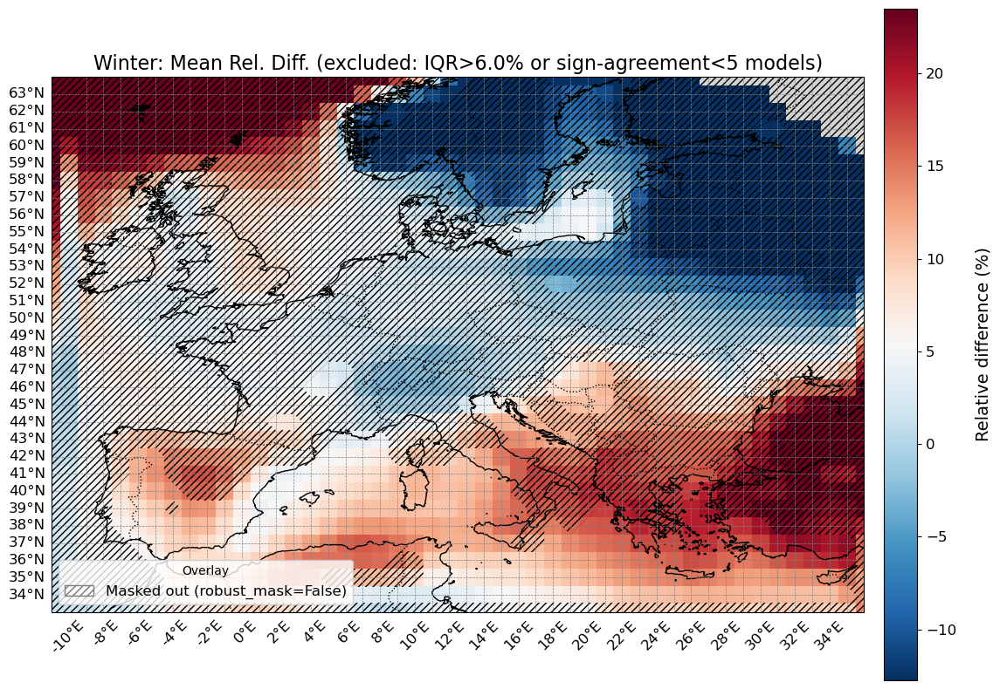

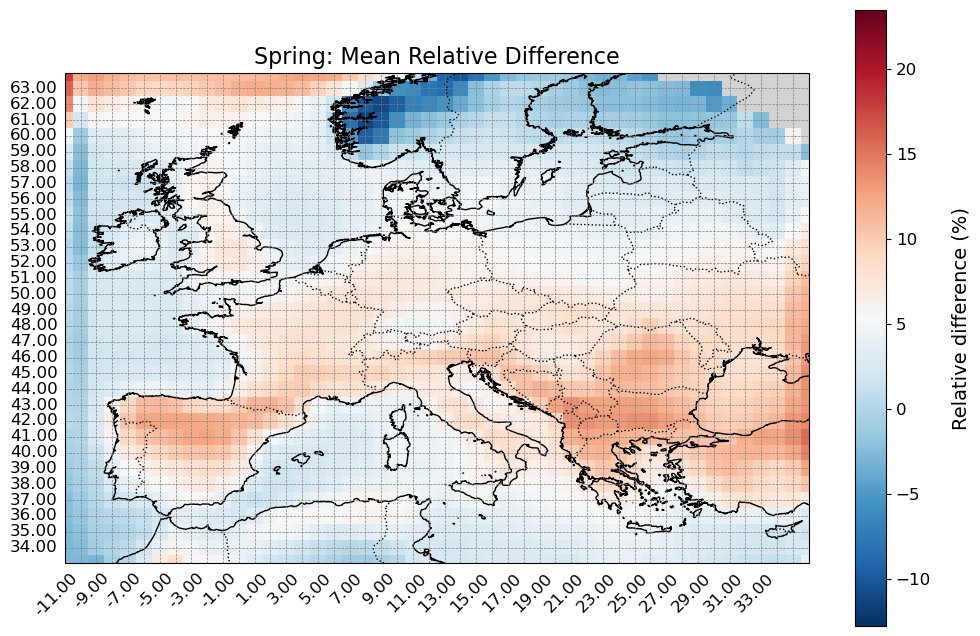

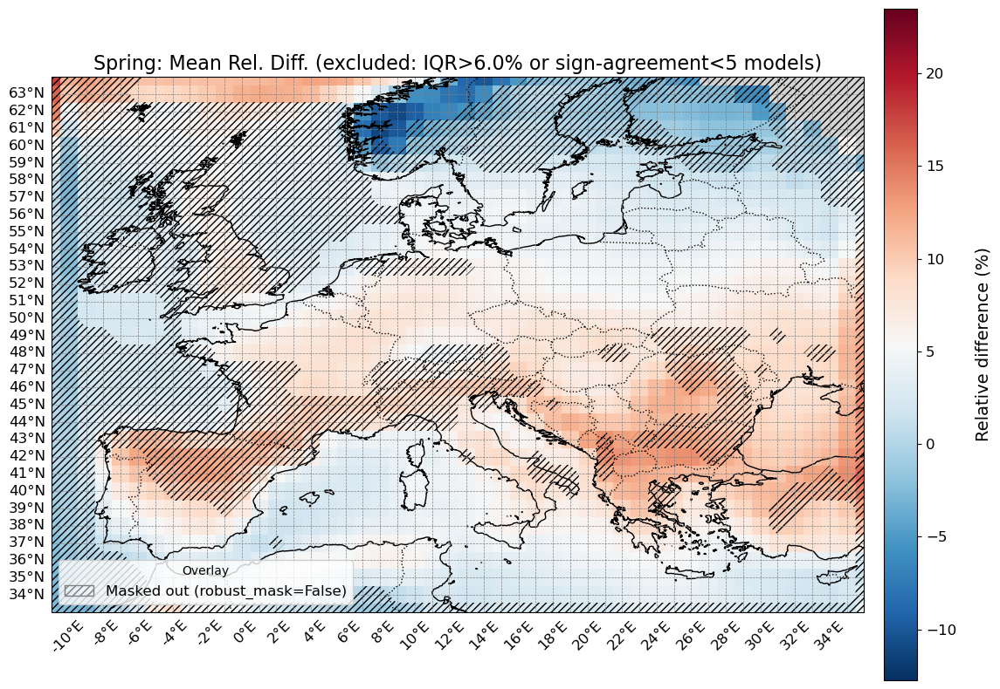

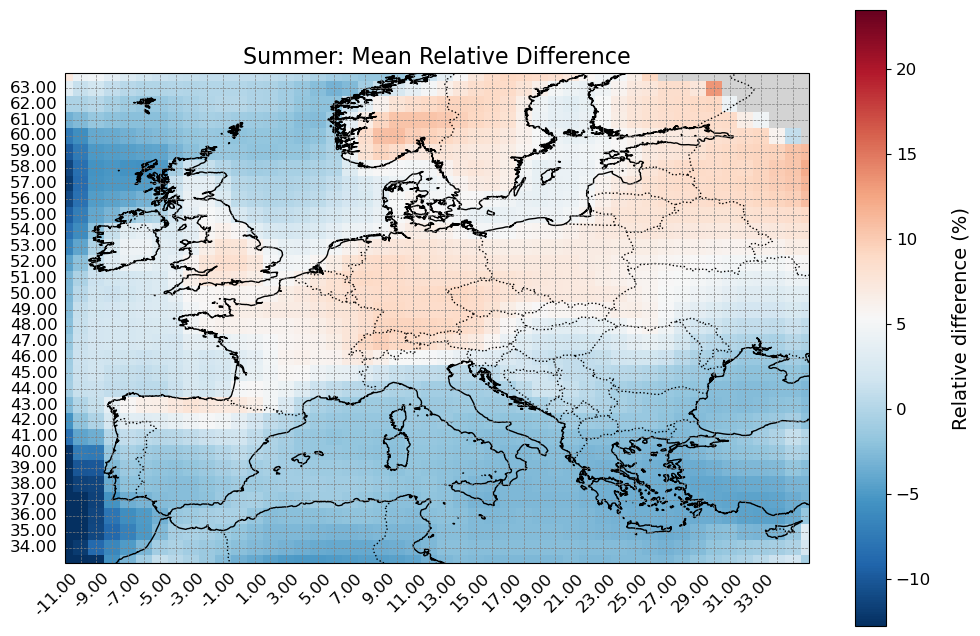

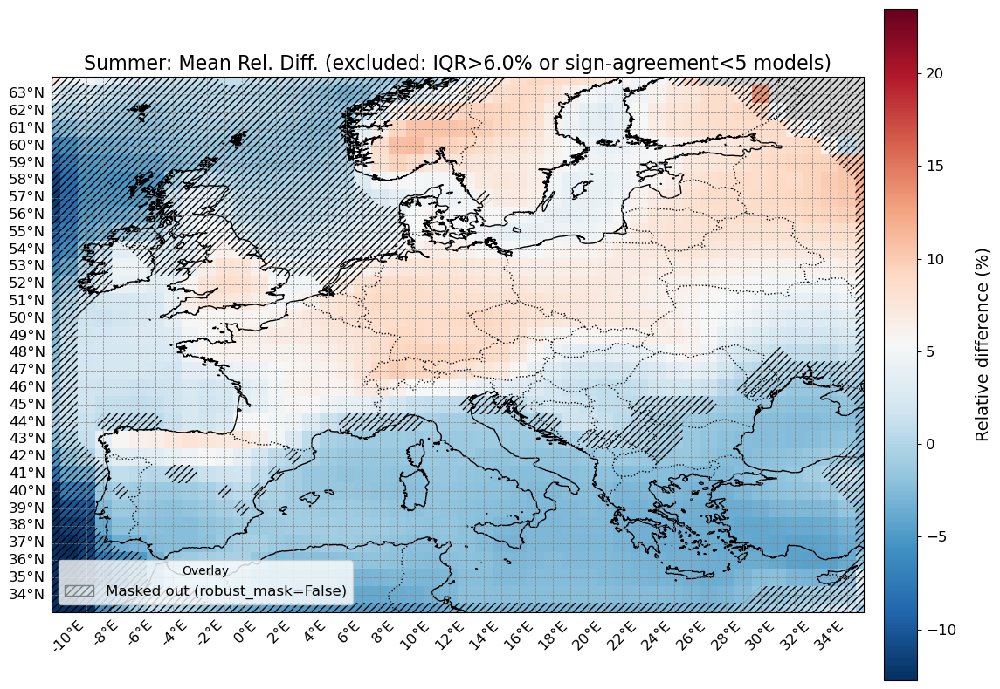

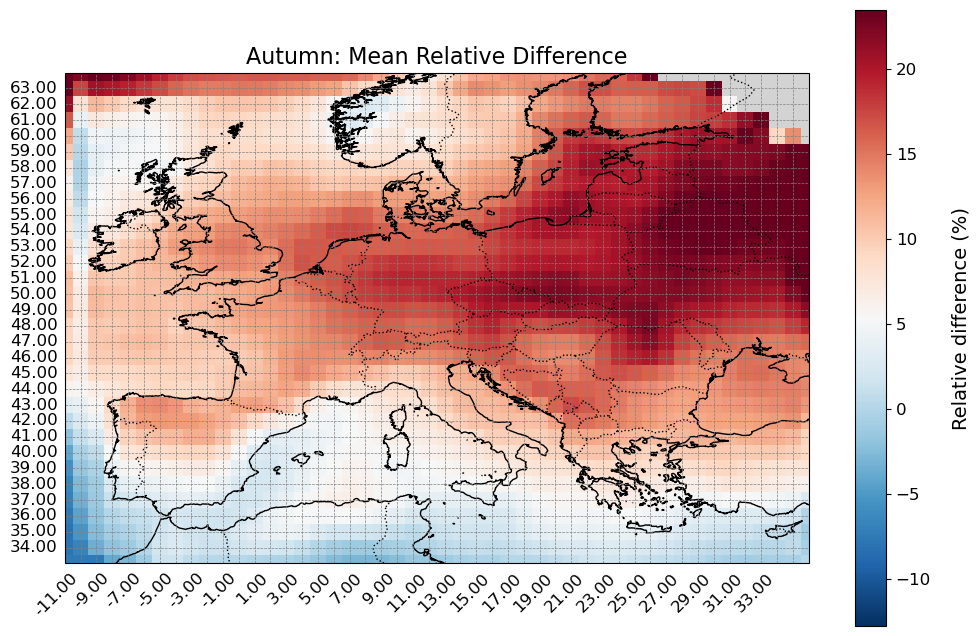

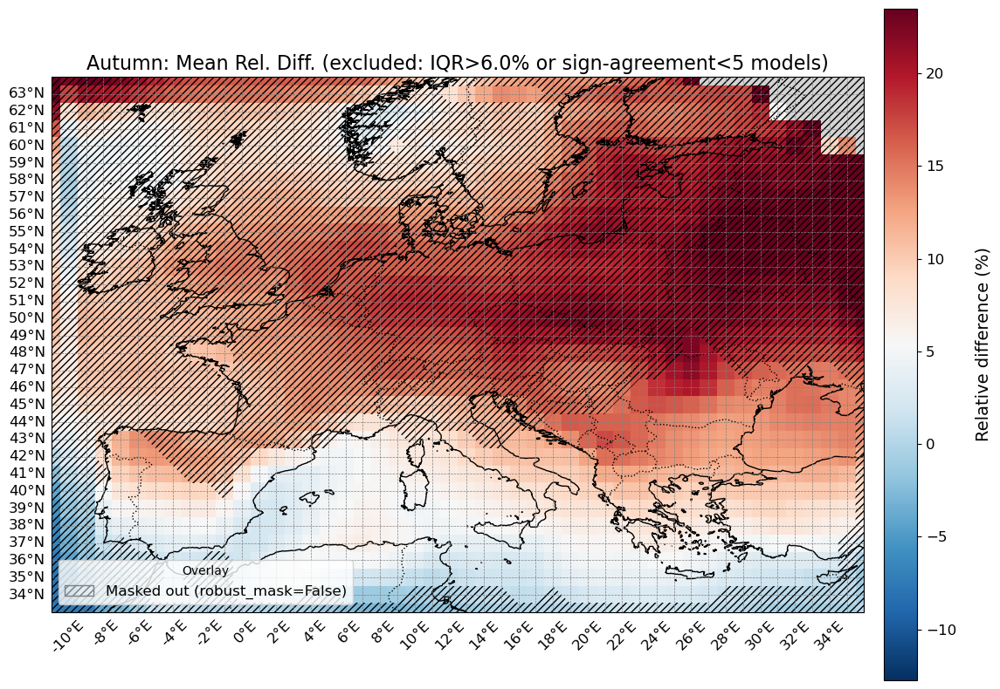

In [19]:
import os
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib as mpl
from plots import map_plots

# ── USER SETTINGS ─────────────────────────────────────────────────────────────
models    = ["ACCESS-CM2","CanESM5","CMCC-CM2-SR5","CMCC-ESM2",
             "HadGEM3-GC31-LL","HadGEM3-GC31-MM","MRI-ESM2-0"]
base_dir  = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power"
tol       = 5.0    # ±5 % for magnitude‐agreement
iqr_tol   = 6.0    # ≤6 % interquartile‐range tolerance
sign_tol  = 5  # 5 models need to agree
# ──────────────────────────────────────────────────────────────────────────────

# assume rel_diff[model] is a DataArray with dims ("season","y","x")
# and a coordinate .season giving e.g. ["DJF","MAM","JJA","SON"]
seasons = list(rel_diff[models[0]].season.values)

# prepare dicts
ens_mean    = {}
sign_agree  = {}
mag_agree   = {}
std_dev     = {}
iqr_map     = {}
wide_spread = {}

for season in seasons:
    # stack models for this season
    all_rel = xr.concat(
        [rel_diff[m].sel(season=season) for m in models],
        dim=pd.Index(models, name="model")
    )
    # ensemble mean Δ%
    ens_mean[season] = all_rel.mean(dim="model")
    # sign agreement (% of models matching the ensemble‐mean sign)
    model_signs       = np.sign(all_rel)
    ens_sign          = np.sign(ens_mean[season])
    sign_agree[season] = (model_signs == ens_sign).sum(dim="model")
    # magnitude agreement (% within ±tol of the mean)
    mag_agree[season]  = (np.abs(all_rel - ens_mean[season]) <= tol).sum(dim="model")
    # standard deviation
    std_dev[season]    = all_rel.std(dim="model")
    # interquartile range
    q25                = all_rel.quantile(0.25, dim="model")
    q75                = all_rel.quantile(0.75, dim="model")
    iqr_map[season]    = q75 - q25
    # wide 5–95% spread
    p05, p95           = all_rel.quantile([0.05, 0.95], dim="model")
    wide_spread[season] = p95 - p05
    robust_mask[season] = (iqr_map[season] <= 6) & (sign_agree[season] >= 5)

# compute color‐limits
stacked_raw   = xr.concat([ens_mean[s] for s in seasons],   dim=pd.Index(seasons, name="season"))
vmin_raw, vmax_raw = np.nanpercentile(stacked_raw.values, [3, 97])

stacked_mask = xr.concat([masked_means[s] for s in seasons], dim=pd.Index(seasons, name="season"))
vmin_mask, vmax_mask = np.nanpercentile(stacked_mask.values, [3, 97])
# --- combine limits so both raw & masked use the same scale ---
global_vmin = min(vmin_raw, vmin_mask)
global_vmax = max(vmax_raw, vmax_mask)

# prepare masked colormap
cmap_bad = mpl.cm.get_cmap("RdBu_r").copy()
cmap_bad.set_bad("lightgrey")

# plot per season
for season in seasons:
    # raw ensemble‐mean relative difference
    map_plots(
        ens_mean[season],
        setnan=False,
        cmap="RdBu_r",
        vmin=global_vmin, vmax=global_vmax,
        title=f"{season}: Mean Relative Difference",
        label="Relative difference (%)"
    )

    # masked ensemble‐mean relative difference
    map_plots_mask(
        ens_mean[season],
        setnan=True,
        cmap=cmap_bad,
        vmin=global_vmin, vmax=global_vmax,
        title=(
            f"{season}: Mean Rel. Diff. (excluded: IQR>{iqr_tol}% or "
            f"sign‐agreement<{sign_tol} models)"),
        label="Relative difference (%)",
        robust_mask=robust_mask[season],
        hatch_style= '////',
        hatch_color= 'gray'
    )

In [ ]:
from shapely.geometry import box

import matplotlib as mpl
# ─────────────────────────────────────────────────────────────────────────────
# 1) PARAMETERS
models = [
    "ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2",
    "HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"
]
diri = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/"

# ─────────────────────────────────────────────────────────────────────────────
# 2) LOAD + COMPUTE GRID-CELL RELATIVE DIFFERENCES
relative_differences = {}
all_rel = []

for model in models:
    # historical
    boc = xr.concat([
        xr.open_dataset(os.path.join(diri, f"{model}_1x1grid/historical/aggregated_solar_power_{yr}.nc"))
          .expand_dims(time=[yr])
        for yr in range(1980, 2015)
    ], dim="time")
    mean_boc = boc["specific generation"].mean(dim="time")
    
    # future
    eoc = xr.concat([
        xr.open_dataset(os.path.join(diri, f"{model}_1x1grid/ssp585/aggregated_solar_power_{yr}.nc"))
          .expand_dims(time=[yr])
        for yr in range(2065, 2100)
    ], dim="time")
    mean_eoc = eoc["specific generation"].mean(dim="time")
    
    # percent change + subset
    rel = (mean_eoc - mean_boc) / mean_boc * 100
    rel = rel.sel(x=slice(-12, 35), y=slice(33, 65))
    
    relative_differences[model] = rel
    all_rel.append(rel)

# ─────────────────────────────────────────────────────────────────────────────
# 3) GLOBAL COLOR SCALE
ensemble_grid = xr.concat(list(relative_differences.values()), dim="model").mean(dim="model")


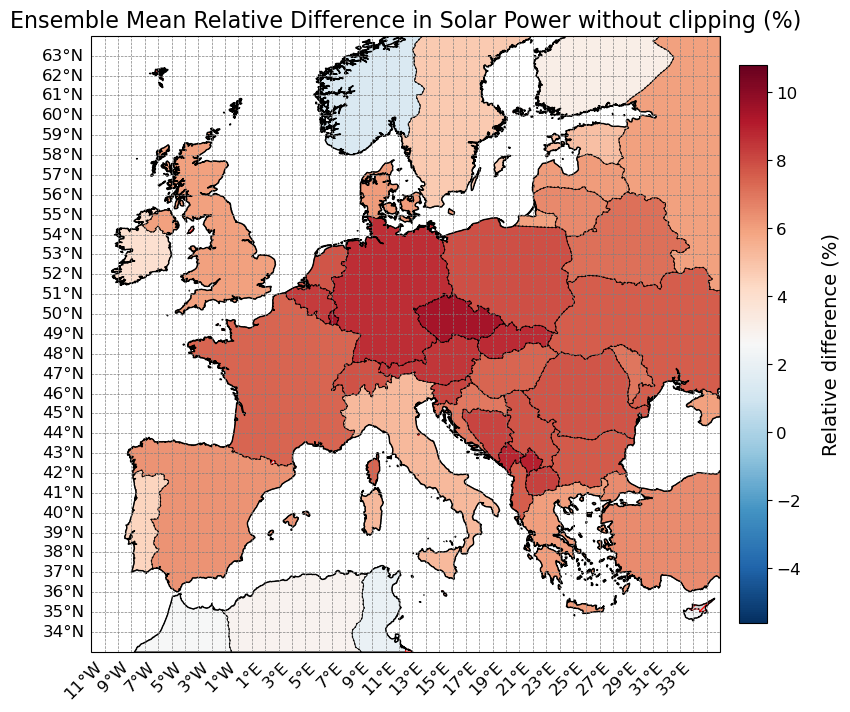

In [ ]:
from plots import country_plots
q05, q995 = np.nanpercentile(ensemble_grid.values.flatten(), [0.5, 99.5])
q0,q100 = np.nanpercentile(ensemble_grid.values, [0, 100])
vmin, vmax = q05,q995
country_plots(
    ensemble_grid,
    cmap='RdBu_r',
    vmin=vmin,
    vmax=vmax,
    title="Ensemble Mean Relative Difference in Solar Power without clipping (%)",
    label="Relative difference (%)",
    missing_frac_thresh=0.7
)


In [ ]:
models = ["ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2","HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"]  # Replace with actual model names
diri = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation/power/"

# Initialize vmin and vmax
vmin = float("inf")
vmax = float("-inf")

# Dictionary to store relative differences for each model
relative_differences = {}
all_relative_differences = []

# Loop through each model
for model in models:
    # Define paths for BOC and EOC
    path_BOC = os.path.join(diri, model+"_1x1grid/historical/")
    print(path_BOC)
    path_EOC = os.path.join(diri, model+"_1x1grid/ssp585/")
    
    # Load BOC files
    files_BOC = [f"{path_BOC}aggregated_solar_power_{year}.nc" for year in range(1980, 2015)]
    datasets_BOC = []
    for year, file in zip(range(1980, 2015), files_BOC):
        ds_BOC = xr.open_dataset(file, engine="netcdf4")
        ds_BOC = ds_BOC.expand_dims(time=[year])
        datasets_BOC.append(ds_BOC)
    combined_ds_BOC = xr.concat(datasets_BOC, dim="time")
    mean_power_BOC = combined_ds_BOC["specific generation"].mean(dim="time")
    
    # Load EOC files
    files_EOC = [f"{path_EOC}aggregated_solar_power_{year}.nc" for year in range(2065, 2100)]
    datasets_EOC = []
    for year, file in zip(range(2065, 2100), files_EOC):
        ds_EOC = xr.open_dataset(file)
        ds_EOC = ds_EOC.expand_dims(time=[year])
        datasets_EOC.append(ds_EOC)
    combined_ds_EOC = xr.concat(datasets_EOC, dim="time")
    mean_power_EOC = combined_ds_EOC["specific generation"].mean(dim="time")

In [5]:
import os
import xarray as xr
import geopandas as gpd
import pandas as pd
import numpy as np
from shapely.geometry import box
from scipy.stats import shapiro, ttest_ind

# -------------------------------------------------------------------------
# 1) CONFIGURATION
# -------------------------------------------------------------------------
DIRI = "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/power/"
models = [
    "ACCESS-CM2", "CanESM5", "CMCC-CM2-SR5", "CMCC-ESM2","HadGEM3-GC31-LL", "HadGEM3-GC31-MM", "MRI-ESM2-0"
]

# EU-27 plus all “extras” you want to include
EU27 = [
    'AT','BE','BG','HR','CZ','DK','EE','FI','FR','DE','GR',
    'HU','IE','IT','LV','LT','LU','MT','NL','PL','PT','RO',
    'SK','SI','ES','SE','CY'
]
extras = [
    'GB',  # United Kingdom
    'NO',  # Norway
    'BA',  # Bosnia & Herzegovina
    'ME',  # Montenegro
    'RS',  # Serbia
    'AL',  # Albania
    'MK',  # North Macedonia
    'CH',  # Switzerland
    'TR',  # Turkey
    'UA',  # Ukraine
    'BY',  # Belarus
    'MD',  # Moldova
    'RU',  # European Russia
    'XK'   # Kosovo (user-assigned)
]
region_codes = EU27 + extras

years_BOC = range(1980, 2015)   # 1980–2014
years_EOC = range(2065, 2100)   # 2065–2099
data_var  = 'specific generation'

# -------------------------------------------------------------------------
# 2) BUILD 1°×1° GRID-CELL POLYGONS
# -------------------------------------------------------------------------
sample_fp = os.path.join(
    DIRI,
    f"{models[0]}_1x1grid/historical/aggregated_solar_power_{years_BOC[0]}.nc"
)
ds_sample = xr.open_dataset(sample_fp, engine='netcdf4')
lats = ds_sample['lat'].values
lons = ds_sample['lon'].values
ds_sample.close()

dlat = float(np.diff(lats).mean())
dlon = float(np.diff(lons).mean())

cells = []
for lat in lats:
    for lon in lons:
        cells.append({
            'lon': float(lon),
            'lat': float(lat),
            'geometry': box(
                lon - dlon/2, lat - dlat/2,
                lon + dlon/2, lat + dlat/2
            )
        })
gdf_cells = gpd.GeoDataFrame(cells, crs="EPSG:4326")

# -------------------------------------------------------------------------
# 3) LOAD & FILTER COUNTRIES (EU27 + EXTRAS)
# -------------------------------------------------------------------------
ne50 = (
    "https://naturalearth.s3.amazonaws.com/50m_cultural/"
    "ne_50m_admin_0_countries.zip"
)
world = gpd.read_file(ne50).to_crs("EPSG:4326")
world.loc[world['NAME_LONG']=='France', 'ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway', 'ISO_A2'] = 'NO'

# 2) Assign Kosovo’s ISO if it exists by NAME_LONG or some other field
mask_kosovo = world['NAME_LONG'] == 'Kosovo'
if mask_kosovo.any():
    world.loc[mask_kosovo, 'ISO_A2'] = 'XK'
else:
    # if it wasn’t there at all, you could manually pull it from a 1:10m file or add it:
    kosovo = gpd.read_file("path/to/ne_10m_admin_0_countries.shp")
    kosovo = kosovo[kosovo['NAME_LONG']=='Kosovo'][['geometry']].copy()
    kosovo['ISO_A2'] = 'XK'
    world = pd.concat([world, kosovo], ignore_index=True)

# 3) Now filter your region of interest:
eu_plus = world[world['ISO_A2'].isin(region_codes)][['ISO_A2','geometry']].copy()

# -------------------------------------------------------------------------
# 4) INTERSECT & COMPUTE GRID-CELL WEIGHTS
# -------------------------------------------------------------------------
proj_crs = "EPSG:3035"
cells_pa = gdf_cells.to_crs(proj_crs)
cells_pa['cell_area'] = cells_pa.geometry.area
eu_pa = eu_plus.to_crs(proj_crs)

inter = gpd.overlay(cells_pa, eu_pa, how='intersection')
inter['overlap_area'] = inter.geometry.area
inter['weight'] = inter['overlap_area'] / inter['cell_area']
inter = inter[['lon','lat','ISO_A2','weight']].reset_index(drop=True)



In [5]:
from plots import map_plots

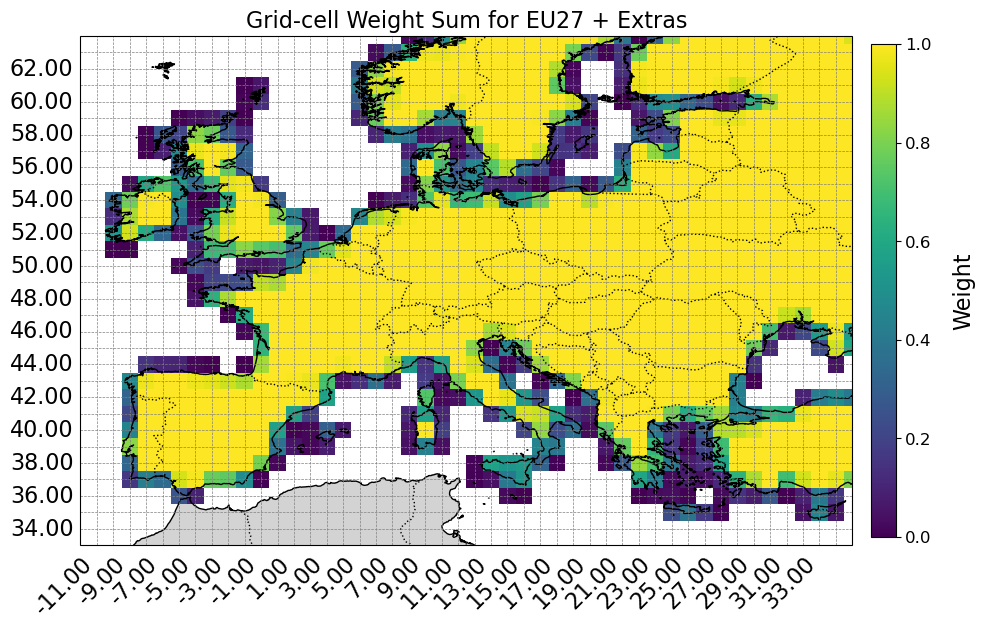

In [6]:
# group and sum weights across countries for each (lon,lat)
df_ws = (
    inter
    .groupby(['lon','lat'])['weight']
    .sum()
    .reset_index(name='total_weight')
)

# 2) Build a wide 2D weight array on your lon/lat grid
# -----------------------------------------------------------------------------
lons = np.array(sorted(gdf_cells['lon'].unique()))
lats = np.array(sorted(gdf_cells['lat'].unique()))

wt_mat = np.full((len(lats), len(lons)), np.nan)

# fill it in from the summed‐weights table
for lon, lat, w in zip(df_ws['lon'], df_ws['lat'], df_ws['total_weight']):
    i = np.searchsorted(lons, lon)
    j = np.searchsorted(lats, lat)
    wt_mat[j, i] = w

# 3) Wrap it up in an xarray.DataArray with dims x=lon, y=lat
# -----------------------------------------------------------------------------
weight_da = xr.DataArray(
    wt_mat,
    coords={'x': lons, 'y': lats},
    dims=('y', 'x'),
    name='cell_weight'
)

# 4) Call your plotting utility
# -----------------------------------------------------------------------------
map_plots(
    weight_da,
    cmap='viridis',
    setnan=True,      # hides the NaN (cells outside region)
    vmin=0.0,
    vmax=1.0,
    title='Grid‐cell Weight Sum for EU27 + Extras',
    label='Weight'
)


/tmp/ipykernel_31963/1627807203.py:26: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  full = eu_plus[eu_plus['ISO_A2']==iso].geometry.unary_union
/tmp/ipykernel_31963/1627807203.py:26: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  full = eu_plus[eu_plus['ISO_A2']==iso].geometry.unary_union
/tmp/ipykernel_31963/1627807203.py:26: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  full = eu_plus[eu_plus['ISO_A2']==iso].geometry.unary_union
/tmp/ipykernel_31963/1627807203.py:26: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  full = eu_plus[eu_plus['ISO_A2']==iso].geometry.unary_union
/tmp/ipykernel_31963/1627807203.py:26: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  full = eu_plus[eu_plus['ISO_A2']==iso].geometry.un

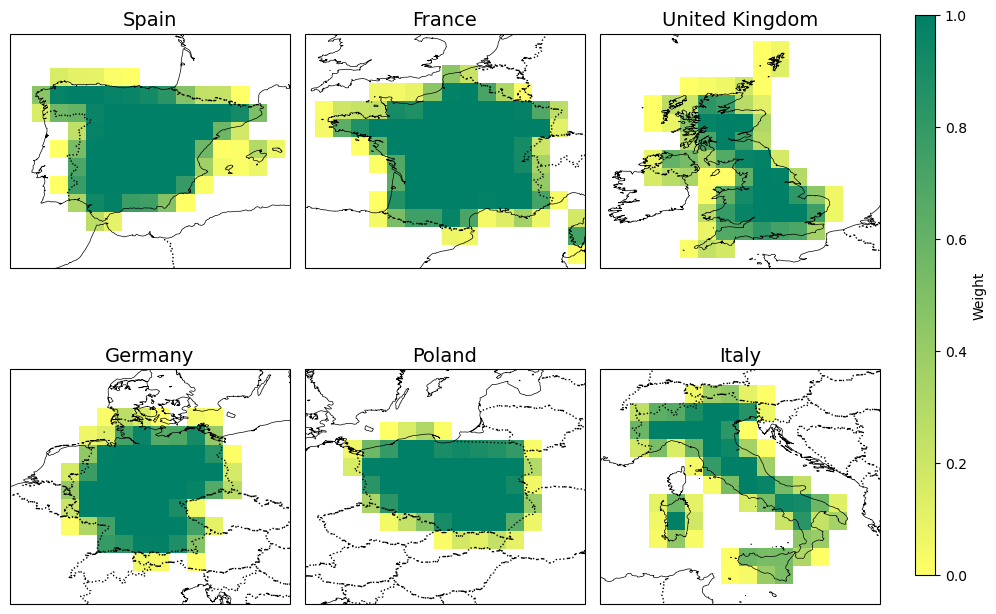

In [7]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# 1) Define your focus ISOs and precompute weight mats as before
focus = ['ES','FR','GB','DE','PL','IT']
lons = np.array(sorted(gdf_cells['lon'].unique()))
lats = np.array(sorted(gdf_cells['lat'].unique()))

weight_iso = {}
for iso in focus:
    df = inter[inter['ISO_A2']==iso]
    mat = np.full((len(lats), len(lons)), np.nan)
    for lon, lat, w in zip(df['lon'], df['lat'], df['weight']):
        i = np.searchsorted(lons, lon)
        j = np.searchsorted(lats, lat)
        mat[j, i] = w
    weight_iso[iso] = mat

# 2) Build “mainland” geometries and their raw bboxes
country_geoms = {}
bboxes = {}
for iso in focus:
    full = eu_plus[eu_plus['ISO_A2']==iso].geometry.unary_union
    if iso in ('ES','FR') and full.geom_type == 'MultiPolygon':
        main = max(full.geoms, key=lambda p: p.area)
        geom = main
    else:
        geom = full
    country_geoms[iso] = geom
    minx, miny, maxx, maxy = geom.bounds
    bboxes[iso] = (minx, miny, maxx, maxy)

# 3) Compute the max width & height across all countries
widths  = [bboxes[iso][2] - bboxes[iso][0] for iso in focus]
heights = [bboxes[iso][3] - bboxes[iso][1] for iso in focus]
maxW, maxH = max(widths), max(heights)

# add a small relative buffer (10%)
bufW, bufH = 0.1 * maxW, 0.1 * maxH

# 4) Create 2×3 panels, all with the SAME lon/lat span
fig, axes = plt.subplots(
    2, 3, figsize=(10, 8),
    subplot_kw={'projection': ccrs.PlateCarree()}
)

for ax, iso in zip(axes.flat, focus):
    # wrap weights into a DataArray for plotting
    da = xr.DataArray(
        weight_iso[iso],
        coords={'x': lons, 'y': lats},
        dims=('y','x')
    )

    # plot the cell‐weights
    pcm = ax.pcolormesh(
        lons, lats, da,
        cmap='summer_r', vmin=0, vmax=1,
        shading='auto',
        transform=ccrs.PlateCarree()
    )
    focus = ['ES','FR','GB','DE','PL','IT']
    country_names = ["Spain", "France", "United Kingdom", "Germany", "Poland", "Italy"]
    iso_to_name = dict(zip(focus, country_names))
    ax.coastlines('10m', linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.set_title(iso_to_name[iso], fontsize=14)

    # compute the *center* of this country’s bbox
    minx, miny, maxx, maxy = bboxes[iso]
    cx, cy = 0.5*(minx+maxx), 0.5*(miny+maxy)

    # set the *same* window size for every panel
    ax.set_extent(
        [cx - maxW/2 - bufW, cx + maxW/2 + bufW,
         cy - maxH/2 - bufH, cy + maxH/2 + bufH],
        crs=ccrs.PlateCarree()
    )

# shared colorbar
# collect all subplot axes
# shared colorbar on the right
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
fig.colorbar(pcm, cax=cbar_ax, label='Weight')
#fig.suptitle(
#    "Per-cell Weight for Selected Countries",
#    fontsize=16, y=0.85
#)
plt.tight_layout(rect=[0,0,0.9,0.94])
plt.show()


In [3]:
models   = ["ACCESS-CM2","CanESM5","CMCC-CM2-SR5","CMCC-ESM2",
            "HadGEM3-GC31-LL","HadGEM3-GC31-MM","MRI-ESM2-0"]

In [6]:
DIRI= "/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/power/"
years_BOC = range(1980, 2015)   # 1980–2014
years_EOC = range(2065, 2100)   # 2065–2099
data_var  = 'specific generation'
# -------------------------------------------------------------------------
# 5) HELPER: SUM-WEIGHTED AGGREGATION TO COUNTRY
# -------------------------------------------------------------------------
def country_aggregated(da, inter_gdf):
    df = da.to_dataframe(name='P').reset_index()  # lat, lon, P
    df = df.merge(inter_gdf, on=['lon','lat'], how='inner')
    df['contrib'] = df['P'] * df['weight']
    return df.groupby('ISO_A2')['contrib'].sum()

# -------------------------------------------------------------------------
# 6) LOOP MODELS & YEARS → RECORD PER-YEAR TOTALS
# -------------------------------------------------------------------------
records = []
for model in models:
    # BOC period
    boc_dir = os.path.join(DIRI, f"{model}_1x1grid/historical/")
    for yr in years_BOC:
        fp = os.path.join(boc_dir, f"aggregated_solar_power_{yr}.nc")
        ds = xr.open_dataset(fp, engine='netcdf4')
        da = ds[data_var]; ds.close()
        ct = country_aggregated(da, inter)
        for iso, val in ct.items():
            records.append({
                'model':  model,
                'period': 'BOC',
                'year':   yr,
                'ISO_A2': iso,
                'value':  float(val)
            })

    # EOC period
    eoc_dir = os.path.join(DIRI, f"{model}_1x1grid/ssp585/")
    for yr in years_EOC:
        fp = os.path.join(eoc_dir, f"aggregated_solar_power_{yr}.nc")
        ds = xr.open_dataset(fp, engine='netcdf4')
        da = ds[data_var]; ds.close()
        ct = country_aggregated(da, inter)
        for iso, val in ct.items():
            records.append({
                'model':  model,
                'period': 'EOC',
                'year':   yr,
                'ISO_A2': iso,
                'value':  float(val)
            })

df = pd.DataFrame.from_records(records)

# -------------------------------------------------------------------------
# 7a) PER-MODEL, PER-COUNTRY STATS (ALL region_codes)
# -------------------------------------------------------------------------
model_records = []
alpha = 0.05

for iso in region_codes:
    for model in models:
        boc_vals = df.query(
            "ISO_A2 == @iso and model == @model and period == 'BOC'"
        )['value'].values
        eoc_vals = df.query(
            "ISO_A2 == @iso and model == @model and period == 'EOC'"
        )['value'].values

        if len(boc_vals) < 3 or len(eoc_vals) < 3:
            continue

        # Shapiro–Wilk normality tests
        _, p_s_b = shapiro(boc_vals)
        _, p_s_e = shapiro(eoc_vals)
        # Welch’s t-test
        _, p_tt  = ttest_ind(eoc_vals, boc_vals, equal_var=False)

        m_b = np.median(boc_vals)
        m_e = np.median(eoc_vals)
        rel = (m_e - m_b) / m_b * 100

        model_records.append({
            'ISO_A2':        iso,
            'model':         model,
            'median_BOC':      m_b,
            'median_EOC':      m_e,
            'rel_change_%':  rel,
            'p_shapiro_BOC': p_s_b,
            'p_shapiro_EOC': p_s_e,
            'p_ttest':       p_tt,
            'signif_ttest':  (p_tt < alpha)
        })

model_stats_df = pd.DataFrame(model_records)
#model_stats_df.to_csv('solar_country_model_stats.csv', index=False)
#print("Wrote per-model stats to solar_country_model_stats.csv")


# -------------------------------------------------------------------------
# 7b) SUMMARY PER COUNTRY (ALL region_codes)
# -------------------------------------------------------------------------
summary = (
    model_stats_df
    .groupby('ISO_A2')
    .apply(lambda g: pd.Series({
        'n_models_tested':      len(g),
        'n_models_significant': int(g['signif_ttest'].sum()),
        'median_rel_change_sig':  float(g.loc[g['signif_ttest'], 'rel_change_%'].mean())
    }))
)

# Reindex to include every ISO in region_codes, even if missing
summary = summary.reindex(region_codes)

# For countries not present, set counts to zero (leave mean_rel_change_sig as NaN)
summary['n_models_tested'] = summary['n_models_tested'].fillna(0).astype(int)
summary['n_models_significant'] = summary['n_models_significant'].fillna(0).astype(int)

#summary.to_csv('solar_stats_per_model_summary.csv')
#print("Wrote country summary to solar_stats_per_model_summary.csv")
print(summary)

        n_models_tested  n_models_significant  median_rel_change_sig
ISO_A2                                                              
AT                    7                     6               9.430420
BE                    7                     7               8.424547
BG                    7                     7               7.797283
HR                    7                     6               8.169618
CZ                    7                     6              10.247218
DK                    7                     6               6.384509
EE                    7                     6               4.908968
FI                    7                     5               4.379582
FR                    7                     7               7.505847
DE                    7                     7               8.131509
GR                    7                     7               5.959716
HU                    7                     6               8.320033
IE                    7           

/tmp/ipykernel_116513/656475535.py:104: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda g: pd.Series({


In [33]:
target_iso = "FR"     # example: Austria
target_model = "HadGEM3-GC31-MM"  # example model

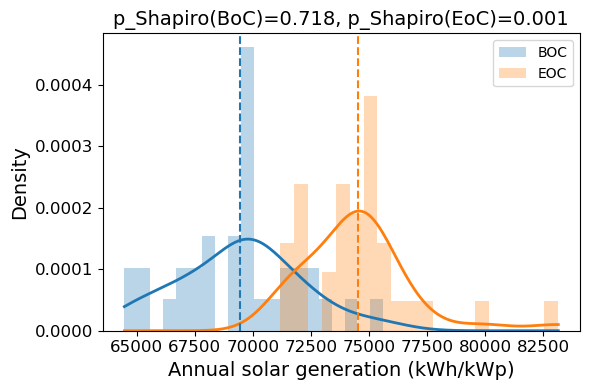

In [34]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# significance threshold
alpha = 0.05

# select only the “flagged” country-model combos
flagged = model_stats_df[
    (model_stats_df['signif_ttest'] == True) &
    (
        (model_stats_df['p_shapiro_BOC'] < alpha) |
        (model_stats_df['p_shapiro_EOC'] < alpha)
    )
]

boc_color = 'tab:blue'
eoc_color = 'tab:orange'

for _, row in flagged.iterrows():
    
    iso   = row['ISO_A2']
    model = row['model']
    if iso != target_iso or model != target_model:
        continue  # skip everything else
    
    # pull out the BOC/EOC time-series for this country+model
    boc_vals = df.loc[
        (df.ISO_A2  == iso) &
        (df.model   == model) &
        (df.period  == 'BOC'),
        'value'
    ].values
    eoc_vals = df.loc[
        (df.ISO_A2  == iso) &
        (df.model   == model) &
        (df.period  == 'EOC'),
        'value'
    ].values

    if boc_vals.size == 0 or eoc_vals.size == 0:
        continue

    # common support for KDE
    xs = np.linspace(
        min(boc_vals.min(), eoc_vals.min()),
        max(boc_vals.max(), eoc_vals.max()),
        300
    )
    kde_boc = gaussian_kde(boc_vals)
    kde_eoc = gaussian_kde(eoc_vals)

    plt.figure(figsize=(6, 4))
    # histograms
    plt.hist(boc_vals, bins=20, density=True,
             color=boc_color, alpha=0.3, label='BOC')
    plt.hist(eoc_vals, bins=20, density=True,
             color=eoc_color, alpha=0.3, label='EOC')
    # KDE curves
    plt.plot(xs, kde_boc(xs), color=boc_color, lw=2)
    plt.plot(xs, kde_eoc(xs), color=eoc_color, lw=2)
    # mean lines
    plt.axvline(boc_vals.mean(), color=boc_color,
                linestyle='--', lw=1.5)
    plt.axvline(eoc_vals.mean(), color=eoc_color,
                linestyle='--', lw=1.5)

    plt.title(
        #f'{iso} — {model}\n'
        f'p_Shapiro(BoC)={row["p_shapiro_BOC"]:.3f}, '
        f'p_Shapiro(EoC)={row["p_shapiro_EOC"]:.3f}', fontsize=14
    )
    plt.xlabel('Annual solar generation (kWh/kWp)', fontsize=14)
    plt.ylabel('Density', fontsize=14)
    plt.tick_params(axis='both', which='major', labelsize=12)  # <-- Add this line
    plt.legend()
    plt.tight_layout()
    plt.savefig(f"/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/{iso}_{model}_distribution.pdf",bbox_inches='tight', dpi=300)
    plt.show()


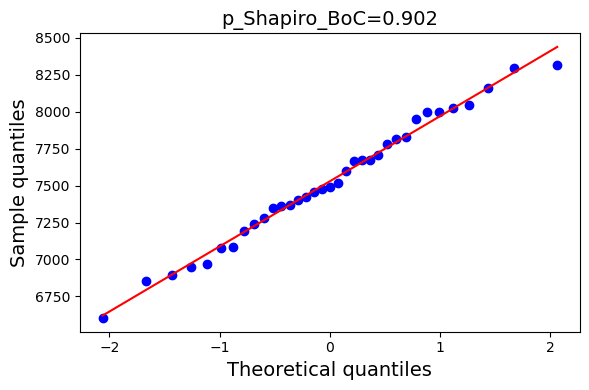

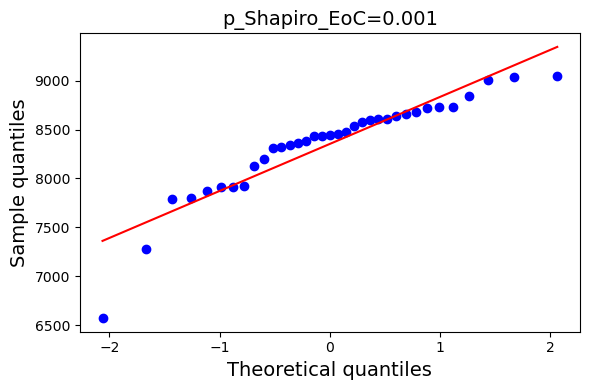

In [32]:
from scipy.stats import probplot
target_iso = "AT"     # example: Austria
target_model = "CMCC-CM2-SR5"  # example model

for _, row in flagged.iterrows():
    iso   = row['ISO_A2']
    model = row['model']

    if iso != target_iso or model != target_model:
        continue  # Skip other entries

    boc_vals = df.loc[
        (df.ISO_A2 == iso) & (df.model == model) & (df.period == 'BOC'),
        'value'
    ].values
    eoc_vals = df.loc[
        (df.ISO_A2 == iso) & (df.model == model) & (df.period == 'EOC'),
        'value'
    ].values

    if boc_vals.size == 0 or eoc_vals.size == 0:
        continue

    # ---- Q–Q plot for BOC ----
    plt.figure(figsize=(6, 4))
    probplot(boc_vals, dist="norm", plot=plt)
    plt.title(f'p_Shapiro_BoC={row["p_shapiro_BOC"]:.3f}', fontsize=14)
    plt.xlabel('Theoretical quantiles', fontsize=14)
    plt.ylabel('Sample quantiles', fontsize=14)
    plt.tight_layout()
    plt.savefig(f"/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/{iso}_{model}_QQ_BOC.pdf", bbox_inches='tight', dpi=300)
    plt.show()

    # ---- Q–Q plot for EOC ----
    plt.figure(figsize=(6, 4))
    probplot(eoc_vals, dist="norm", plot=plt)
    plt.title(f'p_Shapiro_EoC={row["p_shapiro_EOC"]:.3f}', fontsize=14)
    plt.xlabel('Theoretical quantiles', fontsize=14)
    plt.ylabel('Sample quantiles', fontsize=14)
    plt.tight_layout()
    plt.savefig(f"/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/{iso}_{model}_QQ_EOC.pdf", bbox_inches='tight', dpi=300)
    plt.show()
    
    break  # stop after this one if only one match is needed


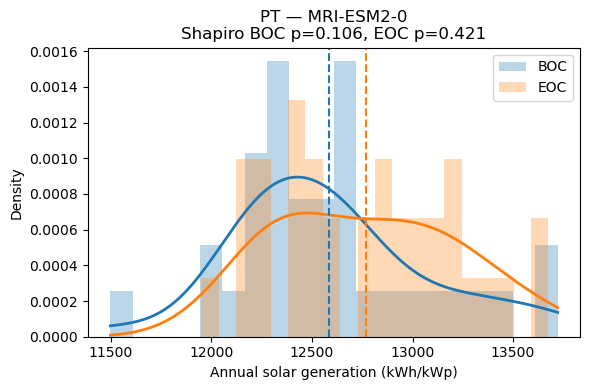

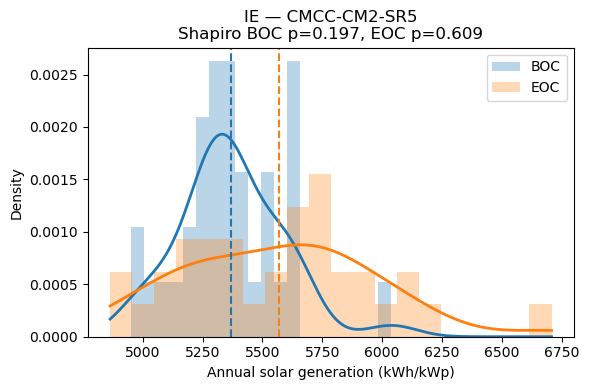

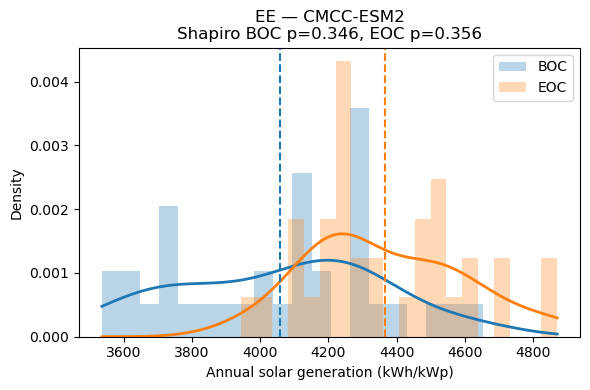

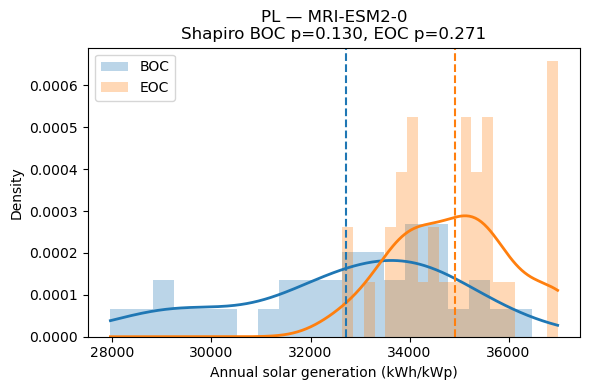

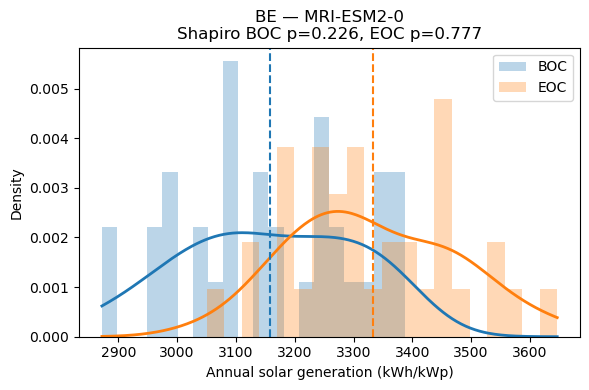

In [39]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

alpha = 0.05

# 1) Select “normal” cases: both Shapiro p-values ≥ 0.05
normal = model_stats_df[
    (model_stats_df['p_shapiro_BOC'] >= alpha) &
    (model_stats_df['p_shapiro_EOC'] >= alpha)
]

# 2) Randomly pick five distinct (ISO_A2,model) pairs
#    You can also pick the “first” five or choose by hand.
examples = normal.sample(n=5, random_state=0)[['ISO_A2','model']]

boc_color = 'tab:blue'
eoc_color = 'tab:orange'

for _, row in examples.iterrows():
    iso   = row['ISO_A2']
    model = row['model']

    # extract time-series for this pair
    boc_vals = df.loc[
        (df.ISO_A2 == iso) &
        (df.model  == model) &
        (df.period == 'BOC'),
        'value'
    ].values
    eoc_vals = df.loc[
        (df.ISO_A2 == iso) &
        (df.model  == model) &
        (df.period == 'EOC'),
        'value'
    ].values

    # build x-axis for KDE over the joint support
    xs = np.linspace(
        min(boc_vals.min(), eoc_vals.min()),
        max(boc_vals.max(), eoc_vals.max()),
        300
    )

    kde_boc = gaussian_kde(boc_vals)
    kde_eoc = gaussian_kde(eoc_vals)

    plt.figure(figsize=(6,4))
    # histograms
    plt.hist(boc_vals, bins=20, density=True,
             color=boc_color, alpha=0.3, label='BOC')
    plt.hist(eoc_vals, bins=20, density=True,
             color=eoc_color, alpha=0.3, label='EOC')
    # KDEs
    plt.plot(xs, kde_boc(xs), color=boc_color, lw=2)
    plt.plot(xs, kde_eoc(xs), color=eoc_color, lw=2)
    # mean lines
    plt.axvline(boc_vals.mean(), color=boc_color,
                linestyle='--', lw=1.5)
    plt.axvline(eoc_vals.mean(), color=eoc_color,
                linestyle='--', lw=1.5)

    plt.title(f'{iso} — {model}\n'
              f'Shapiro BOC p={model_stats_df.loc[(model_stats_df.ISO_A2==iso)&(model_stats_df.model==model),"p_shapiro_BOC"].values[0]:.3f}, '
              f'EOC p={model_stats_df.loc[(model_stats_df.ISO_A2==iso)&(model_stats_df.model==model),"p_shapiro_EOC"].values[0]:.3f}')
    plt.xlabel('Annual solar generation (kWh/kWp)')
    plt.ylabel('Density')
    plt.legend()
    plt.tight_layout()
    plt.show()


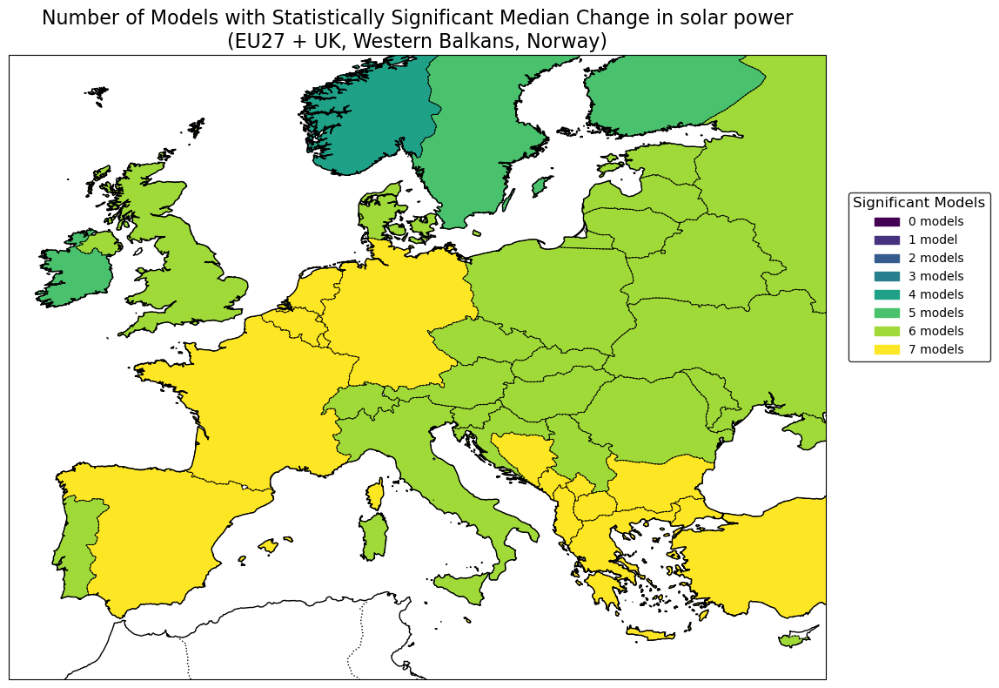

In [93]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd

# ─── 1) Load your per‐country summary ────────────────────────────────
summary = pd.read_csv('solar_stats_per_model_summary.csv')

# ─── 2) Define region codes (EU27 + extras) ─────────────────────────
EU27 = [
    'AT','BE','BG','HR','CZ','DK','EE','FI','FR','DE','GR',
    'HU','IE','IT','LV','LT','LU','MT','NL','PL','PT','RO',
    'SK','SI','ES','SE','CY'
]
extras = [
    'GB',  # United Kingdom
    'NO',  # Norway
    'BA',  # Bosnia & Herzegovina
    'ME',  # Montenegro
    'RS',  # Serbia
    'AL',  # Albania
    'MK',  # North Macedonia
    'CH',  # Switzerland
    'IS',  # Iceland
    'TR',  # Turkey
    'UA',  # Ukraine
    'BY',  # Belarus
    'MD',  # Moldova
    'RU',  # European Russia
    'XK'   # Kosovo (user-assigned)
]
region_codes = EU27 + extras

# ─── 3) Load Natural Earth & filter to our region ────────────────────
ne50 = "https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_countries.zip"
world = gpd.read_file(ne50).to_crs("EPSG:4326")

# Force France’s ISO_A2 to 'FR'
world.loc[world['NAME_LONG']=='France', 'ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway', 'ISO_A2'] = 'NO'
# Force Kosovo’s ISO_A2 to 'XK' (Natural Earth doesn't set this by default)
world.loc[world['NAME_LONG']=='Kosovo', 'ISO_A2'] = 'XK'

# Filter for EU27 + extras (now including XK)
eu = world[world['ISO_A2'].isin(region_codes)][['ISO_A2','geometry']].copy()

# ─── 4) Merge in the count of significant models ──────────────────────
eu = eu.merge(summary[['ISO_A2','n_models_significant']], on='ISO_A2', how='left')
eu['n_models_significant'] = eu['n_models_significant'].fillna(0).astype(int)

# ─── 5) Build a discrete viridis colormap ────────────────────────────
max_models = eu['n_models_significant'].max()  # should be ≤ len(models)
cmap = plt.get_cmap('viridis', max_models+1)

# ─── 6) Create the map with Cartopy ─────────────────────────────────
fig, ax = plt.subplots(
    figsize=(12, 8),
    subplot_kw={'projection': ccrs.PlateCarree()}
)

eu.plot(
    column='n_models_significant',
    cmap=cmap,
    linewidth=0.5,
    edgecolor='black',
    ax=ax,
    legend=False,
    missing_kwds={'color':'lightgrey'}
)

# overlay hatch on countries with < 5 significant models
#low = eu[eu['n_models_significant'] < 5]
#low.plot(
    #ax=ax,
    #facecolor="none",       # don’t fill—let the choropleth show through
    #edgecolor="black",      # draw country borders so hatch is clipped
    #hatch='///',            # or 'xxx', '...', whichever you like
    #linewidth=0.5,          # match the border width
    #zorder=3
#)


ax.coastlines('10m', linewidth=1)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.set_extent([-12, 35, 33, 64], crs=ccrs.PlateCarree())
ax.set_title(
    'Number of Models with Statistically Significant Median Change in solar power\n'
    '(EU27 + UK, Western Balkans, Norway)',
    fontsize=16
)

# ─── 7) Build a discrete legend ─────────────────────────────────────
patches = [
    mpatches.Patch(color=cmap(i), label=f"{i} model{'s' if i!=1 else ''}")
    for i in range(max_models+1)
]
ax.legend(
    handles=patches,
    title='Significant Models',
    loc='lower left',
    bbox_to_anchor=(1.02, 0.5),
    fontsize=10,
    title_fontsize=12,
    frameon=True,
    edgecolor='black'
)

plt.tight_layout()
plt.show()


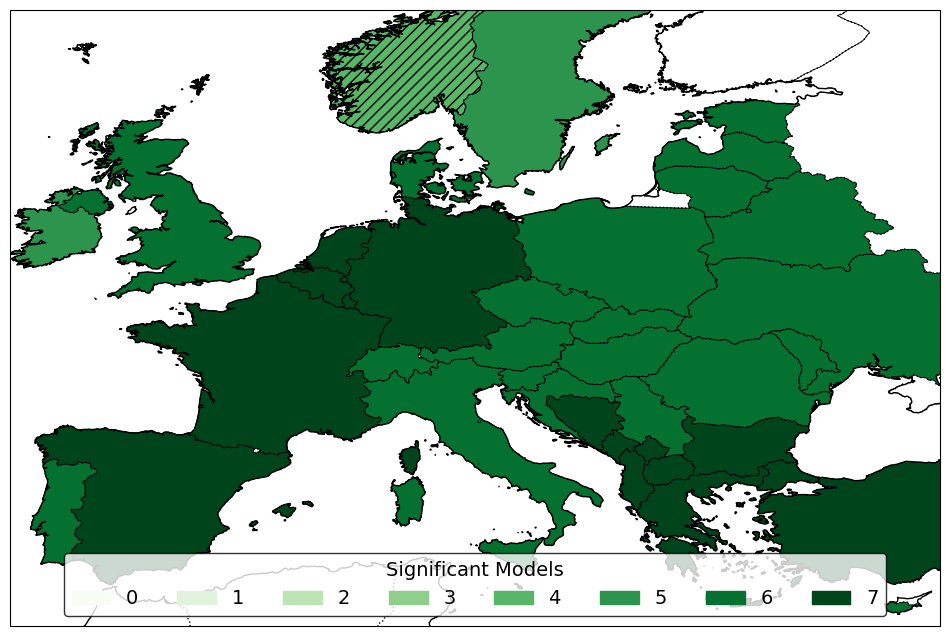

In [126]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd
import matplotlib as mpl
import numpy as np
import math

# ─── 1) Load your per‐country summary ────────────────────────────────
summary = pd.read_csv('solar_stats_per_model_summary.csv')

# ─── 2) Define region codes (EU27 + extras) ─────────────────────────
EU27 = [
    'AT','BE','BG','HR','CZ','DK','EE','FI','FR','DE','GR',
    'HU','IE','IT','LV','LT','LU','MT','NL','PL','PT','RO',
    'SK','SI','ES','SE','CY'
]
extras = [
    'GB',  # United Kingdom
    'NO',  # Norway
    'BA',  # Bosnia & Herzegovina
    'ME',  # Montenegro
    'RS',  # Serbia
    'AL',  # Albania
    'MK',  # North Macedonia
    'CH',  # Switzerland
    'IS',  # Iceland
    'TR',  # Turkey
    'UA',  # Ukraine
    'BY',  # Belarus
    'MD',  # Moldova
    'RU',  # European Russia
    'XK'   # Kosovo (user-assigned)
]
region_codes = EU27 + extras

# ─── 3) Load Natural Earth & filter to our region ────────────────────
ne50 = "https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_countries.zip"
world = gpd.read_file(ne50).to_crs("EPSG:4326")

# Force France’s ISO_A2 to 'FR'
world.loc[world['NAME_LONG']=='France', 'ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway', 'ISO_A2'] = 'NO'
# Force Kosovo’s ISO_A2 to 'XK' (Natural Earth doesn't set this by default)
world.loc[world['NAME_LONG']=='Kosovo', 'ISO_A2'] = 'XK'

# Filter for EU27 + extras (now including XK)
eu = world[world['ISO_A2'].isin(region_codes)][['ISO_A2','geometry']].copy()

# ─── 4) Merge in the count of significant models ──────────────────────
eu = eu.merge(summary[['ISO_A2','n_models_significant']], on='ISO_A2', how='left')
eu['n_models_significant'] = eu['n_models_significant'].fillna(0).astype(int)
eu.loc[eu['ISO_A2'].isin(['RU','FI']), 'n_models_significant'] = np.nan

# ─── 5) Build a discrete colormap ───────────────────────────────
max_models = int(eu['n_models_significant'].max(skipna=True))
cmap = plt.get_cmap('Greens', max_models+1)

# ─── 6) Create the map with Cartopy ─────────────────────────────────
fig, ax = plt.subplots(
    figsize=(12,8),  # Increased width for a wider map
    subplot_kw={'projection': ccrs.PlateCarree()}
)

eu.plot(
    column='n_models_significant',
    cmap=cmap,
    linewidth=0.5,
    edgecolor='black',
    ax=ax,
    legend=False,
    missing_kwds={'color':'white'}
)

# Overlay hatch on countries with < 5 significant models
low = eu[eu['n_models_significant'] < 5]
low.plot(
    ax=ax,
    facecolor="none",       # Don’t fill—let the choropleth show through
    edgecolor="black",      # Draw country borders so hatch is clipped
    hatch='///',            # Or 'xxx', '...', whichever you like
    linewidth=0.5,          # Match the border width
    zorder=3
)

ax.coastlines('10m', linewidth=1)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.set_extent([-10.5, 35, 34, 64], crs=ccrs.PlateCarree())  # Keep the extent unchanged

ax.set_aspect('auto')

# ─── 7) Build a discrete legend at the bottom overlapping the map ────────────────
patches = [
    mpatches.Patch(color=cmap(i), label=f"{i}")
    #mpatches.Patch(color=cmap(i), label=f"{i} Model{'s' if i!=1 else ''}")
    for i in range(max_models+1)
]

# Calculate number of columns to split legend into two rows
n_items = max_models + 1
ncols = math.ceil(n_items / 1)

leg = ax.legend(
    handles=patches,
    title='Significant Models',
    loc='lower center',
    bbox_to_anchor=(0.5, 0),  # Adjust the y value to overlap as needed
    fontsize=14,
    title_fontsize=14,
    frameon=True,
    edgecolor='black',
    ncol=ncols
)

# Optionally, adjust the legend's background transparency
leg.get_frame().set_alpha(0.8)

plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/mag_agree_yearly_change.pdf", bbox_inches='tight', dpi=300)
plt.show()

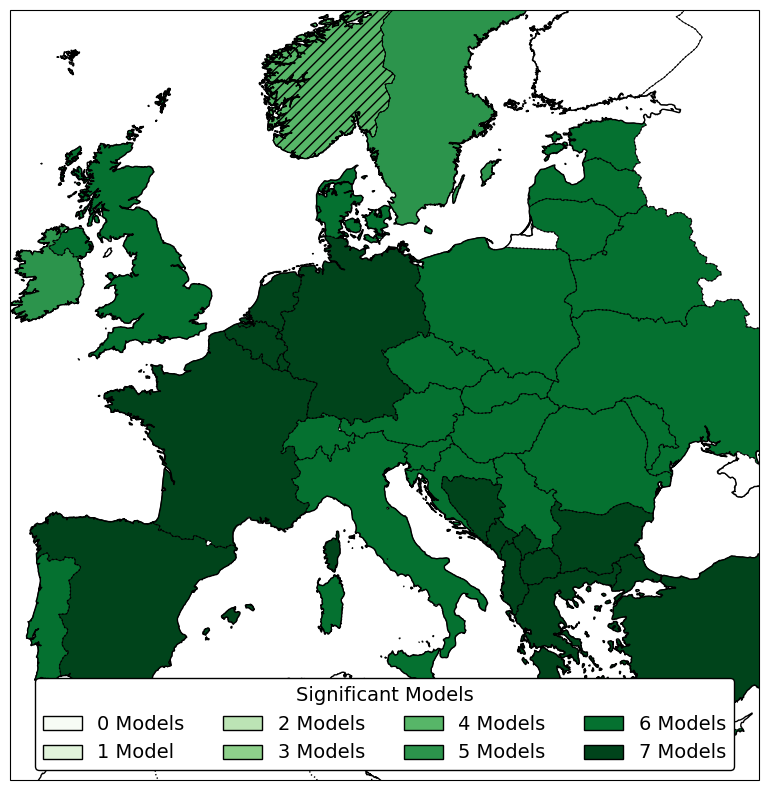

In [3]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd
import matplotlib as mpl
import numpy as np
import math

# ─── 1) Load your per‐country summary ────────────────────────────────
summary = pd.read_csv('solar_stats_per_model_summary.csv')

# ─── 2) Define region codes (EU27 + extras) ─────────────────────────
EU27 = [
    'AT','BE','BG','HR','CZ','DK','EE','FI','FR','DE','GR',
    'HU','IE','IT','LV','LT','LU','MT','NL','PL','PT','RO',
    'SK','SI','ES','SE','CY'
]
extras = [
    'GB',  # United Kingdom
    'NO',  # Norway
    'BA',  # Bosnia & Herzegovina
    'ME',  # Montenegro
    'RS',  # Serbia
    'AL',  # Albania
    'MK',  # North Macedonia
    'CH',  # Switzerland
    'IS',  # Iceland
    'TR',  # Turkey
    'UA',  # Ukraine
    'BY',  # Belarus
    'MD',  # Moldova
    'RU',  # European Russia
    'XK'   # Kosovo (user-assigned)
]
region_codes = EU27 + extras

# ─── 3) Load Natural Earth & filter to our region ────────────────────
ne50 = "https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_countries.zip"
world = gpd.read_file(ne50).to_crs("EPSG:4326")

# Force France’s ISO_A2 to 'FR'
world.loc[world['NAME_LONG']=='France', 'ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway', 'ISO_A2'] = 'NO'
# Force Kosovo’s ISO_A2 to 'XK' (Natural Earth doesn't set this by default)
world.loc[world['NAME_LONG']=='Kosovo', 'ISO_A2'] = 'XK'

# Filter for EU27 + extras (now including XK)
eu = world[world['ISO_A2'].isin(region_codes)][['ISO_A2','geometry']].copy()

# ─── 4) Merge in the count of significant models ──────────────────────
eu = eu.merge(summary[['ISO_A2','n_models_significant']], on='ISO_A2', how='left')
eu['n_models_significant'] = eu['n_models_significant'].fillna(0).astype(int)
eu.loc[eu['ISO_A2'].isin(['RU','FI']), 'n_models_significant'] = np.nan

# ─── 5) Build a discrete colormap ───────────────────────────────
max_models = int(eu['n_models_significant'].max(skipna=True))
cmap = plt.get_cmap('Greens', max_models+1)

# ─── 6) Create the map with Cartopy ─────────────────────────────────
fig, ax = plt.subplots(
    figsize=(12,8),  # Increased width for a wider map
    subplot_kw={'projection': ccrs.PlateCarree()}
)

eu.plot(
    column='n_models_significant',
    cmap=cmap,
    linewidth=0.5,
    edgecolor='black',
    ax=ax,
    legend=False,
    missing_kwds={'color':'white'}
)

# Overlay hatch on countries with < 5 significant models
low = eu[eu['n_models_significant'] < 5]
low.plot(
    ax=ax,
    facecolor="none",       # Don’t fill—let the choropleth show through
    edgecolor="black",      # Draw country borders so hatch is clipped
    hatch='///',            # Or 'xxx', '...', whichever you like
    linewidth=0.5,          # Match the border width
    zorder=3
)

ax.coastlines('10m', linewidth=1)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.set_extent([-10.5, 35, 33, 64], crs=ccrs.PlateCarree())  # Keep the extent unchanged

lat0 = (33 + 64) / 2.0
ax.set_aspect(1.0 / np.cos(np.deg2rad(lat0)))

# ─── 7) Build a discrete legend at the bottom overlapping the map ────────────────
patches = [
    mpatches.Patch(
        facecolor=cmap(i),
        edgecolor='black',
        linewidth=1,
        label=f"{i} Model{'s' if i!=1 else ''}"
    )
    for i in range(max_models+1)
]

# Calculate number of columns to split legend into two rows
n_items = max_models + 1
ncols = math.ceil(n_items / 2)

leg = ax.legend(
    handles=patches,
    title='Significant Models',
    loc='lower center',
    bbox_to_anchor=(0.5, 0),  # Adjust the y value to overlap as needed
    fontsize=14,
    title_fontsize=14,
    frameon=True,
    edgecolor='black',
    ncol=ncols
)

# Optionally, adjust the legend's background transparency
leg.get_frame().set_alpha(1)
plt.tight_layout()

#plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/mag_agree_yearly_change.pdf", bbox_inches='tight', dpi=300)
plt.show()

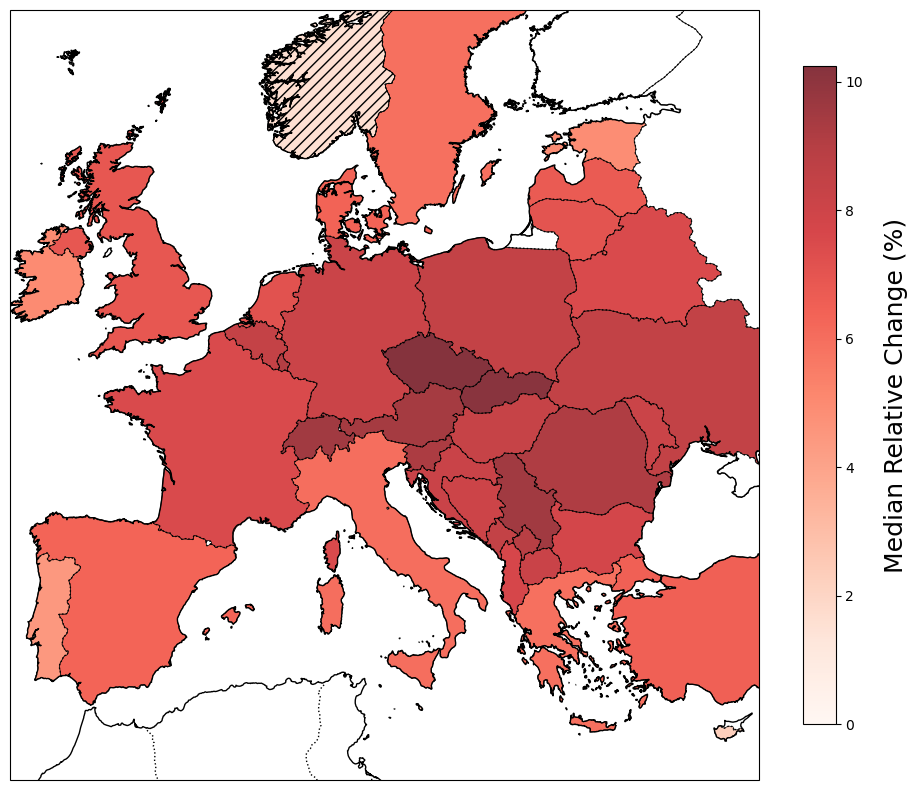

In [4]:
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd
import matplotlib as mpl

# 1) Load your per‐country summary
summary = pd.read_csv('solar_stats_per_model_summary.csv')

# 2) Define region codes
EU27   = ['AT','BE','BG','HR','CZ','DK','EE','FI','FR','DE','GR',
          'HU','IE','IT','LV','LT','LU','MT','NL','PL','PT','RO',
          'SK','SI','ES','SE','CY']
extras = ['GB','NO','BA','ME','RS','AL','MK','CH','IS','TR','UA','BY','MD','RU','XK']
region_codes = EU27 + extras

# 3) Load Natural Earth & fix ISOs
ne50  = "https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_countries.zip"
world = gpd.read_file(ne50).to_crs("EPSG:4326")
world.loc[world['NAME_LONG']=='France', 'ISO_A2'] = 'FR'
world.loc[world['NAME_LONG']=='Norway', 'ISO_A2'] = 'NO'
world.loc[world['NAME_LONG'].str.contains('Kosov', na=False), 'ISO_A2'] = 'XK'

eu = world[world['ISO_A2'].isin(region_codes)][['ISO_A2','geometry']].copy()

eu_sign=eu.merge(
    summary[['ISO_A2','n_models_significant']],
    on='ISO_A2', how='left'
)
eu_sign['n_models_significant'] = eu_sign['n_models_significant'].fillna(0).astype(int)

# 4) Merge in the mean‐relative‐change (floats!)
eu = eu.merge(summary[['ISO_A2','median_rel_change_sig']],
              on='ISO_A2', how='left')
eu['median_rel_change_sig'] = eu['median_rel_change_sig'].fillna(0)

eu.loc[eu['ISO_A2'].isin(['RU','FI']), 'median_rel_change_sig'] = np.nan

# 5) Set up norm and cmap
vmin = eu['median_rel_change_sig'].min()
vmax = eu['median_rel_change_sig'].max()
norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
# Create a slightly darker version of the 'Greens' colormap
from matplotlib.colors import LinearSegmentedColormap
original_cmap = plt.get_cmap('Reds')  # Use the 'Greens' colormap
colors = original_cmap(np.linspace(0, 1, 256))  # Extract the colors
lighter_colors = (1 - 0.2) * colors + 0.2  # Blend with white (adjust 0.3 for more/less lightness)
lighter_cmap = LinearSegmentedColormap.from_list('LighterGreens', lighter_colors)  # Create the lighter colormap

# Use the lighter colormap
cmap = lighter_cmap
#cmap = plt.get_cmap('Reds')

# 6) Plot
fig, ax = plt.subplots(
    figsize=(12, 8),
    subplot_kw={'projection': ccrs.PlateCarree()}
)


eu.plot(
    column='median_rel_change_sig',
    cmap=cmap,
    norm=norm,
    linewidth=0.5,
    edgecolor='black',
    ax=ax,
    legend=False,
    missing_kwds={'color':'white'}
)
# Overlay hatch on countries with < 5 significant models
low = eu_sign[eu_sign['n_models_significant'] < 5]
low.plot(
    ax=ax,
    facecolor="none",       # Don’t fill—let the choropleth show through
    edgecolor="black",      # Draw country borders so hatch is clipped
    hatch='///',            # Or 'xxx', '...', whichever you like
    linewidth=0.5,          # Match the border width
    zorder=3
)

ax.coastlines('10m', linewidth=1)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.set_extent([-10.5, 35, 33, 64], crs=ccrs.PlateCarree())

lat0 = (33 + 64) / 2.0
ax.set_aspect(1.0 / np.cos(np.deg2rad(lat0)))

# 7) Add the lateral colorbar
sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
sm._A = []  # no data array needed
cbar = fig.colorbar(
    sm, ax=ax,
    fraction=0.03, pad=0.04  # adjust pad to move it farther right
)
cbar.set_label('Median Relative Change (%)', rotation=90, labelpad=15, fontsize=18)
cbar.ax.tick_params(labelsize=10)

plt.tight_layout()
#plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/yearly_change_per_country.pdf", bbox_inches='tight', dpi=300)
plt.show()


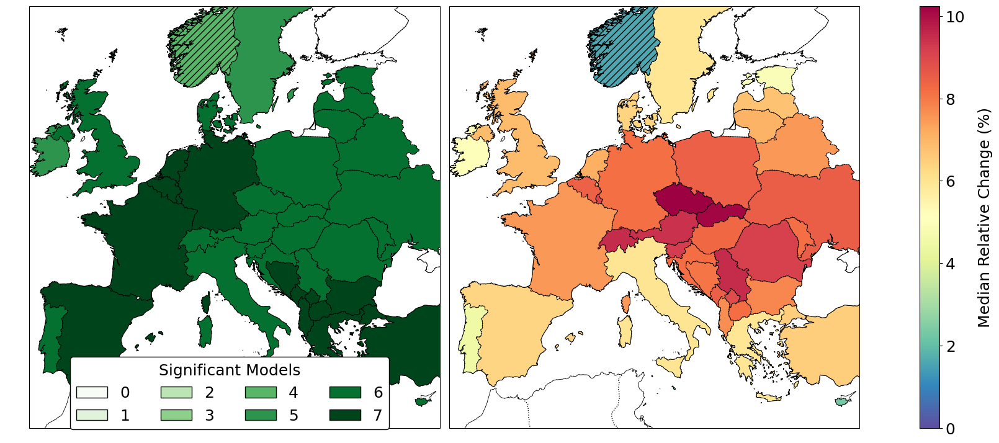

In [19]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd
import numpy as np
import matplotlib as mpl
from matplotlib.colors import LinearSegmentedColormap

# ─── Data prep ─────────────────────────────────────────────────────────────
summary = pd.read_csv('solar_stats_per_model_summary.csv')

EU27   = ['AT','BE','BG','HR','CZ','DK','EE','FI','FR','DE','GR',
          'HU','IE','IT','LV','LT','LU','MT','NL','PL','PT','RO',
          'SK','SI','ES','SE','CY']
extras = ['GB','NO','BA','ME','RS','AL','MK','CH','IS','TR','UA','BY','MD','RU','XK']
region_codes = EU27 + extras

world = gpd.read_file(
    "https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_countries.zip"
).to_crs("EPSG:4326")

# fix a few ISO codes
world.loc[world.NAME_LONG=='France','ISO_A2'] = 'FR'
world.loc[world.NAME_LONG=='Norway','ISO_A2'] = 'NO'
world.loc[world.NAME_LONG.str.contains('Kosov', na=False),'ISO_A2'] = 'XK'

base = world[world.ISO_A2.isin(region_codes)][['ISO_A2','geometry']]

# ─── Count of significant models (discrete) ────────────────────────────────
eu_count = base.merge(summary[['ISO_A2','n_models_significant']],
                      on='ISO_A2', how='left')
eu_count['n_models_significant'] = eu_count.n_models_significant.fillna(0).astype(int)
# make RU & FI missing
eu_count.loc[eu_count.ISO_A2.isin(['RU','FI']),'n_models_significant'] = np.nan

max_models = int(eu_count.n_models_significant.max(skipna=True))
cmap_count = plt.get_cmap('Greens', max_models+1)

# ─── Median relative change (continuous) ──────────────────────────────────
eu_change = base.merge(summary[['ISO_A2','median_rel_change_sig']],
                       on='ISO_A2', how='left')
eu_change['median_rel_change_sig'] = eu_change.median_rel_change_sig.fillna(0)
eu_change.loc[eu_change.ISO_A2.isin(['RU','FI']),'median_rel_change_sig'] = np.nan

vmin = eu_change.median_rel_change_sig.min()
vmax = eu_change.median_rel_change_sig.max()
norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
# lighter Reds
base_c = plt.get_cmap('Reds')(np.linspace(0,1,256))
lighter = 0.8*base_c + 0.2
cmap_change = LinearSegmentedColormap.from_list('lighterReds', lighter)
cmap="Spectral_r"

# ─── Build the figure & axes ──────────────────────────────────────────────
fig = plt.figure(figsize=(16,8))
# after creating all your axes, but before saving/showing:



# Left map (discrete)
ax1 = fig.add_axes([0.05, 0.10, 0.46, 0.85], projection=ccrs.PlateCarree())
eu_count.plot(
    column='n_models_significant',
    cmap=cmap_count,
    linewidth=0.5, edgecolor='black',
    ax=ax1, legend=False,
    missing_kwds={'color':'white'}
)
# hatch
eu_count[eu_count.n_models_significant < 5].plot(
    ax=ax1, facecolor='none', edgecolor='black',
    hatch='///', linewidth=0.5, zorder=3
)
ax1.coastlines('10m', linewidth=0.6)
ax1.add_feature(cfeature.BORDERS, linestyle=':')
ax1.set_extent([-10.5, 35, 33, 64], ccrs.PlateCarree())
lat0 = (33+64)/2
ax1.set_aspect(1/np.cos(np.deg2rad(lat0)))
#ax1.set_title('(a) Model agreement', fontsize=16)

# Right map (continuous)
ax2 = fig.add_axes([0.52-0.047, 0.10, 0.46, 0.85], projection=ccrs.PlateCarree())
eu_change.plot(
    column='median_rel_change_sig',
    cmap=cmap, norm=norm,
    linewidth=0.5, edgecolor='black',
    ax=ax2, legend=False,
    missing_kwds={'color':'white'}
)
# same hatch
eu_count[eu_count.n_models_significant < 5].plot(
    ax=ax2, facecolor='none', edgecolor='black',
    hatch='///', linewidth=0.5, zorder=3
)
ax2.coastlines('10m', linewidth=0.6)
ax2.add_feature(cfeature.BORDERS, linestyle=':')
ax2.set_extent([-10.5, 35, 33, 64], ccrs.PlateCarree())
ax2.set_aspect(1/np.cos(np.deg2rad(lat0)))
#ax2.set_title('(b) Median change', fontsize=16)

# ─── Discrete legend under left map ───────────────────────────────────────
leg_ax = fig.add_axes([0.05, 0.15, 0.45, 0.04])
leg_ax.axis('off')
patches = [
    mpatches.Patch(
        facecolor=cmap_count(i), edgecolor='black',
        label=f"{i}"
        # Model{'s' if i!=1 else ''}
    ) for i in range(max_models+1)
]
ncols = int(np.ceil((max_models+1)/2))
leg_ax.legend(
    handles=patches, title='Significant Models',
    ncol=ncols, loc='center',
    fontsize=18, title_fontsize=18,
    frameon=True, edgecolor='black', framealpha = 1
)
leg.get_frame().set_alpha(1) 

# ─── Continuous colorbar to right of right map ───────────────────────────
cax = fig.add_axes([0.97, 0.10, 0.02, 0.85])
sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
sm._A = []
cb = fig.colorbar(sm, cax=cax)
cb.set_label('Median Relative Change (%)', rotation=90, labelpad=15, fontsize=18)
cb.ax.tick_params(labelsize=18)
#fig.subplots_adjust(left=0.05, right=0.97, top=0.95, bottom=0.10, wspace=0.01)

plt.savefig("/work/users/s233224/Climate-Change-Impacted-Solar-Energy-Generation-backup/figures/yearly_country_conc.pdf", bbox_inches='tight', dpi=300)
plt.show()


NameError: name 'eu' is not defined

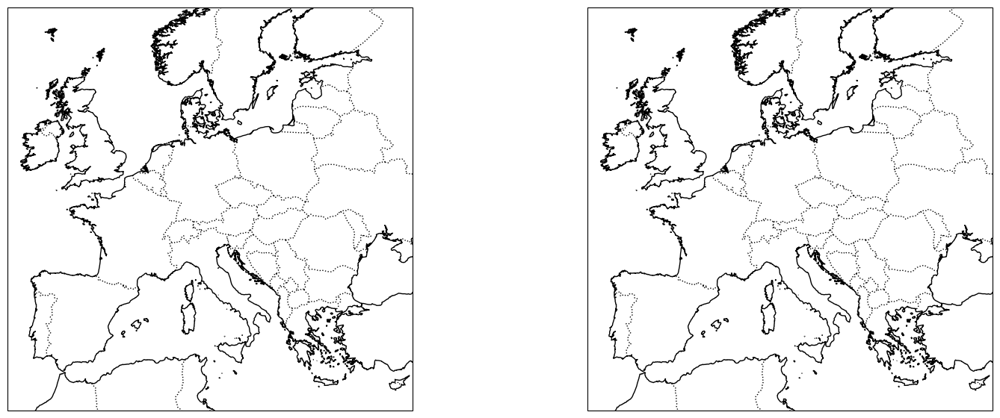

In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import math

# ─── assume you already have these defined ──────────────────────────────
# eu             : your GeoDataFrame
# max_models     : int maximum of n_models_significant
# cmap, norm     : for the continuous color mapping
# ────────────────────────────────────────────────────────────────────────

fig = plt.figure(figsize=(16, 6))  # make it wider but a bit shorter

# left map occupies x=[0.02–0.495], y=[0.05–0.95]
ax1 = fig.add_axes([0.02, 0.05, 0.475, 0.90], projection=ccrs.PlateCarree())
# right map occupies x=[0.505–0.98], same height
ax2 = fig.add_axes([0.505, 0.05, 0.475, 0.90], projection=ccrs.PlateCarree())

for ax in (ax1, ax2):
    ax.set_extent([-12, 35, 33, 64], crs=ccrs.PlateCarree())
    ax.coastlines('10m', linewidth=1)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    lat0 = (33 + 64) / 2.0
    ax.set_aspect(1.0 / np.cos(np.deg2rad(lat0)))
    ax.set_frame_on(True)
    ax.tick_params(left=False, right=False, labelleft=False,
                   top=False, bottom=False, labelbottom=False)

# ─── Left panel: discrete count ────────────────────────────────────────
eu.plot(
    'n_models_significant',
    cmap=plt.get_cmap('Greens', max_models+1),
    linewidth=0.4,
    edgecolor='black',
    ax=ax1,
    legend=False,
    missing_kwds={'color':'white'}
)
eu[eu['n_models_significant'] < 5].plot(
    ax=ax1, facecolor='none', edgecolor='black',
    hatch='///', linewidth=0.4, zorder=3
)
ax1.set_title('Count of Significant Models', pad=6, fontsize=14)

patches = [
    mpatches.Patch(facecolor=plt.get_cmap('Greens', max_models+1)(i),
                   edgecolor='black', label=str(i))
    for i in range(max_models+1)
]
ax1.legend(
    handles=patches,
    title='# Sig. Models',
    loc='lower right',
    fontsize=10,
    title_fontsize=11,
    frameon=True,
    framealpha=0.6
)

# ─── Right panel: continuous difference ───────────────────────────────
sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
sm._A = []

eu.plot(
    'median_drought_diff',
    cmap=cmap, norm=norm,
    linewidth=0.4, edgecolor='black',
    ax=ax2, legend=False,
    missing_kwds={'color':'lightgrey'}
)
eu[eu['n_models_significant'] < 5].plot(
    ax=ax2, facecolor='none', edgecolor='black',
    hatch='///', linewidth=0.4, zorder=3
)
ax2.set_title('Median Drought-Day Difference', pad=6, fontsize=14)

# inset colorbar inside ax2
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
cax = inset_axes(ax2,
                 width="4%",   # thinner bar
                 height="40%", # shorter bar
                 loc='lower right',
                 bbox_to_anchor=(0, 0.12, 1, 1),
                 bbox_transform=ax2.transAxes,
                 borderpad=0)
cbar = fig.colorbar(sm, cax=cax, orientation='vertical')
cbar.ax.tick_params(labelsize=10)
cbar.set_label('Median Δ Drought Days', fontsize=11, labelpad=4)

plt.show()


/tmp/ipykernel_25953/2952604834.py:75: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax2.legend(title="Model", loc="upper left", bbox_to_anchor=(1.02,1), frameon=False)


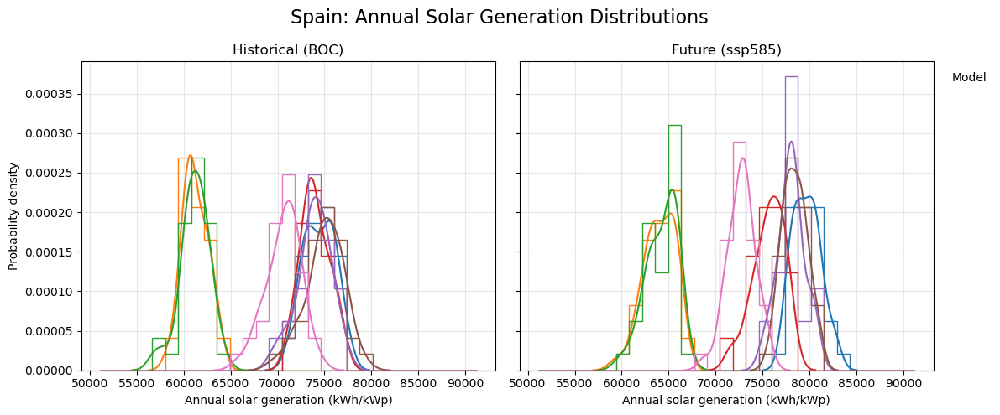

/tmp/ipykernel_25953/2952604834.py:75: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax2.legend(title="Model", loc="upper left", bbox_to_anchor=(1.02,1), frameon=False)


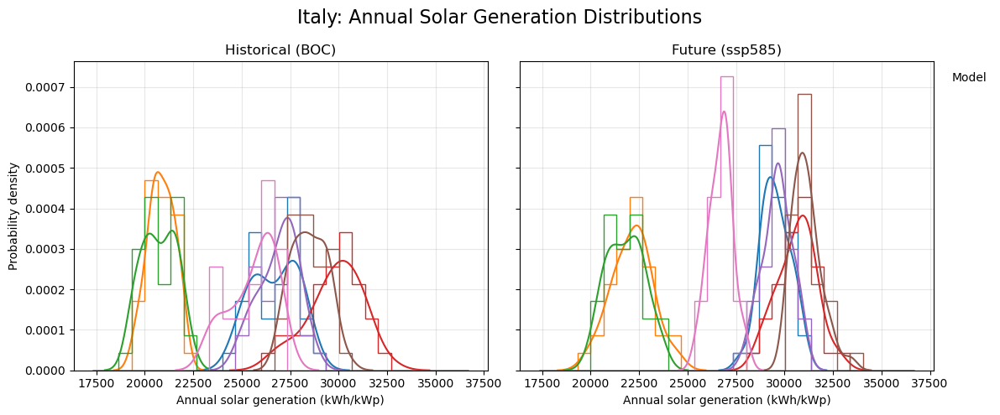

/tmp/ipykernel_25953/2952604834.py:75: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax2.legend(title="Model", loc="upper left", bbox_to_anchor=(1.02,1), frameon=False)


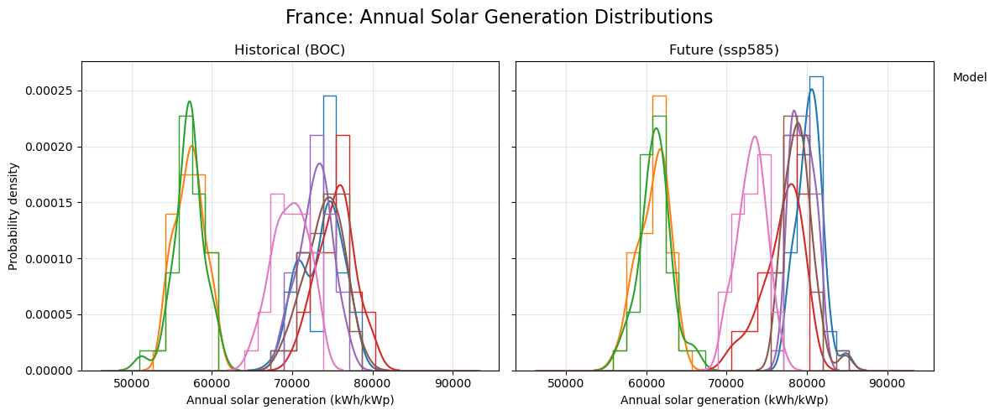

/tmp/ipykernel_25953/2952604834.py:75: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax2.legend(title="Model", loc="upper left", bbox_to_anchor=(1.02,1), frameon=False)


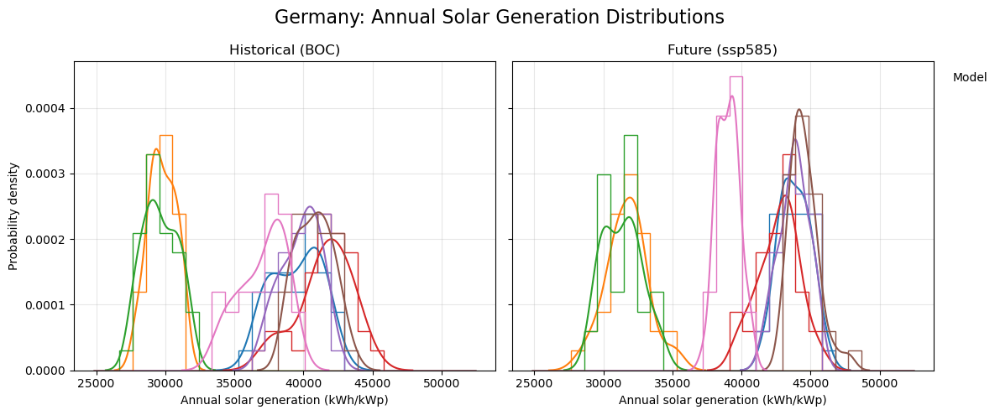

/tmp/ipykernel_25953/2952604834.py:75: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax2.legend(title="Model", loc="upper left", bbox_to_anchor=(1.02,1), frameon=False)


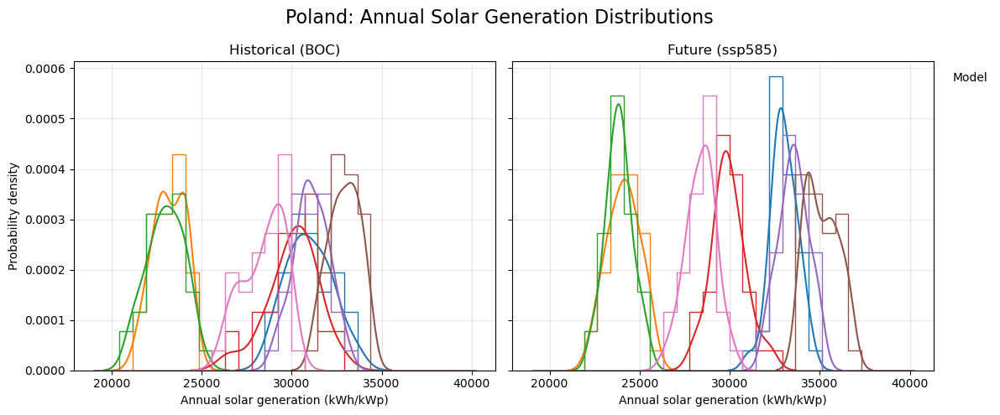

/tmp/ipykernel_25953/2952604834.py:75: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax2.legend(title="Model", loc="upper left", bbox_to_anchor=(1.02,1), frameon=False)


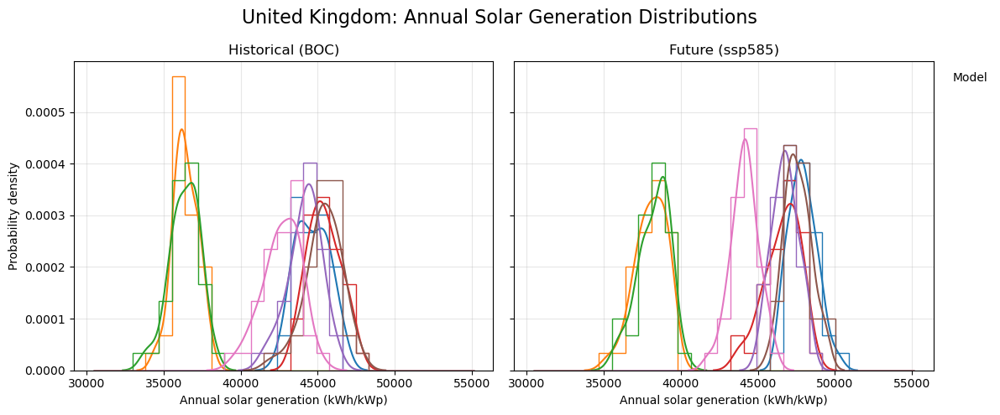

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pycountry
import numpy as np

# ─── 1) load the full yearly country‐level CSV ─────────────────────────────
# this should be the per-year, per-model, per-country file you wrote earlier
df = pd.read_csv("country_level_yearly_solar_power.csv")

# rename columns to match your solar_country_model_stats style
df = df.rename(columns={"ADM0_A3":"ISO3", "specific generation":"power"})

# map ISO3 → ISO2 so we can join to your existing code
# (pycountry only gives alpha_2→alpha_3, so invert that dict)
iso2_to_iso3 = {c.alpha_2:c.alpha_3 for c in pycountry.countries}
iso3_to_iso2 = {v:k for k,v in iso2_to_iso3.items()}

df["ISO_A2"] = df["ISO3"].map(iso3_to_iso2)

# ─── 2) pick your six countries & filter ────────────────────────────────────
selected_iso2 = ["ES","IT","FR","DE","PL","GB"]  # Spain, Italy, France, Germany, Poland, UK
df = df[df.ISO_A2.isin(selected_iso2)].copy()

# build a nice map to full names
iso2_to_name = {c.alpha_2:c.name for c in pycountry.countries}
iso2_to_name["GB"] = "United Kingdom"  # pycountry gives "United Kingdom of Great Britain...", shorten it

# ─── 3) loop over countries & plot ─────────────────────────────────────────
for iso2 in selected_iso2:
    country_name = iso2_to_name[iso2]
    df_ct = df[df["ISO_A2"] == iso2]

    # split into the two periods
    boc = df_ct[df_ct["period"]=="historical"]
    eoc = df_ct[df_ct["period"]=="ssp585"]

    models = sorted(df_ct["model"].unique())
    nmodels = len(models)
    palette = sns.color_palette("tab10", nmodels)
    model_colors = dict(zip(models, palette))

    # choose common bins
    all_p = pd.concat([boc["power"], eoc["power"]])
    bins = np.linspace(all_p.min()*0.9, all_p.max()*1.1, 30)

    fig, (ax1, ax2) = plt.subplots(1,2, figsize=(12,5), sharey=True,
                                   gridspec_kw={"width_ratios":[1,1]})
    fig.suptitle(f"{country_name}: Annual Solar Generation Distributions", fontsize=16)

    # left panel = BOC
    for m in models:
        vals = boc[boc["model"]==m]["power"]
        ax1.hist(vals, bins=bins, density=True,
                 histtype="step", lw=1.5, color=model_colors[m], label=m)
        sns.kdeplot(vals, ax=ax1, color=model_colors[m], lw=1.5)

    ax1.set_title("Historical (BOC)")
    ax1.set_xlabel("Annual solar generation (kWh/kWp)")
    ax1.set_ylabel("Probability density")
    ax1.grid(alpha=0.3)

    # right panel = EOC
    for m in models:
        vals = eoc[eoc["model"]==m]["power"]
        ax2.hist(vals, bins=bins, density=True,
                 histtype="step", lw=1.5, color=model_colors[m])
        sns.kdeplot(vals, ax=ax2, color=model_colors[m], lw=1.5)

    ax2.set_title("Future (ssp585)")
    ax2.set_xlabel("Annual solar generation (kWh/kWp)")
    ax2.grid(alpha=0.3)

    # legend on right
    ax2.legend(title="Model", loc="upper left", bbox_to_anchor=(1.02,1), frameon=False)

    plt.tight_layout()
    plt.show()


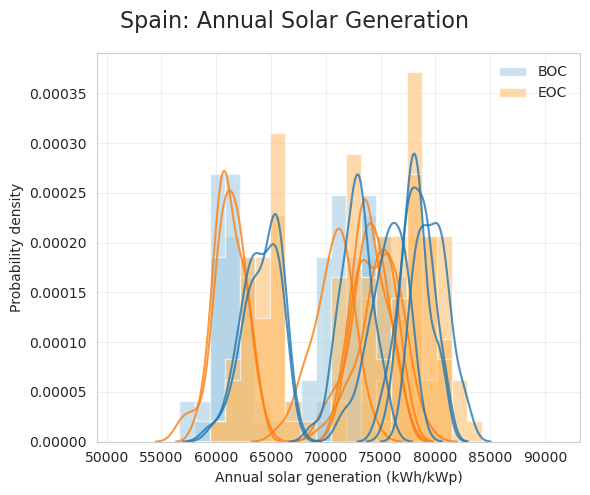

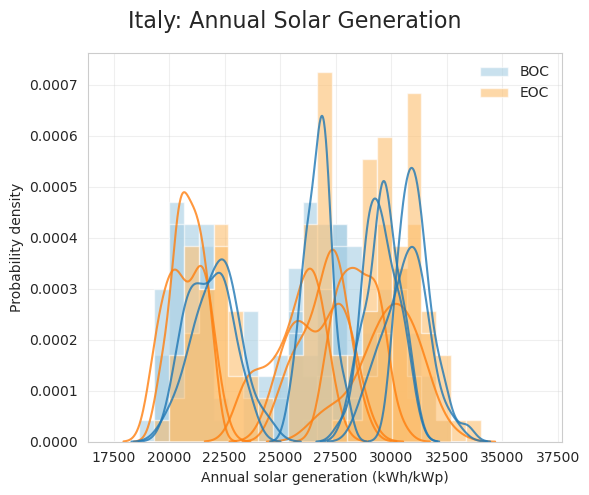

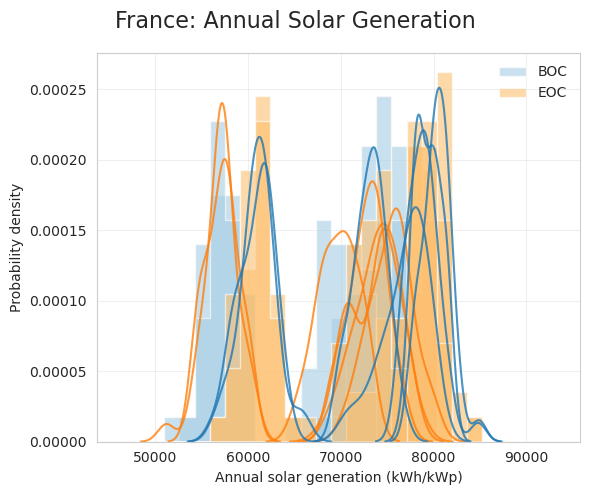

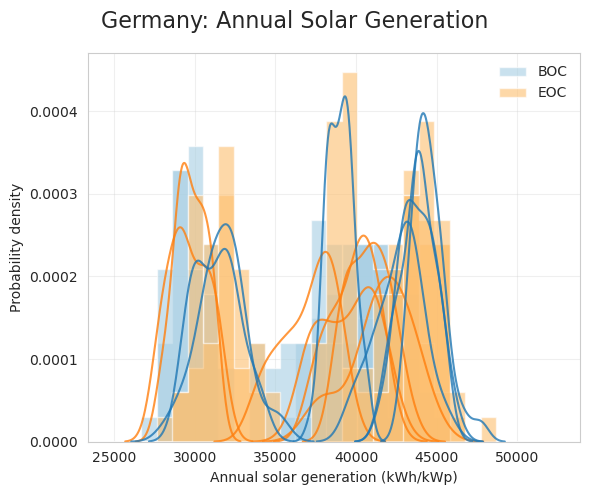

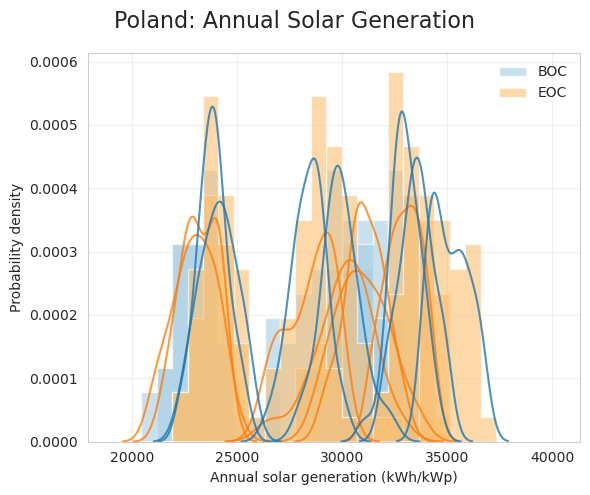

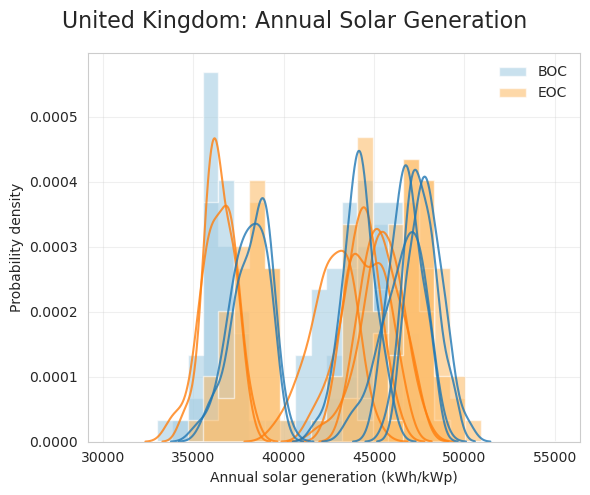

In [24]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pycountry
import numpy as np

# 1) load the full yearly country‐level CSV
df = pd.read_csv("country_level_yearly_solar_power.csv")
df = df.rename(columns={"ADM0_A3":"ISO3","specific generation":"power"})

# build ISO3→ISO2 map
iso2_to_iso3 = {c.alpha_2:c.alpha_3 for c in pycountry.countries}
iso3_to_iso2 = {v:k for k,v in iso2_to_iso3.items()}
df["ISO_A2"] = df["ISO3"].map(iso3_to_iso2)

# 2) pick your six and map to names
selected_iso2 = ["ES","IT","FR","DE","PL","GB"]
df = df[df.ISO_A2.isin(selected_iso2)].copy()
iso2_to_name = {c.alpha_2:c.name for c in pycountry.countries}
iso2_to_name["GB"] = "United Kingdom"

boc_hist = "#a6cee3"   # soft light blue
eoc_hist = "#fdbf6f"   # soft light orange
# Darker colors for KDE lines
boc_line = "#ff7f0e"   # dark blue
eoc_line = "#1f77b4"   # dark orange

# 3) loop per country
for iso2 in selected_iso2:
    cname = iso2_to_name[iso2]
    df_ct = df[df.ISO_A2==iso2]

    boc = df_ct[df_ct.period=="historical"]
    eoc = df_ct[df_ct.period=="ssp585"]

    # compute common bins
    all_p = pd.concat([boc.power, eoc.power])
    bins = np.linspace(all_p.min()*0.9, all_p.max()*1.1, 30)

    fig, ax = plt.subplots(figsize=(6,5))
    fig.suptitle(f"{cname}: Annual Solar Generation", fontsize=16)

    # plot all BOC models in blue
    first = True
    for model in boc.model.unique():
        vals = boc[boc.model==model].power
        ax.hist(vals, bins=bins, density=True, histtype="stepfilled",
                color=boc_hist, lw=1, alpha=0.6,
                label="BOC" if first else None)
        sns.kdeplot(vals, ax=ax, color=boc_line, lw=1.5, alpha=0.8)
        first = False

    # plot all EOC models in orange
    first = True
    for model in eoc.model.unique():
        vals = eoc[eoc.model==model].power
        ax.hist(vals, bins=bins, density=True, histtype="stepfilled",
                color=eoc_hist, lw=1, alpha=0.6,
                label="EOC" if first else None)
        sns.kdeplot(vals, ax=ax, color=eoc_line, lw=1.5, alpha=0.8)
        first = False

    ax.set_xlabel("Annual solar generation (kWh/kWp)")
    ax.set_ylabel("Probability density")
    ax.grid(alpha=0.3)

    # single legend
    ax.legend(loc="upper right", frameon=False)

    plt.tight_layout()
    plt.show()


/tmp/ipykernel_25953/2014933054.py:35: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  vals = df_ct[boc.model == model].median_BOC


IndexingError: Unalignable boolean Series provided as indexer (index of the boolean Series and of the indexed object do not match).

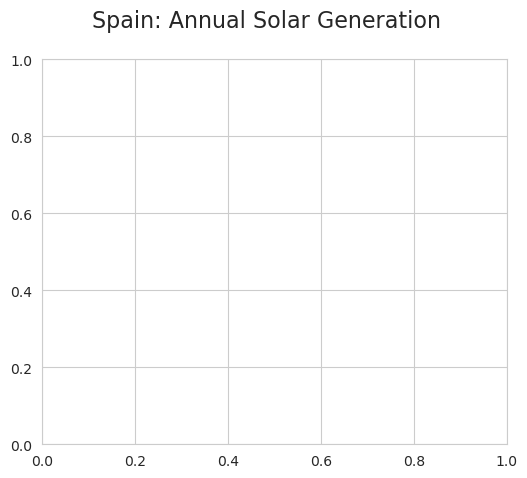

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pycountry
import numpy as np

# 1) load the full yearly country‐level CSV and rename columns
df = pd.read_csv("solar_country_model_stats.csv")


# 2) pick your six and map to full names
selected_iso2 = ["ES", "IT", "FR", "DE", "PL", "GB"]
df = df[df.ISO_A2.isin(selected_iso2)].copy()
iso2_to_name = {c.alpha_2: c.name for c in pycountry.countries}
iso2_to_name["GB"] = "United Kingdom"

# Define colors:
boc_hist = "#a6cee3"   # soft light blue for BOC histogram fill
eoc_hist = "#fdbf6f"   # soft light orange for EOC histogram fill
boc_line = "#ff7f0e"   # dark blue for BOC KDE line
eoc_line = "#1f77b4"   # dark orange for EOC KDE line

# 3) Loop per country
for iso2 in selected_iso2:
    cname = iso2_to_name[iso2]
    df_ct = df[df.ISO_A2 == iso2]
    bins = np.linspace(min(df_ct.median_BOC.min(), df_ct.median_EOC.min()) * 0.9, max(df_ct.median_BOC.max(), df_ct.median_EOC.max()) * 1.1, 30)

    fig, ax = plt.subplots(figsize=(6, 5))
    fig.suptitle(f"{cname}: Annual Solar Generation", fontsize=16)

    # Plot BOC histograms and KDE for each model
    first = True
    for model in boc.model.unique():
        vals = df_ct[boc.model == model].median_BOC
        ax.hist(vals, bins=bins, density=True, histtype="stepfilled",
                color=boc_hist, lw=1, alpha=0.6,
                label="BOC" if first else None)
        sns.kdeplot(vals, ax=ax, color=boc_line, lw=1.5, alpha=0.8)
        first = False

    # Plot EOC histograms and KDE for each model
    first = True
    for model in eoc.model.unique():
        vals = df_ct[boc.model == model].median_EOC
        ax.hist(vals, bins=bins, density=True, histtype="stepfilled",
                color=eoc_hist, lw=1, alpha=0.6,
                label="EOC" if first else None)
        sns.kdeplot(vals, ax=ax, color=eoc_line, lw=1.5, alpha=0.8)
        first = False

    # Compute interannual variability (σ_year) for BOC and EOC:
    # For each model, compute the std across years, then average over models.
    boc_sigma = np.mean(boc.groupby("model")["median_BOC"].std())
    eoc_sigma = np.mean(eoc.groupby("model")["median_EOC"].std())

    # Compute intermodel variability at EOC:
    # For each model, take the median value, then compute std across models.
    eoc_model_medians = eoc.groupby("model")["median_EOC"].median()
    intermodel_eoc = eoc_model_medians.std()

    # Create a multiline annotation text
    stats_text = (
        f"BOC σ_year: {boc_sigma:.2f}\n"
        f"EOC σ_year: {eoc_sigma:.2f}\n"
        f"Intermodel EOC var: {intermodel_eoc:.2f}"
    )
    ax.text(0.97, 0.97, stats_text, transform=ax.transAxes, 
            verticalalignment='top', horizontalalignment='right',
            bbox=dict(boxstyle="round,pad=0.4", fc="white", alpha=0.5))

    ax.set_xlabel("Annual solar generation (kWh/kWp)")
    ax.set_ylabel("Probability density")
    ax.grid(alpha=0.3)

    # Single legend (only once per period if available)
    ax.legend(loc="upper right", frameon=False)

    plt.tight_layout()
    plt.show()